#### I. EDA

Проведем предварительный анализ данных. Посмотрим на типы переменных, пропуски, распределения, зависимости и попробуем преобразовать наблюдения с целью получения максимально возможной точности модели.

In [1]:
# Импорт библиотек и настройка параметров
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import train_test_split
import seaborn as sns
import warnings
import folium
import missingno as msno
from typing import Iterable
from sklearn.base import BaseEstimator, TransformerMixin
import statsmodels.api as sm
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
pd.set_option('display.float_format', '{:.0f}'.format)
pd.set_option("display.max_rows", 70)
pd.set_option('display.precision', 6)
warnings.filterwarnings('ignore')
%config InlineBackend.figure_format = 'retina'
sns.set(style='darkgrid', palette='deep')
plt.rcParams['figure.figsize'] = 12, 6
plt.rcParams['font.size'] = 12
plt.rcParams['savefig.format'] = 'pdf'

Загрузим обучающую выборку, посмотрим подробнее на наши данные и познакомимся с независимыми переменными. 

In [2]:
data = pd.read_csv("tr_for_students.csv")
data

,issue_d,purpose,addr_state,sub_grade,home_ownership,emp_title,installment,dti,funded_amnt,annual_inc,...,mths_since_recent_inq,delinq_2yrs,chargeoff_within_12_mths,num_accts_ever_120_pd,num_tl_90g_dpd_24m,acc_open_past_24mths,avg_cur_bal,tot_hi_cred_lim,delinq_amnt,def
0,2012-01-01,debt_consolidation,IL,C3,RENT,Chicago Shakespeare Theatre,172.48,16.39,5000,21600.0,...,NaN,0,0,NaN,NaN,NaN,NaN,NaN,0,0
1,2013-01-01,debt_consolidation,FL,B4,MORTGAGE,Queen of Pawns,674.94,16.31,20000,95000.0,...,4.0,0,0,0.0,0.0,4.0,23735.0,153379.0,0,0
2,2013-07-01,debt_consolidation,NJ,B5,RENT,tek services,809.24,14.01,24000,90000.0,...,19.0,0,0,0.0,0.0,5.0,4070.0,50834.0,0,0
3,2014-03-01,debt_consolidation,MI,C2,MORTGAGE,Inventory Control,342.56,14.51,10000,43000.0,...,5.0,1,1,4.0,1.0,3.0,1127.0,32683.0,0,0
4,2013-10-01,credit_card,TX,D2,MORTGAGE,Business Analyst,473.58,22.65,13000,62000.0,...,5.0,0,0,0.0,0.0,5.0,3443.0,59495.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61164,2013-02-01,debt_consolidation,CA,A5,RENT,Cupertino Union School District,583.47,7.96,18375,133325.0,...,NaN,1,0,1.0,1.0,1.0,5278.0,48557.0,0,0
61165,2013-07-01,debt_consolidation,TX,A5,MORTGAGE,Los Fresnos CISD,341.72,20.97,16500,82000.0,...,1.0,0,0,0.0,0.0,3.0,18594.0,333493.0,0,0
61166,2013-04-01,debt_consolidation,FL,D1,RENT,Publix,245.06,33.65,6800,27000.0,...,5.0,0,0,1.0,0.0,5.0,2093.0,36095.0,0,0
61167,2010-10-01,debt_consolidation,TX,B5,MORTGAGE,us postal,107.73,18.48,3250,58000.0,...,NaN,0,0,NaN,NaN,NaN,NaN,NaN,0,0


Кратко опишем смысл столбцов:

1. **issue_d** — Дата финансирования заема.
2. **purpose** — Категория, указанная заемщиком для цели получения займа.
3. **addr_state** — Штат, указанный заемщиком в заявке на заем.
4. **sub_grade** — Назначенный внешним источником подкласс кредита.
5. **home_ownership** — Статус владения жильем, указанный заемщиком при регистрации или полученный из кредитного отчета. Возможные значения: RENT (аренда), OWN (собственное жилье), MORTGAGE (ипотека), OTHER (другое).
6. **emp_title** — Должность, указанная заемщиком при подаче заявки.
7. **installment** — Ежемесячный платеж, подлежащий уплате заемщиком при выдаче кредита.
8. **dti** — Коэффициент долговой нагрузки: отношение всех ежемесячных долговых платежей заемщика (кроме ипотеки и текущего займа) к его ежемесячному доходу.
9. **funded_amnt** — Общая сумма, выделенная на данный заем на текущий момент.
10. **annual_inc** — Годовой доход, указанный заемщиком при регистрации.
11. **emp_length** — Стаж работы в годах. Возможные значения: от 0 (менее одного года) до 10 (десять и более лет).
12. **term** — Срок кредита в месяцах: 36 или 60.
13. **inq_last_6mths** — Количество запросов в кредитную историю за последние 6 месяцев (исключая автокредиты и ипотеку).
14. **mths_since_recent_inq** — Количество месяцев с момента последнего запроса в кредитную историю.
15. **delinq_2yrs** — Количество просрочек более 30 дней за последние 2 года.
16. **chargeoff_within_12_mths** — Количество списаний задолженности за последние 12 месяцев.
17. **num_accts_ever_120_pd** — Количество счетов с просрочкой 120 дней и более за всё время.
18. **num_tl_90g_dpd_24m** — Количество счетов с просрочкой 90 дней и более за последние 24 месяца.
19. **acc_open_past_24mths** — Количество новых счетов, открытых за последние 24 месяца.
20. **avg_cur_bal** — Средний текущий баланс по всем счетам.
21. **tot_hi_cred_lim** — Совокупный лимит по всем счетам/максимальная задолженность.
22. **delinq_amnt** — Сумма просроченной задолженности по счетам, находящимся в состоянии просрочки.


Независимые переменные имеют следующие типы данных:

In [3]:
data.dtypes

issue_d                      object
purpose                      object
addr_state                   object
sub_grade                    object
home_ownership               object
emp_title                    object
installment                 float64
dti                         float64
funded_amnt                   int64
annual_inc                  float64
emp_length                  float64
term                          int64
inq_last_6mths                int64
mths_since_recent_inq       float64
delinq_2yrs                   int64
chargeoff_within_12_mths      int64
num_accts_ever_120_pd       float64
num_tl_90g_dpd_24m          float64
acc_open_past_24mths        float64
avg_cur_bal                 float64
tot_hi_cred_lim             float64
delinq_amnt                   int64
def                           int64
dtype: object

Изучив смысл независимых переменных, можно приступить к предварительному анализу данных.

#### 1. Пропуски.

Перед тем, как строить графики распределений и зависимостей, следует обратить внимание на пропуски в данных. Посмотрим, каких значений не хватает. Воспользуемся библиотекой missingno. Построим гистограмму и матрицу пропущенных значений каждого столбца.

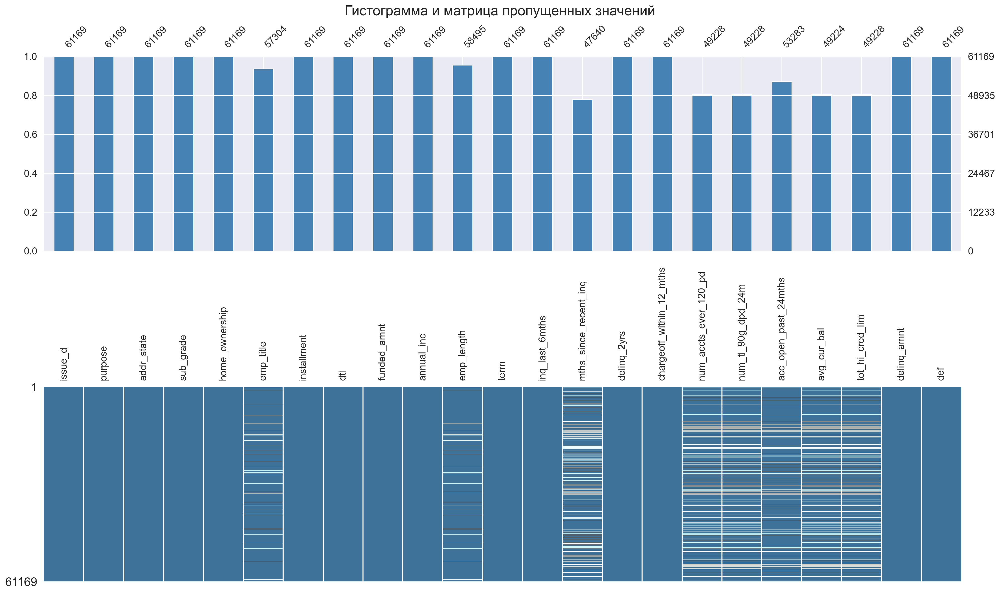

In [4]:
fig, axes = plt.subplots(2, 1, figsize=(20, 12))
plt.suptitle("Гистограмма и матрица пропущенных значений", fontsize=20)

msno.bar(
    data,
    ax=axes[0],
    color="steelblue",
    fontsize=14,
    labels=True,
)
axes[0].tick_params(axis='x', which='both', bottom=False, labelbottom=False) 

msno.matrix(
    data,
    ax=axes[1],
    color=(0.25, 0.45, 0.6),
    fontsize=14,
)
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90, ha='center')
plt.tight_layout()


Исходя из графиков, всего имеем восемь независимых переменных с пропущенными значениями.

1. emp_title ~ 5% пропусков
2. emp_length ~ 5% пропусков
3. mths_since_recent_inq ~ 20% пропусков
4. num_accts_ever_120_pd ~ 20% пропусков
5. num_tl_90g_dpd_24m ~ 20% пропусков
6. acc_open_past_24mths ~ 15% пропусков
7. avg_cur_bal ~ 20% пропусков
8. tot_hi_cred_lim ~ 20% пропусков

Распределение пропущенных значений случайно, но только внутри столбцов. Посмотрим на корреляционную матрицу пропущенных значений, чтобы увидеть зависимость пропусков по столбцам.

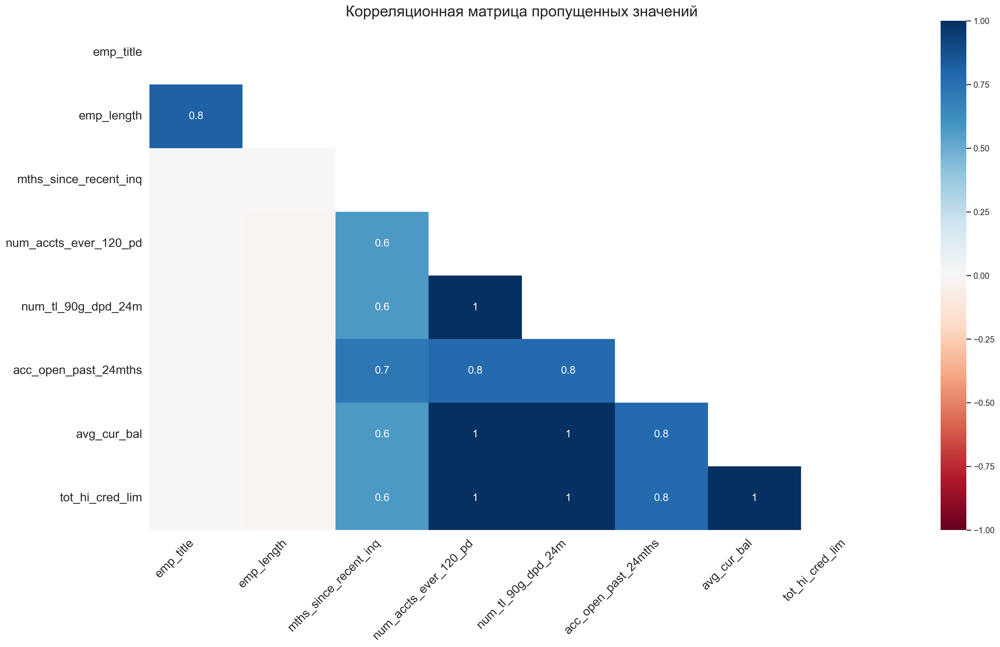

In [5]:
msno.heatmap(data)
plt.title("Корреляционная матрица пропущенных значений", fontsize=20)
plt.tight_layout()

Похоже, что у нас есть две группы взаимосвязанных пропусков - работа и счета. Между собой группы не коррелируют, а вот внутри очень даже. Попробуем отклассифицировать пропуски и понять, как их обработать. 

Классификация пропусков:

1. Missing Completely At Random (MCAR);

Факт пропуска в принципе не зависит от содержания данных.

2. Missing At Random (MAR);

Факт пропуска может зависеть от содержания записи, но только от наблюдаемых значений, а не от пропущенных.

3. Missing Not At Random (MNAR);

Факт пропуска зависит от пропущенных данных.

Проверим наши пропуски с помощью библиотеки pyampute. В ней реализован класс MCARTest. Как это работает?

$$H_0: \text{Missing Completely At Random (MCAR)},$$
$$H_1: \text{Not Missing Completely At Random (MCAR)}$$

Тестовая статистика ~ $\chi^2$


Если $P-value < 0.05 \Rightarrow $ нулевая гипотеза отвергается.

In [6]:
from pyampute.exploration.mcar_statistical_tests import MCARTest

numeric_data = data.select_dtypes(include=["number"])
test = MCARTest(method="little")
p_value = test.little_mcar_test(numeric_data)
print("P-value:", p_value)

P-value: 0.0


Чего и следовало ожидать. Проверим на принадлежность пропусков второму типу и посмотрим, от чего зависят пропуски. Это можно сделать, построив логистическую регрессию пропусков в столбце от наблюдаемых значений других переменных. Если какие-то коэффициенты будут значимы, тогда можно сказать, что пропуски в столбце статистически связаны с данной переменной.

In [7]:
import pandas as pd
import statsmodels.api as sm

def MAR(target_col, data):
    df = data.copy()
    df['missing'] = df[target_col].isna().astype(int)

    predictors = df.drop(columns=[target_col, 'missing']).select_dtypes(include=["number"]).dropna(axis=1)
    X = sm.add_constant(predictors)
    y = df['missing']

    model = sm.Logit(y, X, missing='drop').fit(disp=False)
    return model.pvalues.drop('const', errors='ignore')

pval_matrix = pd.DataFrame()
for col in data.columns[data.isna().any()]:
    pvals = MAR(col, data)
    pval_matrix[col] = pvals

pval_matrix = pval_matrix.round(2)
pval_matrix

,emp_title,emp_length,mths_since_recent_inq,num_accts_ever_120_pd,num_tl_90g_dpd_24m,acc_open_past_24mths,avg_cur_bal,tot_hi_cred_lim
installment,0.42,0.01,0.00,0.00,0.00,0.00,0.00,0.00
dti,0.00,0.13,0.00,0.00,0.00,0.00,0.00,0.00
funded_amnt,0.44,0.00,0.00,0.00,0.00,0.00,0.00,0.00
annual_inc,0.00,0.00,0.00,0.00,0.00,0.31,0.00,0.00
term,0.00,0.00,0.22,0.16,0.16,0.00,0.15,0.16
inq_last_6mths,0.26,0.01,0.00,0.00,0.00,0.00,0.00,0.00
delinq_2yrs,0.02,0.56,0.00,0.00,0.00,0.00,0.00,0.00
chargeoff_within_12_mths,0.20,0.73,0.00,0.99,0.99,0.99,0.67,0.99
delinq_amnt,0.50,0.66,0.24,0.99,0.99,0.99,0.99,0.99
def,0.00,0.00,0.00,0.00,0.00,0.79,0.00,0.00


Мы составили матрицу P-value значимости коэффициентов. Столбцы - зависимые переменные, индексы - независимые.

Из таблицы видно, что в каждом столбце есть значимые коэффициенты. Можно точно подтвердить, что пропуски либо MAR, либо MNAR.

Например, рассмотрим столбец emp_title:
Значимые коэффициенты при переменных dti, annual_inc, term, delinq_2yrs, def.
Зависимости кажутся логичными. Если человек не работает, то это напрямую влияет на DTI, годовой доход, срок кредита, количество просрочек и дефолт.

Но что делать с пропусками? Если данные не MCAR, это обычно приводит к ошибкам в оценках. 


Для emp_title присвоим вместо пропуска значение no_job. Также создадим бинарный столбец is_employed, означающий трудоустройство на данный момент. А пропуски в признаке emp_length заполним модой - наиболее часто встречающимся значением.

In [8]:
data['emp_title'] = data['emp_title'].fillna('no_job')
data['emp_length'] = data['emp_length'].fillna(data['emp_length'].mode()[0])

data['is_employed'] = (data['emp_title'] != 'no_job').astype(int)
data[data['is_employed'] == 0]

,issue_d,purpose,addr_state,sub_grade,home_ownership,emp_title,installment,dti,funded_amnt,annual_inc,...,delinq_2yrs,chargeoff_within_12_mths,num_accts_ever_120_pd,num_tl_90g_dpd_24m,acc_open_past_24mths,avg_cur_bal,tot_hi_cred_lim,delinq_amnt,def,is_employed
28,2013-06-01,debt_consolidation,OH,B3,MORTGAGE,no_job,299.45,30.67,9000,75000.0,...,0,0,0.0,0.0,7.0,21314.0,274302.0,0,0,0
68,2014-03-01,credit_card,CA,C5,RENT,no_job,349.65,32.46,10000,46728.0,...,0,0,0.0,0.0,2.0,2647.0,65307.0,0,0,0
88,2014-02-01,debt_consolidation,IL,D4,MORTGAGE,no_job,355.18,27.16,9700,27000.0,...,0,0,0.0,0.0,7.0,6445.0,120539.0,0,0,0
102,2010-10-01,debt_consolidation,NY,A5,MORTGAGE,no_job,331.49,13.07,10750,67200.0,...,0,0,NaN,NaN,NaN,NaN,NaN,0,0,0
108,2014-05-01,credit_card,AZ,C2,MORTGAGE,no_job,169.32,22.19,5000,54456.0,...,0,0,0.0,0.0,9.0,13860.0,191486.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61072,2014-02-01,debt_consolidation,NC,F2,MORTGAGE,no_job,438.90,12.11,11175,35000.0,...,1,0,0.0,0.0,3.0,21435.0,191536.0,0,0,0
61077,2012-08-01,small_business,TX,C4,OWN,no_job,176.51,25.81,5000,47000.0,...,0,0,NaN,NaN,3.0,NaN,NaN,0,0,0
61118,2013-12-01,debt_consolidation,NC,C1,MORTGAGE,no_job,41.01,4.46,1200,34000.0,...,0,0,4.0,0.0,2.0,832.0,8100.0,0,0,0
61140,2012-10-01,debt_consolidation,IL,A4,MORTGAGE,no_job,469.36,28.14,15000,40800.0,...,0,0,0.0,0.0,4.0,2319.0,85323.0,0,0,0


Также создадим бинарную переменную no_account, означающую отсутствие информации о счете. Если хотя бы в одном столбце, связанном со счетами, есть пропуски, то no_account = 1. 

In [9]:
acc_cols = [
    'mths_since_recent_inq',
    'num_accts_ever_120_pd',
    'num_tl_90g_dpd_24m',
    'acc_open_past_24mths',
    'avg_cur_bal',
    'tot_hi_cred_lim'
]

data['no_account'] = data[acc_cols].isna().any(axis=1).astype(int)
data

,issue_d,purpose,addr_state,sub_grade,home_ownership,emp_title,installment,dti,funded_amnt,annual_inc,...,chargeoff_within_12_mths,num_accts_ever_120_pd,num_tl_90g_dpd_24m,acc_open_past_24mths,avg_cur_bal,tot_hi_cred_lim,delinq_amnt,def,is_employed,no_account
0,2012-01-01,debt_consolidation,IL,C3,RENT,Chicago Shakespeare Theatre,172.48,16.39,5000,21600.0,...,0,NaN,NaN,NaN,NaN,NaN,0,0,1,1
1,2013-01-01,debt_consolidation,FL,B4,MORTGAGE,Queen of Pawns,674.94,16.31,20000,95000.0,...,0,0.0,0.0,4.0,23735.0,153379.0,0,0,1,0
2,2013-07-01,debt_consolidation,NJ,B5,RENT,tek services,809.24,14.01,24000,90000.0,...,0,0.0,0.0,5.0,4070.0,50834.0,0,0,1,0
3,2014-03-01,debt_consolidation,MI,C2,MORTGAGE,Inventory Control,342.56,14.51,10000,43000.0,...,1,4.0,1.0,3.0,1127.0,32683.0,0,0,1,0
4,2013-10-01,credit_card,TX,D2,MORTGAGE,Business Analyst,473.58,22.65,13000,62000.0,...,0,0.0,0.0,5.0,3443.0,59495.0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61164,2013-02-01,debt_consolidation,CA,A5,RENT,Cupertino Union School District,583.47,7.96,18375,133325.0,...,0,1.0,1.0,1.0,5278.0,48557.0,0,0,1,1
61165,2013-07-01,debt_consolidation,TX,A5,MORTGAGE,Los Fresnos CISD,341.72,20.97,16500,82000.0,...,0,0.0,0.0,3.0,18594.0,333493.0,0,0,1,0
61166,2013-04-01,debt_consolidation,FL,D1,RENT,Publix,245.06,33.65,6800,27000.0,...,0,1.0,0.0,5.0,2093.0,36095.0,0,0,1,0
61167,2010-10-01,debt_consolidation,TX,B5,MORTGAGE,us postal,107.73,18.48,3250,58000.0,...,0,NaN,NaN,NaN,NaN,NaN,0,0,1,1


А заполним пропуски более хитрым способом - EM-алогритм поможет восстановить значения. Воспользуемся библиотекой impyute.

In [ ]:
# ChatGPT o4-mini-high - не знаком с синтаксисом библиотеки, ИИ помог быстро разобраться
from impyute.imputation.cs.em import em

np.float = float
original_numeric = numeric_data.copy()
other_numeric = numeric_data.columns 

numeric_cols = data.select_dtypes(include=['number']).columns
numeric_df  = data[other_numeric]

arr = numeric_df.values.astype(float)
imputed_arr = em(arr, loops=100)
imputed_arr = np.where(imputed_arr < 0, 0, imputed_arr)

imputed_numeric_df = pd.DataFrame(imputed_arr, columns=other_numeric, index=data.index)
for col in other_numeric:
    imputed_numeric_df[col] = imputed_numeric_df[col].clip(lower=0).round().astype(int)
    
imputed_numeric_df

,installment,dti,funded_amnt,annual_inc,emp_length,term,inq_last_6mths,mths_since_recent_inq,delinq_2yrs,chargeoff_within_12_mths,num_accts_ever_120_pd,num_tl_90g_dpd_24m,acc_open_past_24mths,avg_cur_bal,tot_hi_cred_lim,delinq_amnt,def
0,172,16,5000,21600,0,36,3,12,0,0,3,0,2,36368,343646,0,0
1,675,16,20000,95000,10,36,1,4,0,0,0,0,4,23735,153379,0,0
2,809,14,24000,90000,3,36,0,19,0,0,0,0,5,4070,50834,0,0
3,343,15,10000,43000,10,36,1,5,1,1,4,1,3,1127,32683,0,0
4,474,23,13000,62000,1,36,3,5,0,0,0,0,5,3443,59495,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61164,583,8,18375,133325,0,36,0,2,1,0,1,1,1,5278,48557,0,0
61165,342,21,16500,82000,9,60,2,1,0,0,0,0,3,18594,333493,0,0
61166,245,34,6800,27000,10,36,1,5,0,0,1,0,5,2093,36095,0,0
61167,108,18,3250,58000,10,36,0,6,0,0,0,0,1,17994,278953,0,0


Проверим результат заполнения пропусков с помощью графического сравнения распределений.

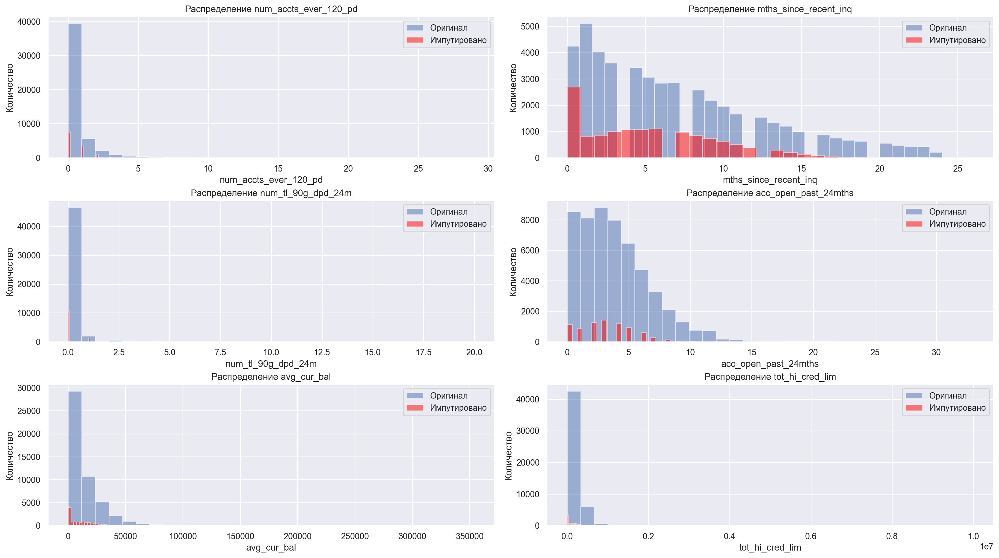

In [18]:
cols = [
    "num_accts_ever_120_pd",
    "mths_since_recent_inq",
    "num_tl_90g_dpd_24m",
    "acc_open_past_24mths",
    "avg_cur_bal",
    "tot_hi_cred_lim"
]

fig, axes = plt.subplots(3, 2, figsize=(18, 10), constrained_layout=True)

for ax, col in zip(axes.flatten(), cols):

    ax.hist(
        original_numeric[col].dropna(),
        bins=30, alpha=0.5, label='Оригинал'
    )

    mask = original_numeric[col].isna()
    ax.hist(
        imputed_numeric_df.loc[mask, col],
        bins=30, alpha=0.5, label='Импутировано', color='red'
    )
    ax.set_title(f'Распределение {col}')
    ax.set_xlabel(col)
    ax.set_ylabel('Количество')
    ax.legend()

plt.show()


Формы распределений оригинальных столбцов и пропущенных действительно схожи. Где-то импутированные значения упускают разброс, где-то падают более плавно, но в целом, вышло неплохо. EM-алогритм - хороший вариант заполнения пропусков для нашей задачи.

Вставим пропущенные значения в основной датасет и зафисиксируем данную часть анализа.

In [20]:
data[other_numeric] = data[other_numeric].fillna(imputed_numeric_df)
data.to_csv("no_nan_train_data.csv")

#### 2. Распределения.

Разобравшись с пропусками, мы можем приступить к следующей части анализа. Посмотрим более подробно на географическое распределение данных, временное. Узнаем количество уникальных значений каждой независимой переменной, построим гистограммы частотности категориальных и числовых признаков и др.

In [210]:
data = pd.read_csv("no_nan_train_data.csv")

Мне кажется важным посмотреть на географическое распределение данных. Жители разных штатов имеют различные культурные особенности. Важно понимать, финальная модель  используется в конкретном регионе или она является обобщенной.

Давайте визуализируем распределение данных на карте. Для этого подсоединим [координаты](https://developers.google.com/public-data/docs/canonical/states_csv) штатов к нашему датасету и воспользуемся библиотекой folium.

In [211]:
states = pd.read_csv("states.csv")
states = states[["state", "latitude", "longitude"]]
states = states.rename(columns={"state": "addr_state", "latitude": "state_latitude", "longitude": "state_longitude"})
states.head()

,addr_state,state_latitude,state_longitude
0,AK,63.588753,-154.493062
1,AL,32.318231,-86.902298
2,AR,35.201050,-91.831833
3,AZ,34.048928,-111.093731
4,CA,36.778261,-119.417932


In [212]:
data = pd.merge(data, states, on="addr_state", how="left")
data.head()

,Unnamed: 0,issue_d,purpose,addr_state,sub_grade,home_ownership,emp_title,installment,dti,funded_amnt,...,num_tl_90g_dpd_24m,acc_open_past_24mths,avg_cur_bal,tot_hi_cred_lim,delinq_amnt,def,is_employed,no_account,state_latitude,state_longitude
0,0,2012-01-01,debt_consolidation,IL,C3,RENT,Chicago Shakespeare Theatre,172.48,16.39,5000,...,0.0,2.0,36368.0,343646.0,0,0,1,1,40.633125,-89.398528
1,1,2013-01-01,debt_consolidation,FL,B4,MORTGAGE,Queen of Pawns,674.94,16.31,20000,...,0.0,4.0,23735.0,153379.0,0,0,1,0,27.664827,-81.515754
2,2,2013-07-01,debt_consolidation,NJ,B5,RENT,tek services,809.24,14.01,24000,...,0.0,5.0,4070.0,50834.0,0,0,1,0,40.058324,-74.405661
3,3,2014-03-01,debt_consolidation,MI,C2,MORTGAGE,Inventory Control,342.56,14.51,10000,...,1.0,3.0,1127.0,32683.0,0,0,1,0,44.314844,-85.602364
4,4,2013-10-01,credit_card,TX,D2,MORTGAGE,Business Analyst,473.58,22.65,13000,...,0.0,5.0,3443.0,59495.0,0,0,1,0,31.968599,-99.901813


In [213]:
def show_clustered_circles_on_map(
    latitude_values: Iterable[float],
    longitude_values: Iterable[float],
    color: str = "blue"
) -> folium.Map:
    coords = pd.DataFrame({
        'lat': latitude_values,
        'lon': longitude_values
    })
    
    grouped = coords.groupby(['lat', 'lon']).size().reset_index(name='count')
    
    location = (coords['lat'].mean(), coords['lon'].mean())
    m = folium.Map(location=location, zoom_start=5)
    
    for _, row in grouped.iterrows():
        folium.Circle(
            radius=50 + row['count'] * 10,
            location=(row['lat'], row['lon']),
            color=color,
            fill_color=color,
            fill=True,
            popup=f"Точек: {row['count']}"
        ).add_to(m)
    
    return m

In [ ]:
show_clustered_circles_on_map(data.state_latitude, data.state_longitude, color="midnightblue")

Почти все штаты представлены в выборке, но не равномерно. Видно большое скопление наблюдений в Калифорнии, Нью-Йорке, Техасе, Флориде. На севере наблюдений совсем немного. Категориальная переменная addr_state может быть не столь полезной в текущем состоянии: слишком много уникальных значений, да еще и редких. Попробуем разделить США географически на десять квадратов и составить новые категории. Напишем класс USMapGridTransformer, который географически разделит границы США на десять квадратов и присвоить отдельному столбцу grid_cell в датасете номер квадрата.

In [ ]:
# ChatGPT 04-mini-high - все плохо с ООП, да и синтаксис folium особо мне не знаком.
from typing import Iterable
from sklearn.base import BaseEstimator, TransformerMixin

class USMapGridTransformer(BaseEstimator, TransformerMixin): 
    def __init__(self, long='state_longitude', lat='state_latitude'): 
        self.rows = 2
        self.columns = 5
        self.long = long
        self.lat = lat
        self.borders = (-125, 25, -66.5, 49)
        self.x_min, self.y_min, self.x_max, self.y_max = self.borders
        self.width = (self.x_max - self.x_min) / self.columns 
        self.height = (self.y_max - self.y_min) / self.rows 
     
    def _get_cell_number(self, lon, lat):
        col = ((lon - self.x_min) / self.width).astype(int) 
        row = ((lat - self.y_min) / self.height).astype(int) 
        mask = (col >= 0) & (col < self.columns) & (row >= 0) & (row < self.rows)
        cell = np.where(mask, row * self.columns + col, -1)
        return cell 
     
    def transform(self, df): 
        df = df.copy()
        df["grid_cell"] = self._get_cell_number(df[self.long], df[self.lat])
        return df 
     
    def show_map(self, latitude_values: Iterable[float], longitude_values: Iterable[float]):
        location = (np.mean(latitude_values), np.mean(longitude_values)) 
        m = folium.Map(location=location, zoom_start=4) 
        
        for i in range(self.rows): 
            for j in range(self.columns): 
                lat_start = self.y_min + i * self.height 
                lon_start = self.x_min + j * self.width 
                lat_end = lat_start + self.height 
                lon_end = lon_start + self.width 
                
                folium.Rectangle( 
                    bounds=[(lat_start, lon_start), (lat_end, lon_end)], 
                    color="red", 
                    weight=1, 
                    fill=False 
                ).add_to(m)
                
                center_lat = (lat_start + lat_end) / 2
                center_lon = (lon_start + lon_end) / 2
                cell_number = i * self.columns + j
                folium.Marker(
                    location=(center_lat, center_lon),
                    popup=f"Ячейка {cell_number}", 
                    tooltip=f"Grid {cell_number}",
                    icon=folium.DivIcon(
                        html=f'<div style="font-size: 12pt; color: black;"><b>{cell_number}</b></div>'
                    )
                ).add_to(m)
        
        for lat, lon in zip(latitude_values, longitude_values): 
            folium.Circle( 
                radius=100, 
                location=(lat, lon), 
                color="blue", 
                fill_color="blue", 
                fill=True 
            ).add_to(m) 
        
        return m


In [ ]:
grid_transformer = USMapGridTransformer(long='state_longitude', lat='state_latitude')
data = grid_transformer.transform(data)

map = grid_transformer.show_map(data['state_latitude'], data['state_longitude'])
map

Скорее всего точки в квадратах все еще распределены неравномерно. Позже посмотрим более внимательно на их распределение на гистограмме.

##### 2.1 Уникальные значения.

Посмотрим на количество уникальных значений категориальных признаков. Их должно быть не слишком много и не слишком мало. Малое количество может привести к ухудшению разделяющей способности модели, так как на самом деле сильно разные категории объединяют в большие группы, упрощая модель. Большое количество уникальных значений приводит к переобучению - редкие категории должны быть объединены.

In [217]:
for col in data.select_dtypes(include=['object', 'category']).columns:
    print("Уникальных значений признака ", col, '-', data[col].nunique())

Уникальных значений признака  issue_d - 50
Уникальных значений признака  purpose - 14
Уникальных значений признака  addr_state - 47
Уникальных значений признака  sub_grade - 35
Уникальных значений признака  home_ownership - 5
Уникальных значений признака  emp_title - 38577


Со штатами разобрались. Поработаем с датой. Тут все просто: скорее всего сама дата не влияет на дефолт, а вот месяц вполне может. Составим два новых отдельных признака month и year. Год мы не можем использовать в качестве независимого признака, так как это приведет к утечке (leakage): неполное наблюдение признака для последних лет, изменение экономических условий во времени, временная корреляция с целевой переменной.

In [218]:
data['issue_d'] = pd.to_datetime(data['issue_d'], errors='coerce')
data['month'] = data['issue_d'].dt.month
data['year'] = data['issue_d'].dt.year
data.head()

,Unnamed: 0,issue_d,purpose,addr_state,sub_grade,home_ownership,emp_title,installment,dti,funded_amnt,...,tot_hi_cred_lim,delinq_amnt,def,is_employed,no_account,state_latitude,state_longitude,grid_cell,month,year
0,0,2012-01-01,debt_consolidation,IL,C3,RENT,Chicago Shakespeare Theatre,172.48,16.39,5000,...,343646.0,0,0,1,1,40.633125,-89.398528,8,1,2012
1,1,2013-01-01,debt_consolidation,FL,B4,MORTGAGE,Queen of Pawns,674.94,16.31,20000,...,153379.0,0,0,1,0,27.664827,-81.515754,3,1,2013
2,2,2013-07-01,debt_consolidation,NJ,B5,RENT,tek services,809.24,14.01,24000,...,50834.0,0,0,1,0,40.058324,-74.405661,9,7,2013
3,3,2014-03-01,debt_consolidation,MI,C2,MORTGAGE,Inventory Control,342.56,14.51,10000,...,32683.0,0,0,1,0,44.314844,-85.602364,8,3,2014
4,4,2013-10-01,credit_card,TX,D2,MORTGAGE,Business Analyst,473.58,22.65,13000,...,59495.0,0,0,1,0,31.968599,-99.901813,2,10,2013


С признаком sub_grade так же все просто: обобщим оценки до A, B, C, D, E, F, G

In [219]:
data.loc[data.sub_grade.str.contains("A"), 'sub_grade'] = 'A'
data.loc[data.sub_grade.str.contains("B"), 'sub_grade'] = 'B'
data.loc[data.sub_grade.str.contains("C"), 'sub_grade'] = 'C'
data.loc[data.sub_grade.str.contains("D"), 'sub_grade'] = 'D'
data.loc[data.sub_grade.str.contains("E"), 'sub_grade'] = 'E'
data.loc[data.sub_grade.str.contains("F"), 'sub_grade'] = 'F'
data.loc[data.sub_grade.str.contains("G"), 'sub_grade'] = 'G'
data.sub_grade.unique()

array(['C', 'B', 'D', 'A', 'F', 'E', 'G'], dtype=object)

Из неудовлетворяющих по количеству уникальных значений остался признак emp_title. Тут все плохо. Профессия наверняка является очень полезным признаком, но 38577 значений говорят об обратном. Нужно как-то объединить профессии по группам. Как это сделать?

Попробуем нестандартный способ - кластеризация. Возможно, KMeans сможет разделить наш столбец на более менее правдоподобные группы.

Сначала проведем векторизацию TF-IDF наших профессий.

In [12]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf = TfidfVectorizer(
    max_features=5000,
    ngram_range=(1,2),
    stop_words='english'
)
X_tfidf = tfidf.fit_transform(data['emp_title'])


Далее подберем оптимальный гиперпараметр - число кластеров - с помощью библиотеки optuna и обучим KMeans из sklearn. В качестве метрики оптимизации будем использовать:

$
   \text{Silhouette Score} \in [0, 1] = \sum_i \frac{b_i - a_i}{\max(a_i, b_i)} \rightarrow max
   $
   - $a_i$ - среднее расстояние до точек внутри своего кластера.
   - $b_i$ - среднее расстояние до точек из ближайшего кластера.
   - Если в своем кластере точки близко - кластер плотный - идеальный вариант: метрика равна единице.
   - Если свой кластер совпадает с соседним - кластеры неразделимы - метрика равна нулю.
   - Чем более однородны и разделимы кластеры, тем лучше.

In [13]:
import optuna
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

def objective(trial):
    n_clusters = trial.suggest_int('n_clusters', 2, 10)
    model = KMeans(n_clusters=n_clusters, random_state=42, n_init='auto')
    labels = model.fit_predict(X_tfidf)
    score = silhouette_score(
        X_tfidf, labels, 
        sample_size=min(10000, X_tfidf.shape[0]), 
        random_state=42
    )
    return score

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=30, show_progress_bar=True)

[I 2025-04-23 21:29:36,880] A new study created in memory with name: no-name-f3743484-2dd6-4ab8-bdc3-68ed3f9a816c
Best trial: 0. Best value: 0.0404957:   3%|▎         | 1/30 [00:04<02:04,  4.28s/it]

[I 2025-04-23 21:29:41,169] Trial 0 finished with value: 0.04049572802291062 and parameters: {'n_clusters': 7}. Best is trial 0 with value: 0.04049572802291062.


Best trial: 1. Best value: 0.104281:   7%|▋         | 2/30 [00:07<01:35,  3.42s/it] 

[I 2025-04-23 21:29:44,021] Trial 1 finished with value: 0.10428052386450229 and parameters: {'n_clusters': 10}. Best is trial 1 with value: 0.10428052386450229.


Best trial: 2. Best value: 0.109977:  10%|█         | 3/30 [00:09<01:20,  2.98s/it]

[I 2025-04-23 21:29:46,462] Trial 2 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  13%|█▎        | 4/30 [00:11<01:09,  2.66s/it]

[I 2025-04-23 21:29:48,594] Trial 3 finished with value: 0.04049572802291062 and parameters: {'n_clusters': 7}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  17%|█▋        | 5/30 [00:13<00:58,  2.36s/it]

[I 2025-04-23 21:29:50,449] Trial 4 finished with value: 0.03929372126465487 and parameters: {'n_clusters': 3}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  20%|██        | 6/30 [00:15<00:54,  2.28s/it]

[I 2025-04-23 21:29:52,595] Trial 5 finished with value: 0.038368297223927664 and parameters: {'n_clusters': 2}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  23%|██▎       | 7/30 [00:17<00:48,  2.12s/it]

[I 2025-04-23 21:29:54,379] Trial 6 finished with value: 0.03929372126465487 and parameters: {'n_clusters': 3}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  27%|██▋       | 8/30 [00:19<00:47,  2.17s/it]

[I 2025-04-23 21:29:56,656] Trial 7 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  30%|███       | 9/30 [00:22<00:46,  2.20s/it]

[I 2025-04-23 21:29:58,908] Trial 8 finished with value: 0.04049572802291062 and parameters: {'n_clusters': 7}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  33%|███▎      | 10/30 [00:24<00:44,  2.20s/it]

[I 2025-04-23 21:30:01,123] Trial 9 finished with value: 0.038368297223927664 and parameters: {'n_clusters': 2}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  37%|███▋      | 11/30 [00:26<00:41,  2.17s/it]

[I 2025-04-23 21:30:03,233] Trial 10 finished with value: 0.10428052386450229 and parameters: {'n_clusters': 10}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  40%|████      | 12/30 [00:28<00:38,  2.16s/it]

[I 2025-04-23 21:30:05,364] Trial 11 finished with value: 0.10057165740768781 and parameters: {'n_clusters': 9}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  43%|████▎     | 13/30 [00:30<00:35,  2.08s/it]

[I 2025-04-23 21:30:07,244] Trial 12 finished with value: 0.037146781585790524 and parameters: {'n_clusters': 5}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  47%|████▋     | 14/30 [00:32<00:33,  2.08s/it]

[I 2025-04-23 21:30:09,344] Trial 13 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  50%|█████     | 15/30 [00:34<00:30,  2.05s/it]

[I 2025-04-23 21:30:11,301] Trial 14 finished with value: 0.037146781585790524 and parameters: {'n_clusters': 5}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  53%|█████▎    | 16/30 [00:36<00:29,  2.08s/it]

[I 2025-04-23 21:30:13,448] Trial 15 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  57%|█████▋    | 17/30 [00:38<00:26,  2.04s/it]

[I 2025-04-23 21:30:15,413] Trial 16 finished with value: 0.10057165740768781 and parameters: {'n_clusters': 9}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  60%|██████    | 18/30 [00:40<00:25,  2.12s/it]

[I 2025-04-23 21:30:17,704] Trial 17 finished with value: 0.039103547877983494 and parameters: {'n_clusters': 6}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  63%|██████▎   | 19/30 [00:42<00:23,  2.09s/it]

[I 2025-04-23 21:30:19,730] Trial 18 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  67%|██████▋   | 20/30 [00:44<00:19,  1.98s/it]

[I 2025-04-23 21:30:21,467] Trial 19 finished with value: 0.039103547877983494 and parameters: {'n_clusters': 6}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  70%|███████   | 21/30 [00:46<00:18,  2.05s/it]

[I 2025-04-23 21:30:23,685] Trial 20 finished with value: 0.10057165740768781 and parameters: {'n_clusters': 9}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  73%|███████▎  | 22/30 [00:48<00:16,  2.00s/it]

[I 2025-04-23 21:30:25,514] Trial 21 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  77%|███████▋  | 23/30 [00:50<00:14,  2.01s/it]

[I 2025-04-23 21:30:27,584] Trial 22 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  80%|████████  | 24/30 [00:52<00:11,  1.98s/it]

[I 2025-04-23 21:30:29,515] Trial 23 finished with value: 0.10057165740768781 and parameters: {'n_clusters': 9}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  83%|████████▎ | 25/30 [00:54<00:10,  2.02s/it]

[I 2025-04-23 21:30:31,622] Trial 24 finished with value: 0.04049572802291062 and parameters: {'n_clusters': 7}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  87%|████████▋ | 26/30 [00:56<00:08,  2.02s/it]

[I 2025-04-23 21:30:33,640] Trial 25 finished with value: 0.037146781585790524 and parameters: {'n_clusters': 5}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  90%|█████████ | 27/30 [00:58<00:05,  1.96s/it]

[I 2025-04-23 21:30:35,451] Trial 26 finished with value: 0.10997656863845484 and parameters: {'n_clusters': 8}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  93%|█████████▎| 28/30 [01:00<00:03,  1.86s/it]

[I 2025-04-23 21:30:37,096] Trial 27 finished with value: 0.10428052386450229 and parameters: {'n_clusters': 10}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977:  97%|█████████▋| 29/30 [01:02<00:01,  1.94s/it]

[I 2025-04-23 21:30:39,205] Trial 28 finished with value: 0.039103547877983494 and parameters: {'n_clusters': 6}. Best is trial 2 with value: 0.10997656863845484.


Best trial: 2. Best value: 0.109977: 100%|██████████| 30/30 [01:04<00:00,  2.15s/it]

[I 2025-04-23 21:30:41,281] Trial 29 finished with value: 0.04049572802291062 and parameters: {'n_clusters': 7}. Best is trial 2 with value: 0.10997656863845484.


In [14]:
best_k = study.best_params['n_clusters']
final_km = KMeans(n_clusters=best_k, random_state=42, n_init='auto').fit(X_tfidf)
data['prof_cluster'] = final_km.labels_

Посмотрим, что у нас получилось. Для этого воспользуемся библиотекой wordcloud и изобразим облака слов полученных кластеров.

In [15]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)

    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

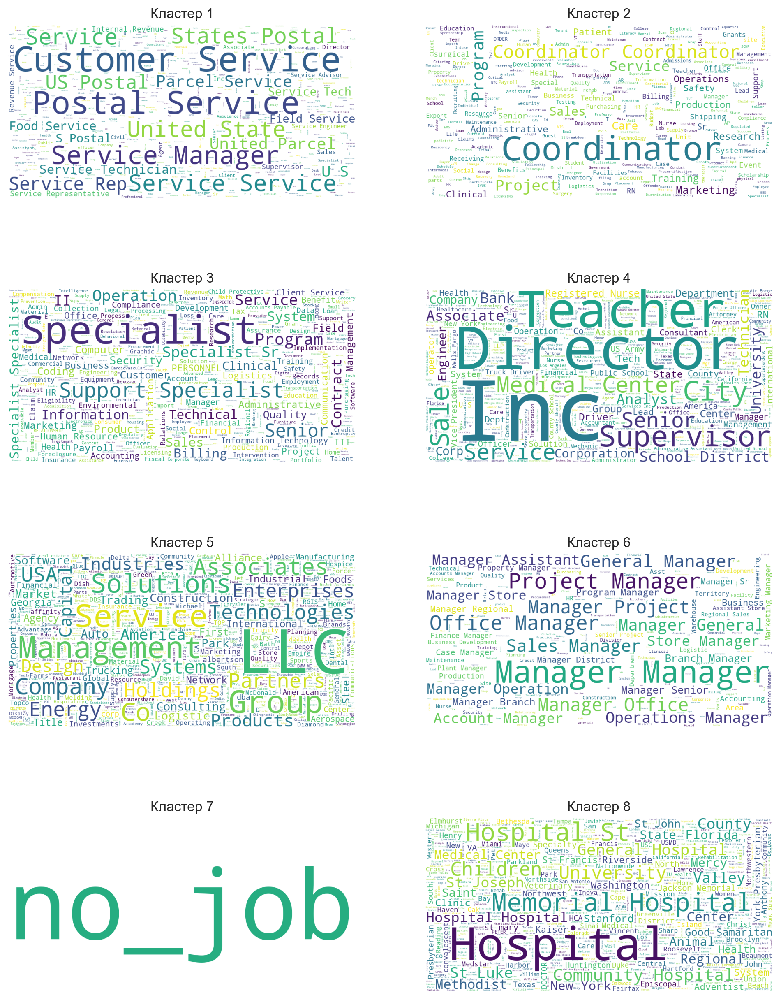

In [16]:
fig, axes = plt.subplots(4, 2, figsize=(12, 16))

for ax, cluster_num in zip(axes.flatten(), range(study.best_params['n_clusters'])):
    cluster_prof = data.loc[data['prof_cluster'] == cluster_num, 'emp_title']
    wc = draw_wordcloud(cluster_prof)
    ax.imshow(wc)
    ax.axis('off')
    ax.set_title(f"Кластер {cluster_num + 1}")
plt.show()

Что-то в этом есть :)

Похоже, что кластеры действительно разделились по темам и статусу:

1. Сервис и услуги;
2. Координаторы и администраторы;
3. Шум;
4. Директоры и начальники, топ-менеджеры;
5. Бизнес;
6. Менеджеры;
7. Нет работы;
8. Докторы.

KMeans разделил профессии на тематические кластеры. Однако третий кластер, объединяющий в себе 70\% данных оказался просто случайным сборником профессий. Такой признак не будет обладать высокой разделяющей способностью. Также я обучал и оптимизировал DBSKAN и спектральную кластеризацию, но данные модели предоставили худший результат. Кластеризация нам не помогла, но есть еще один вариант.

Попробуем использовать чат-бот GigaChat от СБЕРа, чтобы разделить профессии на группы. Для этого напишем промт, обратимся к боту по API и небольшими батчами будем загружать наши профессии, чтобы он сопоставил им тематические группы. 

*Данную часть кода с обращением к GigaChat я запускал в Google Colab, чтобы использовать графический процессор. Поэтому данные ячейки останутся неисполненными.*

In [112]:
def build_prompt(batch):
    return f"""Ниже приведён список профессий. Твоя задача — для **каждой** профессии указать **одну из 10 тематических групп**, к которой она относится.  
    Не группируй профессии — просто создай список соответствий.

    Формат ответа:  
    Профессия — Название группы  
    (используй одну строку на каждую профессию, не добавляй нумерацию, не объясняй, просто выведи результат)

    Вот список профессий:
    {chr(10).join(batch)}
    """

In [ ]:
# ChatGPT o4-mini-high помог мне разобраться как обращаться по API и собрать нужную информацию.
import os
import time
from langchain_community.chat_models.gigachat import GigaChat
from tqdm import tqdm

os.environ["TRANSFORMERS_NO_TF"] = "1"
gigachat_creds = 'Мой API :)'
GPT = GigaChat(
    credentials=gigachat_creds,
    scope="GIGACHAT_API_PERS",
    model="GigaChat",
    streaming=False,
    verify_ssl_certs=False,
)

unique_titles = data["emp_title"].dropna().astype(str).unique().tolist()
batch_size = 100
results_mapping = {}

for i in tqdm(range(0, len(unique_titles), batch_size), desc="Обработка чанков"):
    batch = unique_titles[i:i+batch_size]
    prompt = build_prompt(batch)

    try:
        response = GPT.invoke(prompt).content
    except Exception as e:
        print(f"Ошибка в чанке {i}: {e}")
        continue

    lines = response.strip().split('\n')
    for line in lines:
        if '—' in line:
            title, theme = line.split('—', 1)
            title = title.strip()
            theme = theme.strip()
            results_mapping[title] = theme

    time.sleep(1.5)

Посмотрим, что получилось. Выведем десять случайных строк и оценим правдоподобность.

In [220]:
import json
import re
import string

with open("prof_group_mapping.json", "r", encoding="utf-8") as f:
    raw_mapping = json.load(f)

prof = pd.DataFrame(list(raw_mapping.items()), columns=["emp_title", "prof_group"])

def clean_text(text):
    text = re.sub(r"^\s*\d+\.\s*", "", text)
    text = text.lower()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = re.sub(r"\s+", "", text) 
    return text

prof["clean_title"] = prof["emp_title"].apply(clean_text)
prof = prof.drop_duplicates(subset="clean_title", keep="first")
prof = prof.drop(columns='emp_title')
data["clean_title"] = data["emp_title"].astype(str).apply(clean_text)
data_with_prof = pd.merge(data, prof, on='clean_title', how='left')

In [221]:
print("Всего групп:", data_with_prof.prof_group.nunique())
data_with_prof[['emp_title', 'prof_group']].sample(10)

Всего групп: 3819


,emp_title,prof_group
2258,Logistics Supervisor,Логистика
43164,Borgata Hotel Casino & Spa,Игорный бизнес
53134,Defense Logistics Agency-Aviation,Военная служба
9167,Premera Blue Cross,Страхование
45565,Nurse Practitioner,Медицина и здравоохранение
19790,Memorial Drive Church of Christ,Религия
54576,machinst,Производство
35462,CH2M HILL Inc,Инжиниринг и строительство
23749,Boyd Gaming,развлечения
43584,Procter & Gamble,Производство


Выглядит правдоподобно. Только вот GigaChat выделил слишком много групп - 3819. Обратимся к нему повторно и попробуем объединить группы в 20 больших. Удалим профессии, вспомогательные столбцы и оставим только группы.

In [222]:
with open('prof_groups_v2.json', encoding='utf-8') as f:
    mapping = json.load(f)

inverted_map = {orig: new for new, originals in mapping.items() for orig in originals}
data_with_prof['prof_group_mapped'] = data_with_prof['prof_group'].map(inverted_map).fillna('Other')
data_with_prof.loc[data_with_prof.emp_title == 'no_job', 'prof_group_mapped'] = 'No Job'
data_with_prof = data_with_prof.drop(columns=["emp_title", "clean_title", "prof_group"])

Ясно, что скорее всего есть ошибки в определении сферы профессии. Узнаем позже, окажется ли признак полезным и будет ли обладать хорошей разделяющей способностью.

Мы разобрались с уникальными значениями категориальных признаков и можем перейти к целевой переменной.

In [223]:
data = data_with_prof
data.to_csv("nan_unique.csv")

##### 2.2 Распределение таргета.

Для начала проверим баланс классов целевой переменной.

In [224]:
data = pd.read_csv("nan_unique.csv")

def
0    51407
1     9762
Name: count, dtype: int64

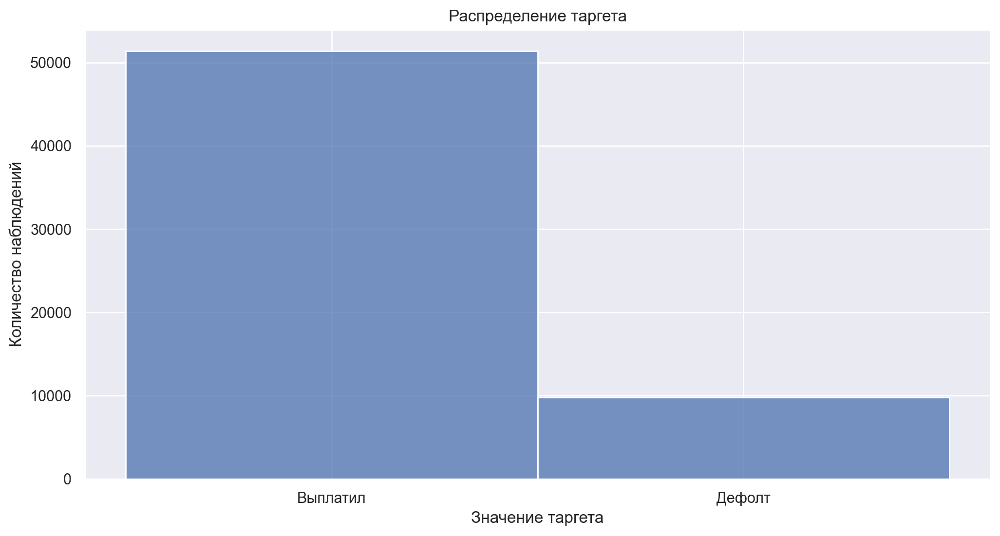

In [225]:
sns.histplot(data=data["def"], discrete=True)
plt.title("Распределение таргета")
plt.xlabel("Значение таргета")
plt.ylabel("Количество наблюдений")
plt.xticks([0, 1], ["Выплатил", "Дефолт"]) 
display(data["def"].value_counts())
plt.show()

В целевой переменной наблюдается дисбаланс классов. В 15% случаев клиенты не справлялись со своими обязательствами. В данном случае дисбаланс является нормальным явлением. Банки не могли бы существовать, если бы в половине случаев наблюдался дефолт.

##### 2.3 Распределение числовых переменных.

Численные признаки с малым количеством уникальных значений я определяю категориальными вместе с признаками типа object - дискретные. Численные столбцы с большим количеством уникальных значений - числовые.

Числовые признаки:

1. `installment`
2. `dti`
3. `funded_amnt`
4. `annual_inc`
5. `delinq_2yrs`
6. `num_accts_ever_120_pd`
7. `acc_open_past_24mths`
8. `avg_cur_bal`
9. `tot_hi_cred_lim`
10. `delinq_amnt`


Построим графики распределений числовых переменных.

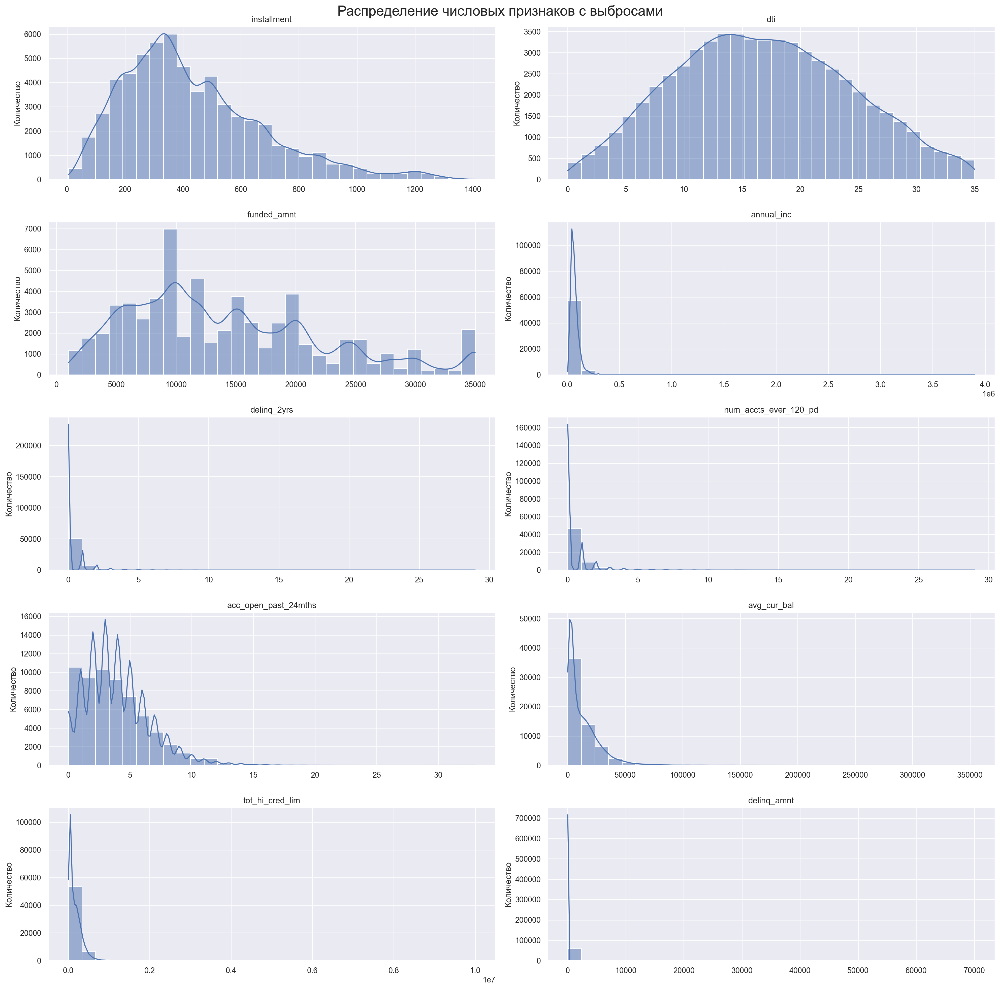

In [226]:
numeric = [
    'installment', 'dti', 'funded_amnt', 'annual_inc',
    'delinq_2yrs', 'num_accts_ever_120_pd', 'acc_open_past_24mths',
    'avg_cur_bal', 'tot_hi_cred_lim', 'delinq_amnt'
]

fig, axes = plt.subplots(5, 2, figsize=(20, 20))
plt.suptitle('Распределение числовых признаков с выбросами', fontsize=20)

for ax, col in zip(axes.flatten(), numeric):
    sns.histplot(data[col], bins=30, kde=True, ax=ax)
    ax.set_title(col)
    ax.set_xlabel("")
    ax.set_ylabel("Количество")

plt.tight_layout()
plt.show()


Многие числовые признаки имеют очень тяжелые хвосты справа. Эти данные нам ничем не помогут - их можно считать выбросами. Отрежем квантили для исключения выбросов и снова построим графики распределений уже без выбросов.

In [227]:
numeric_no_outliers = [
    'annual_inc', 'inq_last_6mths', 'delinq_2yrs',
    'num_accts_ever_120_pd', 'acc_open_past_24mths', 'avg_cur_bal', 'tot_hi_cred_lim', 'delinq_amnt'
]

for col in numeric_no_outliers:
    data = data[data[col] <= data[col].quantile(0.97)]

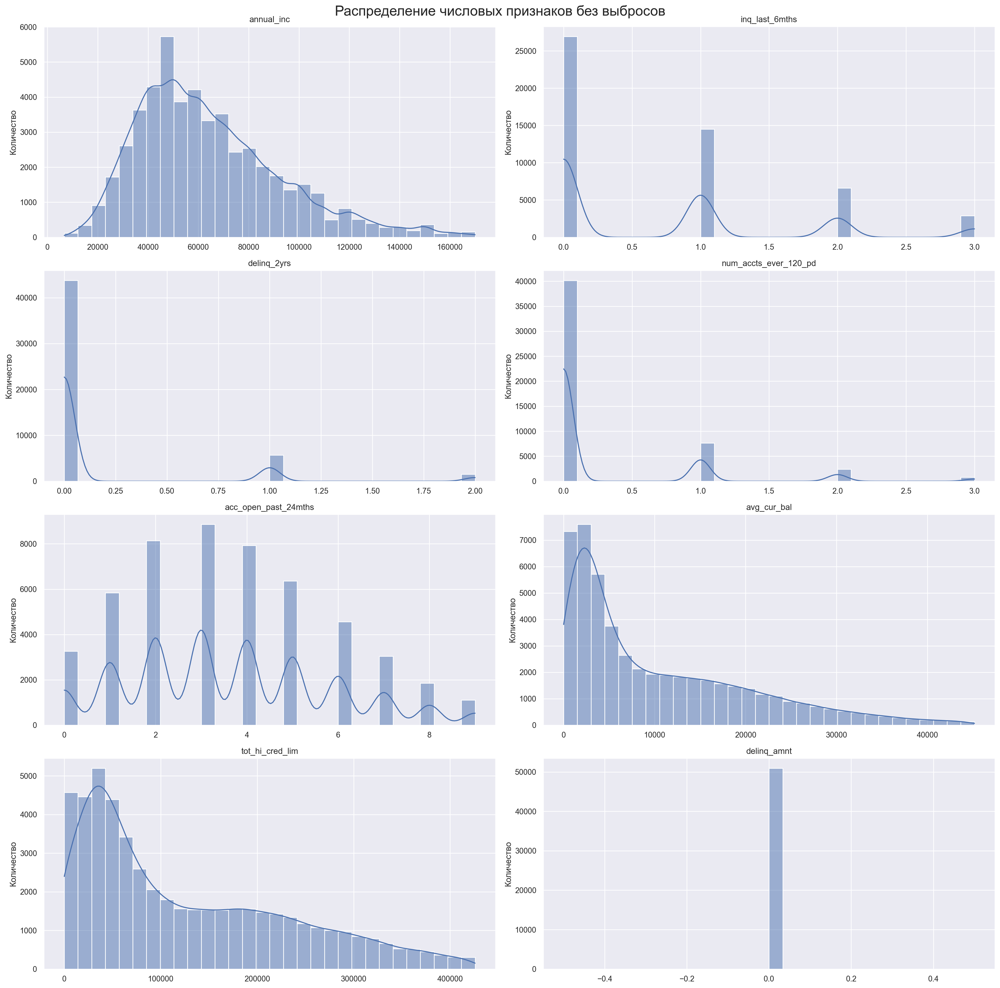

In [228]:
fig, axes = plt.subplots(4, 2, figsize=(20, 20))
plt.suptitle('Распределение числовых признаков без выбросов', fontsize=20)

for ax, col in zip(axes.flatten(), numeric_no_outliers):
    sns.histplot(data[col], bins=30, kde=True, ax=ax)
    ax.set_title(col)
    ax.set_xlabel("")
    ax.set_ylabel("Количество")

plt.tight_layout()
plt.show()

Другое дело! Таким образом, мы избавились от выбросов. Однако я заметил, что признак delinq_amnt очень редко отличается от нуля (всего 130 наблюдений). Такой признак явно не обладает высокой разделяющей способностью, и его следует исключить.

In [229]:
data = data.drop(columns='delinq_amnt')

##### 2.4 Распределение категориальных признаков.

Категориальные признаки:

1. `purpose`
2. `sub_grade`
3. `home_ownership`
4. `emp_length`
5. `term`
6. `inq_last_6mths`
7. `mths_since_recent_inq`
8. `chargeoff_within_12_mths`
9. `num_tl_90g_dpd_24m`
10. `is_employed`
11. `no_account`
12. `grid_cell`
13. `month`
14. `prof_group_mapped`

Построим графики распределений категориальных признаков.

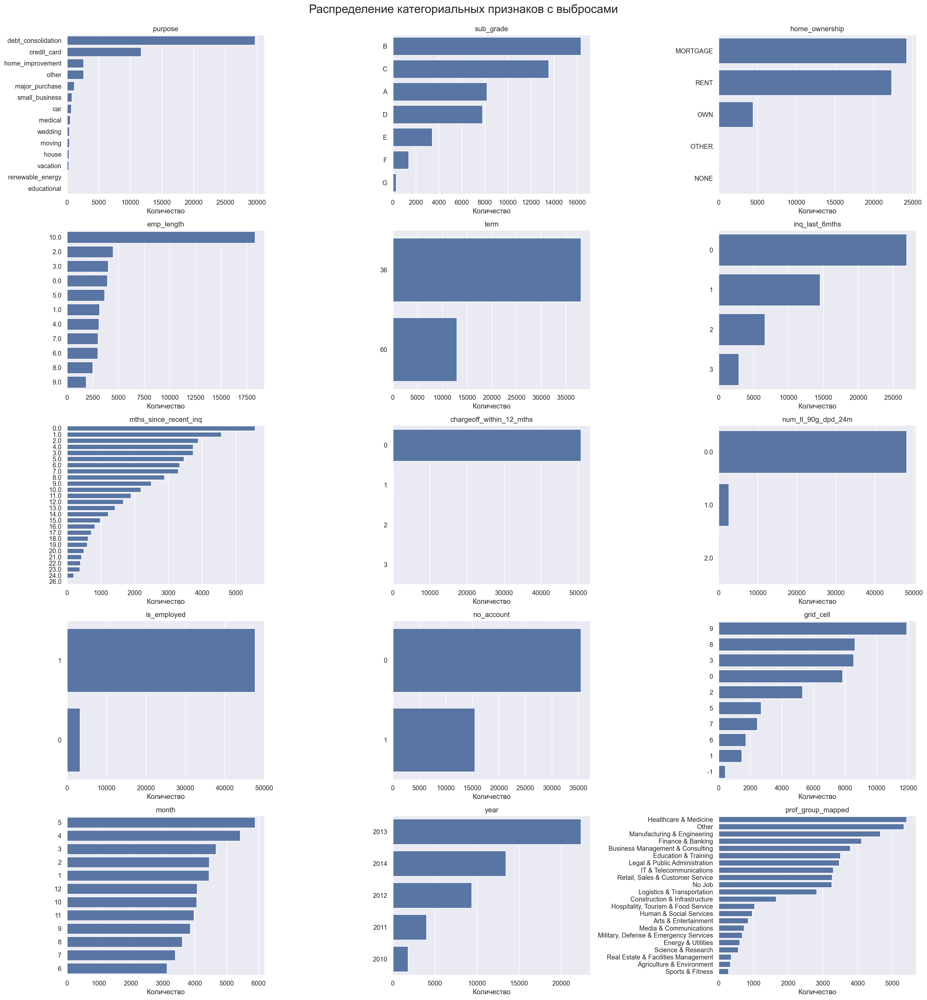

In [230]:
categorical = [
    'purpose', 'sub_grade', 'home_ownership', 'emp_length', 'term',
    'inq_last_6mths', 'mths_since_recent_inq', 'chargeoff_within_12_mths',
    'num_tl_90g_dpd_24m', 'is_employed', 'no_account', 'grid_cell',
    'month', 'year', 'prof_group_mapped'
]

fig, axes = plt.subplots(5, 3, figsize=(22, 24))
plt.suptitle('Распределение категориальных признаков с выбросами', fontsize=20)

for ax, col in zip(axes.flatten(), categorical):
    if col in data.columns:
        sns.countplot(y=data[col], ax=ax, order=data[col].value_counts().index)
        ax.set_title(col)
        ax.set_xlabel("Количество")
        ax.set_ylabel("")

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()


Большинство значений в признаках распределено адекватно. Однако признаки chargeoff_within_12_mths, num_tl_90g_dpd_24m, purpose, home_ownership имеют крайне редкие категории. Для каждого признака объединим их в одну и построим новые графики.

In [231]:
data.loc[data.chargeoff_within_12_mths > 0, 'chargeoff_within_12_mths'] = 1
data.loc[data.num_tl_90g_dpd_24m > 0, 'num_tl_90g_dpd_24m'] = 1
data.loc[(data.purpose == 'renewable_energy') | (data.purpose == 'educational'), 'purpose'] = 'other'
data.loc[(data.home_ownership == 'OTHER') | (data.home_ownership == 'NONE'), 'home_ownership'] = 'OTHER'
data = data[data.mths_since_recent_inq <= 24]

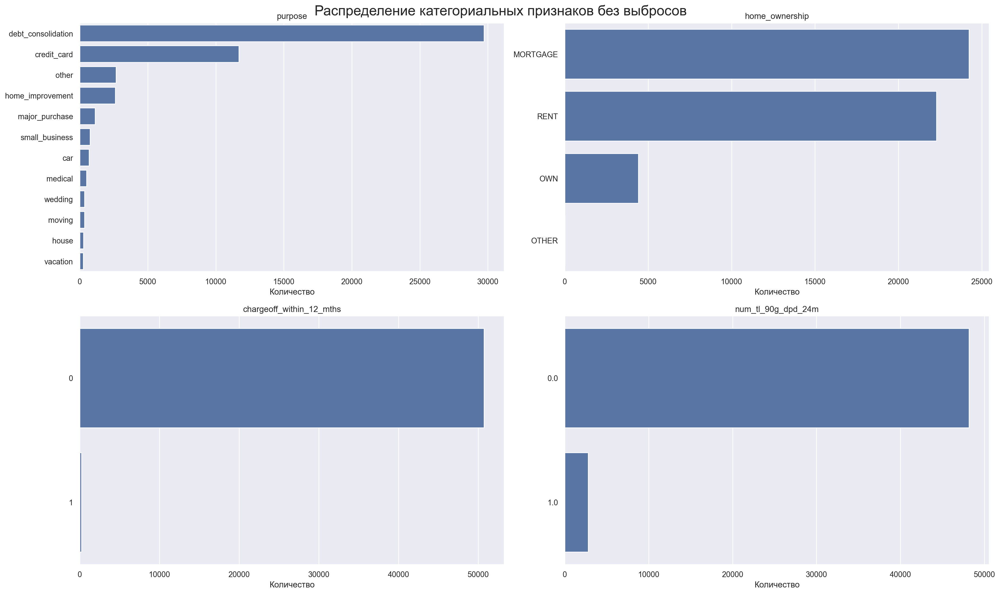

In [232]:
categorical_no_outliers = ['purpose', 'home_ownership', 'chargeoff_within_12_mths', 'num_tl_90g_dpd_24m']

fig, axes = plt.subplots(2, 2, figsize=(20, 12))
plt.suptitle('Распределение категориальных признаков без выбросов', fontsize=20)

for ax, col in zip(axes.flatten(), categorical_no_outliers):
    if col in data.columns:
        sns.countplot(y=data[col], ax=ax, order=data[col].value_counts().index)
        ax.set_title(col)
        ax.set_xlabel("Количество")
        ax.set_ylabel("")

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()


Признак chargeoff_within_12_mths все еще по сути представляет собой одну категорию. Посмотрим на распределение дефолта при ненулевых значениях признака.

In [233]:
data[data.chargeoff_within_12_mths > 0]['def'].value_counts()

def
0    182
1     28
Name: count, dtype: int64

В общем, ничего не меняется. Данный признак бесполезен. Удалим его.

In [234]:
data = data.drop(columns='chargeoff_within_12_mths')

Для признака home_ownership категория OTHER все еще невероятно редкая. Посмотрим на распределение дефолта при OTHER.

In [235]:
data[data.home_ownership == 'OTHER']['def'].value_counts()

def
0    10
1     3
Name: count, dtype: int64

Эти 13 наблюдений можно считать MCAR пропусками. Удалим их и зафиксируем данную часть проекта.

In [236]:
data = data[data.home_ownership != 'OTHER']
data.to_csv("nan_unique_outliers.csv")

#### 3. Зависимости

Построим линейные графики зависимости и гистограммы default rate (доля клиентов, не исполнивших свои обязательства) от наших признаков.

In [5]:
data = pd.read_csv("nan_unique_outliers.csv")

Посмотрим на default rate во времени.

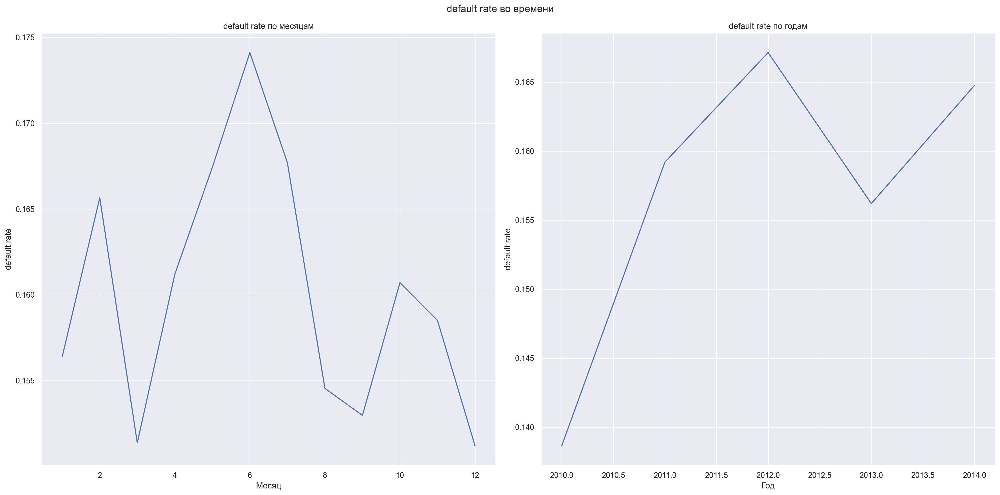

In [6]:
monthly_def = data.groupby('month')['def'].mean()
yearly_def = data.groupby('year')['def'].mean()

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
plt.suptitle("default rate во времени")

sns.lineplot(x=monthly_def.index, y=monthly_def.values, ax=axes[0])
sns.lineplot(x=yearly_def.index, y=yearly_def.values, ax=axes[1])
axes[0].set(xlabel="Месяц", ylabel="default rate", title="default rate по месяцам")
axes[1].set(xlabel="Год", ylabel="default rate", title="default rate по годам")
plt.tight_layout()
plt.show()

Default rate достаточно сильно различается по месяцам. В период с апреля по июль наблюдается повышенный процент клиентов, не исполнивших свои обязательства. По годам различия не такие сильные, но они есть. Обратим внимание на 2010 год. Как мы помним из графика распределения годов в данных, в 2010 году было выдано гораздо меньше кредитов, чем в остальные годы (ясно, что дело в проблеме сбора данных). Я считаю, что наблюдения из 2010 года стоит удалить из данных, так как некорректно сравнивать default rate по столь разным объемам выборок: несмотря на то, что default rate является долей, при меньшем количестве наблюдений появляется проблема случайного отбора. 

Также важно подметить, что наши данные частично совпадают по времени с Мировым экономическим кризисом (2008-2013). С 2007 по 2010 год в США было выдано множество кредитов под низкие процентные ставки с низким обеспечением. Наблюдалась проблема некачественного кредитования. Выдавались так называемые NINJA кредиты без места работы, имущества и тд. 

Последствия ипотечного кризиса распространились дальше 2010 года. Как видно на нашем графике, в 2011 и 2012 годах default rate так же достаточно высокий. 

In [7]:
data = data[data.year != 2010]

Теперь давайте построим графики зависимости default rate от числовых признаков. Для этого разделим числовые признаки на отрезки квантильным бинингом, чтобы в каждый отрезок попало примерно одинаковое количество наблюдений.

In [8]:
numeric = [
    'installment', 'dti', 'funded_amnt', 'annual_inc',
    'delinq_2yrs', 'num_accts_ever_120_pd', 'acc_open_past_24mths',
    'avg_cur_bal', 'tot_hi_cred_lim'
]

binned_data = data.copy()

for col in numeric:
    binned_data[col] = pd.qcut(binned_data[col], q=10, duplicates='drop')

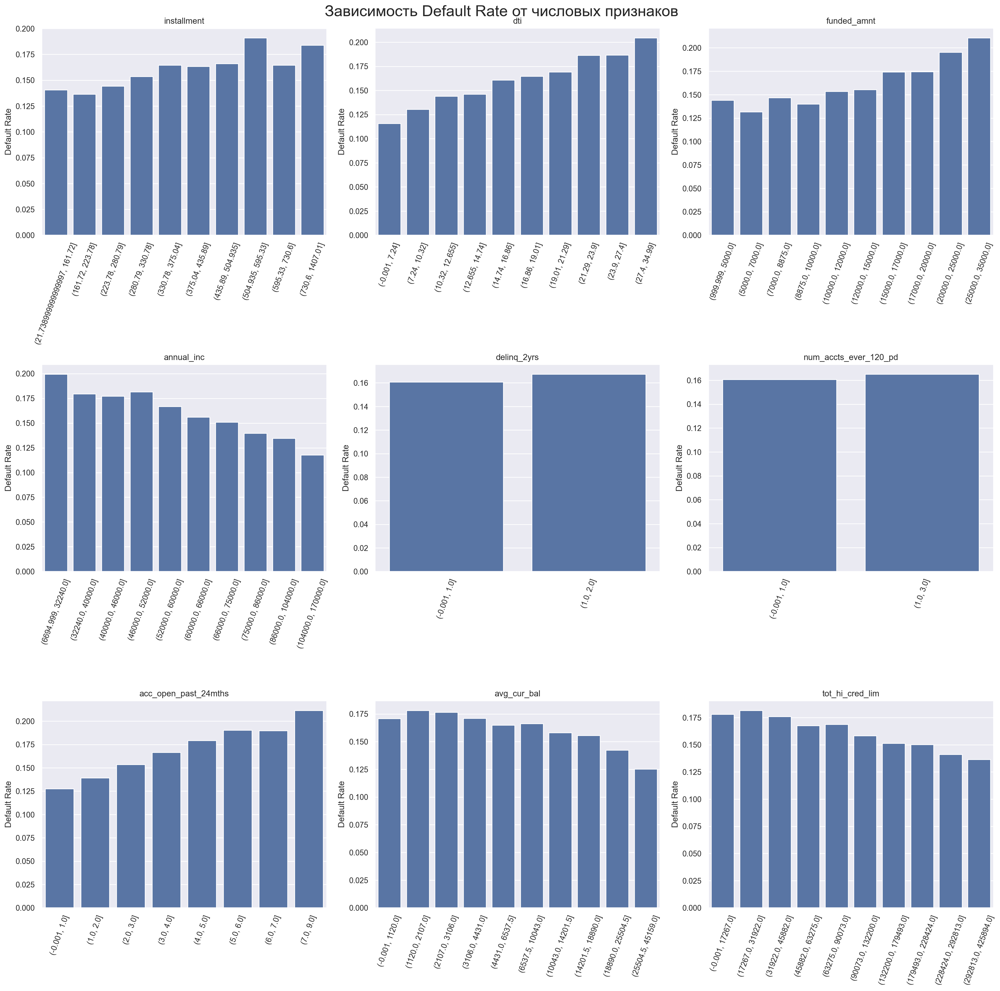

In [9]:
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
plt.suptitle('Зависимость Default Rate от числовых признаков', fontsize=22)

for ax, col in zip(axes.flatten(), numeric):
        dr = binned_data.groupby(col)['def'].mean().reset_index()
        dr['bin_str'] = dr[col].astype(str)

        sns.barplot(data=dr, x='bin_str', y='def', ax=ax)
        ax.set_title(col)
        ax.set_xlabel("")
        ax.set_ylabel("Default Rate")
        ax.tick_params(axis='x', rotation=70)

plt.tight_layout()
plt.show()


У многих признаков наблюдается линейная зависимость. Это знак того, что признаки могут быть полезными для модели. Однако признаки delinq_2yrs и num_accts_ever_120_pd практически не различаются по default rate в зависимости от бинов. Скорее всего эти признаки следует исключить из рассмотрения.

Теперь посмотрим на зависимость default rate от категориальных признаков.

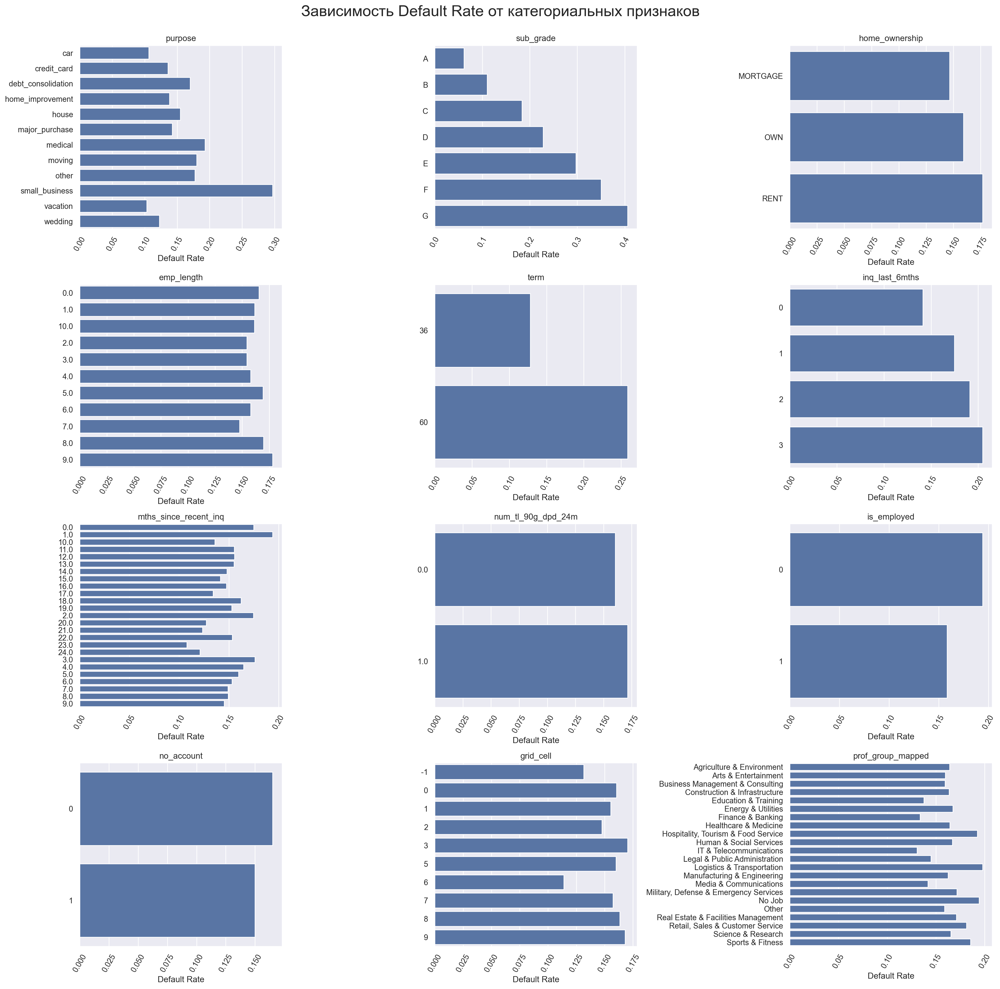

In [10]:
categorical = [
    'purpose', 'sub_grade', 'home_ownership', 'emp_length', 'term',
    'inq_last_6mths', 'mths_since_recent_inq', 'num_tl_90g_dpd_24m',
    'is_employed', 'no_account', 'grid_cell', 'prof_group_mapped'
]

data[categorical] = data[categorical].astype(str)
fig, axes = plt.subplots(4, 3, figsize=(20, 20))
plt.suptitle('Зависимость Default Rate от категориальных признаков', fontsize=22)

for ax, col in zip(axes.flatten(), categorical):
        dr = data.groupby(col)['def'].mean().reset_index()
        sns.barplot(data=dr, x='def', y=col, ax=ax)
        ax.set_title(col)
        ax.set_xlabel("Default Rate")
        ax.set_ylabel("")
        ax.tick_params(axis='x', rotation=60)

plt.tight_layout()
plt.subplots_adjust(top=0.94)
plt.show()


Кажется, большинство признаков так же обладают высокой разделяющей способностью. Наиболее сильными выглядят sub_grade, term, purpose, home_ownership, mths_since_recent_inq и, на удивление, созданные нами признаки grid_cell и prof_group_mapped. Эти признаки должны оказаться весьма полезными. Достаточно слабыми признаками на данный момент выглядят emp_length и no_account.

На этом этап предварительного анализа подошел к концу.

In [11]:
data.to_csv("nan_unique_outliers_depend.csv")

### II. Feature Engineering.

Перейдем к разделу Feature Engineering - попробуем составить новые полезные признаки и посчитаем на описательные статистики независимых переменных.

In [2]:
data = pd.read_csv("nan_unique_outliers_depend.csv")

Во-первых, давайте удалим все вспомогательные столбцы и признаки с очевидно низкой разделяющей способностью, исходя из проведенного исследования в EDA.

In [3]:
data = data[['purpose', 'sub_grade', 'home_ownership', 'installment',
        'dti', 'funded_amnt', 'annual_inc', 'emp_length', 'term', 'delinq_2yrs',
        'inq_last_6mths', 'mths_since_recent_inq', 'num_accts_ever_120_pd',
        'num_tl_90g_dpd_24m', 'acc_open_past_24mths', 'avg_cur_bal', 'tot_hi_cred_lim',
        'def', 'is_employed', 'no_account', 'grid_cell', 'month', 'year', 'prof_group_mapped']]

Из имеющихся данных мне удалось выделить следующие, на мой взгляд, полезные признаки:

1. $\text{LTI} = \frac{\text{funded\_amnt}}{\text{annual\_inc}}$ - Отношение суммы кредита к годовому доходу (Loan-to-Income) - показывает, насколько тяжелым является кредит.

2. $\text{CUP} = \frac{\text{avg\_cur\_bal}}{\text{tot\_hi\_cred\_lim}}$ - Отношение среднего текущего баланса по всем счетам к совокупному лимиту по всем счетам / максимальной задолженности. Остаток долга, деленный на потолок. Показывает уровень краткосрочной ликвидности заемщика: чем выше значение, тем выше риск дефолта, так как при любом доходном или ином шоке клиент пропустит платеж. 

3. $\text{Delay} \;=\;\mathbb{1}\!\left[\bigl(\text{num\_accts\_ever\_120\_pd} > 0\bigr)\;\vee\;\bigl(\text{num\_tl\_90g\_dpd\_24m} > 0\bigr)\;\vee\;\bigl(\text{delinq\_2yrs} > 0\bigr)\right]$ - Жесткий флаг какого-либо вида просрочек.

4. $\text{Activity} = \text{acc\_open\_past\_24mths} + \text{inq\_last\_6mths}$ - Кредитная активность - сколько счетов открыл за последние 2 года и сколько раз делал запросы в БКИ. Индикатор кредитного шоппинга.

5. $\text{IPEY} = \frac{\text{annual\_inc}}{\text{emp\_length}}$ - Оценка карьерного роста. Показатель неквалифицированного работника, нестабильности трудостройства.

In [4]:
data["LTI"] = data.funded_amnt / data.annual_inc
data["CUP"] = data.avg_cur_bal / (data.tot_hi_cred_lim + 1)
data["Activity"] = data.acc_open_past_24mths + data.inq_last_6mths
data["Delay"] = 0
data.loc[(data.num_accts_ever_120_pd > 0) | (data.num_tl_90g_dpd_24m > 0) | (data.delinq_2yrs > 0), 'Delay'] = 1
data["IPEY"] = data.annual_inc / (data.emp_length + 1)

И давайте наконец разделим выборку на независимые переменные и зависимую.

In [5]:
y = data["def"]
x = data.drop(columns="def")

Построим матрицу корреляции и t-статистики признаков с таргетом:

$$t(j) = \frac{|\mu_+ - \mu_-|}{\sqrt{\frac{n_+ \sigma^2_+ + n_- \sigma^2_-}{n_+ + n_-}}},$$

In [6]:
zero = x[(y == 0)]
one = x[y == 1]

t = {}
for col in x.select_dtypes(include=['number']).columns:
    t[col] = np.abs(np.mean(one[col]) - np.mean(zero[col])) / np.sqrt((one.shape[0] * (np.std(one[col])) ** 2 + zero.shape[0] * (np.std(zero[col])) ** 2) / (zero.shape[0] + one.shape[0]))

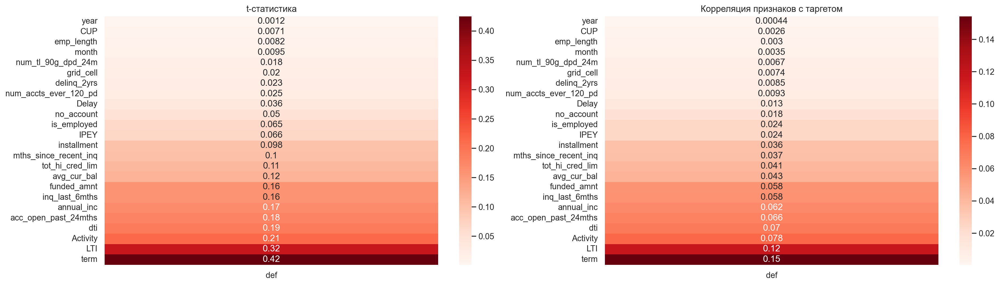

In [7]:
fig, axes = plt.subplots(1, 2, figsize=(22, 6))
sns.heatmap(data=x.select_dtypes(include=['number']).corrwith(y).to_frame("def").abs().sort_values(by="def"), annot=True, cmap="Reds", ax=axes[1])
axes[1].set(title="Корреляция признаков с таргетом")
sns.heatmap(data=pd.Series(t, name="def").to_frame("def").sort_values(by="def"), annot=True, cmap="Reds", ax=axes[0])
axes[0].set(title="t-статистика")
plt.show()

Да, значения описательных статистик достаточно низкие, но это нормально на реальных данных. Распределение дефолта дискретное и несбалансированное. Корреляция оценивает лишь линейный и одномерный эффект. Мы должны получить гораздо больше вклада от взаимодействия независимых признаков.

Осталось проверить независимые признаки на предмет мультиколлинеарности и оставить только уникальные признаки с более высокой корреляцией с таргетом. Для этого рассчитаем VIF.

$$\text{VIF}_j \;=\; \frac{1}{1 - R_j^{2}}$$

где $R_j^{2}$ — коэффициент детерминации при регрессии $x_j$ на все остальные признаки $X_{\neg j}$.


In [8]:
# ChatGPT o4-mini-high - не знал, как можно посчитать VIF удобно.
from statsmodels.stats.outliers_influence import variance_inflation_factor

x_1 = pd.get_dummies(x[list(x.select_dtypes(include=['object', 'category']).columns) + list(x.select_dtypes(include=['number']).columns)], drop_first=True).astype(float)

vif_df = pd.DataFrame({
    'Признак': x_1.columns,
    'VIF':     [variance_inflation_factor(x_1.values, i)
                for i in range(x_1.shape[1])]
})

vif_df = vif_df.sort_values('VIF', ascending=False).reset_index(drop=True)

Если $\text{VIF} \geq 5$, то признак зависим линейно от других.

In [9]:
vif_df[vif_df["VIF"] >= 5]

,Признак,VIF
0,Activity,inf
1,inq_last_6mths,inf
2,acc_open_past_24mths,inf
3,is_employed,11128327
4,prof_group_mapped_No Job,769132
5,funded_amnt,71
6,installment,59
7,purpose_debt_consolidation,20
8,purpose_credit_card,16
9,prof_group_mapped_Healthcare & Medicine,15


Определим, какие именно пары признаков зависят друг от друга с помощью корреляционной матрицы.

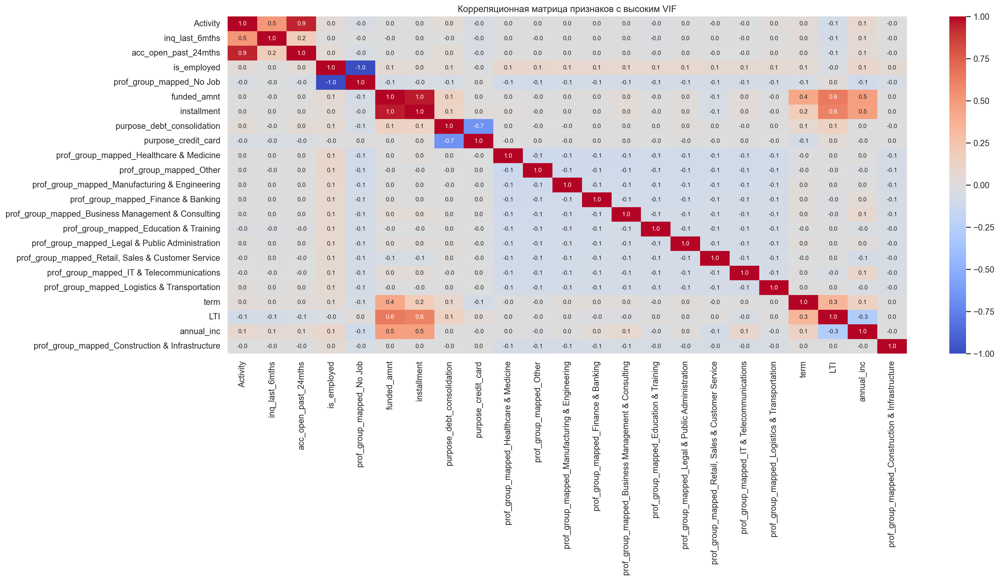

In [10]:
plt.figure(figsize=(20, 8))
sns.heatmap(data=x_1[list(vif_df[vif_df["VIF"] >= 5]["Признак"].unique())].corr(), annot=True, cmap="coolwarm", fmt='.1f', annot_kws={"size": 8})
plt.title("Корреляционная матрица признаков с высоким VIF")
plt.show()

1. Activity коррелирует с acc_open_past_24mths и inq_last_6mths по построению. Оставляем Activity;
2. prof_group_mapped_No Job коррелирует с is_employed - идентичные дамми-переменные. Оставляем prof_group_mapped_No Job, так удобнее;
3. funded_amnt коррелирует с term (больше срок - больше сумма кредита), installment (больше сумма кредита - больше платеж), LTI (по построению) и annuan_inc (больше доход - больше сумма кредита). Удалим funded_amnt, он линейно зависим от многих более важных признаков.
4. installment коррелирует с LTI (по построению) и annual_inc (больше доход - больше платеж). Удалим линейно зависимый признак installment. Все равно он может привести к лику, так как из PD устанавливается ставка и платеж.
5. purpose_debt_consolidation коррелирует с категорией purpose_credit_card. Многие клиенты банков оформляют кредитные карты для погашения других задолженностей. К сожалению, придется объединить эти категории в одну и увеличить дисбаланс в признаке. Однако default_rate все еще будет разрознен относительно категорий.

In [11]:
x = x.drop(columns=['acc_open_past_24mths', 'inq_last_6mths', 'is_employed', 'installment', 'funded_amnt', 'num_accts_ever_120_pd', 'num_tl_90g_dpd_24m', 'delinq_2yrs'])
x.loc[x.purpose == 'credit_card', 'purpose'] = 'debt_consolidation'

### III.  Train / Test split.

Перед тем, как перейти к обучению модели, разделим выборку случайно на train и OOS (out-of-sample). По одной мы будем обучать модель, по другой - оценивать качество.

In [12]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=999)

In [386]:
x_train.to_csv("x_train.csv")
x_test.to_csv("x_test.csv")
y_train.to_csv("y_train.csv")
y_test.to_csv("y_test.csv")

In [3]:
x_train = pd.read_csv("x_train.csv")
x_test = pd.read_csv("x_test.csv")
y_train = pd.read_csv("y_train.csv")
y_test = pd.read_csv("y_test.csv")

Важно понять, что таргет в обеих выборках распределен одинаково, несмотря на то, что мы разделили их случайно.

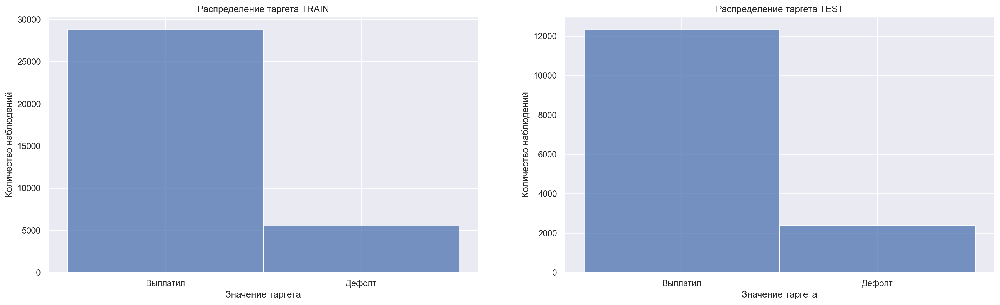

In [13]:
fig, axes = plt.subplots(1, 2, figsize=(22, 6))

sns.histplot(data=y_train, discrete=True, ax=axes[0])
axes[0].set(title="Распределение таргета TRAIN", xlabel="Значение таргета", ylabel="Количество наблюдений")
axes[0].set_xticks([0, 1])
axes[0].set_xticklabels(["Выплатил", "Дефолт"])
sns.histplot(data=y_test, discrete=True, ax=axes[1])
axes[1].set(title="Распределение таргета TEST", xlabel="Значение таргета", ylabel="Количество наблюдений")
axes[1].set_xticks([0, 1])
axes[1].set_xticklabels(["Выплатил", "Дефолт"])
plt.show()

Таргет распределен одинаково для обеих выборок. Можем перейти к обучению.

### IV. Интерпретируемая модель.

Построим логистическую регрессию поверх WOE-преобразований.

#### 1. WOE-преобразование.

$$\text{WOE}_i = \log\left(\frac{\text{GoodRate}_i}{\text{BadRate}_i}\right)$$

где:

* $\text{BadRate}_i = \frac{\text{Количество плохих в бине } i}{\text{Общее количество плохих}}$

* $\text{GoodRate}_i = \frac{\text{Количество хороших в бине } i}{\text{Общее количество хороших}}$

Воспользуемся пакетом wing от СберБанка. К сожалению, данный пакет весьма устарел, поэтому пришлось покапаться в нем и исправить синтаксические ошибки (например, аргумент sparse сейчас отсутствует в OneHotEncoder, заменил на sparse_output).

In [14]:
setattr(np, 'float', float)
from wing import WingsOfEvidence

woe_transformer = WingsOfEvidence(
    columns_to_apply="all",
    bin_minimal_size=0.05,
    bin_size_increase=0.05,
    is_monotone=True,
    optimizer="tree-binning",
    n_initial=20,
    n_target=10,
    tree_random_state=777,
    verbose=True
)

woe_transformer.fit(x_train, y_train)

Working with variable: purpose
Started fit
Data check success,df size: 34395
Got G: 5525 B: 28870
Missing values done, miss woe is {'good': None, 'bad': None, 'total': None, 'woe': None, 'local_event_rate': None},df size: 34395
Spec values done, spec woe is {},df size: 34395
X-vector dtype is object, vector_type will be converted to 'd'
D-values in  clear X: 11
Current vector type: d
Inside vector type 'd'
Discrete woe df created
Working with variable: sub_grade
Started fit
Data check success,df size: 34395
Got G: 5525 B: 28870
Missing values done, miss woe is {'good': None, 'bad': None, 'total': None, 'woe': None, 'local_event_rate': None},df size: 34395
Spec values done, spec woe is {},df size: 34395
X-vector dtype is object, vector_type will be converted to 'd'
D-values in  clear X: 7
Current vector type: d
Inside vector type 'd'
Discrete woe df created
Working with variable: home_ownership
Started fit
Data check success,df size: 34395
Got G: 5525 B: 28870
Missing values done, miss 

WingsOfEvidence(columns_to_apply=Index(['purpose', 'sub_grade', 'home_ownership', 'dti', 'annual_inc',
       'emp_length', 'term', 'mths_since_recent_inq', 'avg_cur_bal',
       'tot_hi_cred_lim', 'no_account', 'grid_cell', 'month', 'year',
       'prof_group_mapped', 'LTI', 'CUP', 'Activity', 'Delay', 'IPEY'],
      dtype='object'),
                is_monotone=True, n_initial=20, n_target=10,
                tree_random_state=777, verbose=True)

Мы обучили трансформер про обучающей выборке. Теперь преобразуем ее и тестовую.

In [15]:
x_train_woe = woe_transformer.transform(x_train)
x_test_woe  = woe_transformer.transform(x_test)

In [390]:
x_train_woe.to_csv("X_train_woe.csv")
x_test_woe.to_csv("X_test_woe.csv")

#### 2. Отбор признаков.

Отберем переменные для обучения, исходя из WOE-преобразований признаков. Сделаем это с помощью значения IV (Information Value):

**Information Value (IV)** — это метрика для оценки силы связи между независимой переменной и целевой переменной в задачах бинарной классификации.

Формула для расчёта IV:

$$IV = \sum_{i=1}^{n} (\text{BadRate}_i - \text{GoodRate}_i)\times\text{WOE}_i$$

где:

* $\text{BadRate}_i = \frac{\text{Количество плохих в бине } i}{\text{Общее количество плохих}}$

* $\text{GoodRate}_i = \frac{\text{Количество хороших в бине } i}{\text{Общее количество хороших}}$

* $\text{WOE}_i = \log\left(\frac{\text{GoodRate}_i}{\text{BadRate}_i}\right)$

In [16]:
iv_values = {}

for col, wing in woe_transformer.fitted_wing.items():
    agg = wing.get_wing_agg(only_clear=True).copy()
    agg['good_pct'] = agg['good'] / agg['good'].sum()
    agg['bad_pct']  = agg['bad']  / agg['bad'].sum()
    agg['iv_bin'] = (agg['bad_pct'] - agg['good_pct']) * agg['woe']
    iv_values[col] = agg['iv_bin'].sum()

for feature, IV in sorted(iv_values.items(), key=lambda item: item[1], reverse=True):
    print("Признак", feature, '-', "IV", IV.round(4))

Признак sub_grade - IV 0.3152
Признак term - IV 0.1551
Признак LTI - IV 0.1096
Признак dti - IV 0.0396
Признак annual_inc - IV 0.0344
Признак Activity - IV 0.0333
Признак prof_group_mapped - IV 0.02
Признак IPEY - IV 0.0158
Признак tot_hi_cred_lim - IV 0.0127
Признак mths_since_recent_inq - IV 0.0123
Признак avg_cur_bal - IV 0.0108
Признак home_ownership - IV 0.0074
Признак grid_cell - IV 0.0044
Признак no_account - IV 0.0036
Признак Delay - IV 0.0026
Признак year - IV 0.0019
Признак purpose - IV 0.0016
Признак month - IV 0.0015
Признак emp_length - IV 0.0014
Признак CUP - IV 0.0003


Интерпретация значений IV:

| Значение IV              | Интерпретация                          |
|---------------------------|----------------------------------------|
| $IV < 0.01$           | Нет предсказательной силы             |
| $0.01 \leq IV < 0.1$  | Слабая предсказательная сила          |
| $0.1 \leq IV < 0.3$    | Средняя предсказательная сила         |
| $0.3 \leq IV < 0.5$    | Высокая предсказательная сила         |
| $IV \geq 0.5$          | Слишком высокая сила (возможна утечка)  |


Высокой предсказательной силой обладает лишь один признак - это sub_grade. Есть два средних признака - term и LTI. Остальные признаки либо слабые, либо вообще не имеют предсказательной силы. Отсечем признаки с $IV \leq 0.01$, а остальные включим в обучение. На реальных данных такая ситуация вполне нормальна.

In [17]:
x_train_woe = x_train_woe[['WOE_sub_grade', 'WOE_term', 'WOE_LTI', 'WOE_dti', 'WOE_annual_inc', 'WOE_Activity',
                            'WOE_prof_group_mapped', 'WOE_avg_cur_bal', 'WOE_mths_since_recent_inq', 'WOE_tot_hi_cred_lim',
                              'WOE_IPEY']]
x_test_woe = x_test_woe[['WOE_sub_grade', 'WOE_term', 'WOE_LTI', 'WOE_dti', 'WOE_annual_inc', 'WOE_Activity',
                            'WOE_prof_group_mapped', 'WOE_avg_cur_bal', 'WOE_mths_since_recent_inq', 'WOE_tot_hi_cred_lim',
                              'WOE_IPEY']]

#### 3. Логистическая регрессия.

In [2]:
x_train_woe = pd.read_csv("X_train_woe.csv")
x_test_woe = pd.read_csv("X_test_woe.csv")

In [18]:
x_train_woe.index = x_train.index
x_test_woe.index = x_test.index

Давайте наконец обучим логистическую регрессию. Воспользуемся библиотекой sklearn и предварительно подберем гиперпараметр C - коэффициент регуляризации - с помощью кросс-валидации классом GridSearchCV.

In [19]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

c_lr = np.logspace(-6, 3, 40)
searcher_lr = GridSearchCV(LogisticRegression(max_iter=1000), {'C': c_lr}, scoring='roc_auc', cv=10)
searcher_lr.fit(x_train_woe, y_train)
best_lr = searcher_lr.best_estimator_

Давайте также построим кривую зависимости итогового качества модели AUC-ROC в зависимости от значения гиперпараметра C.

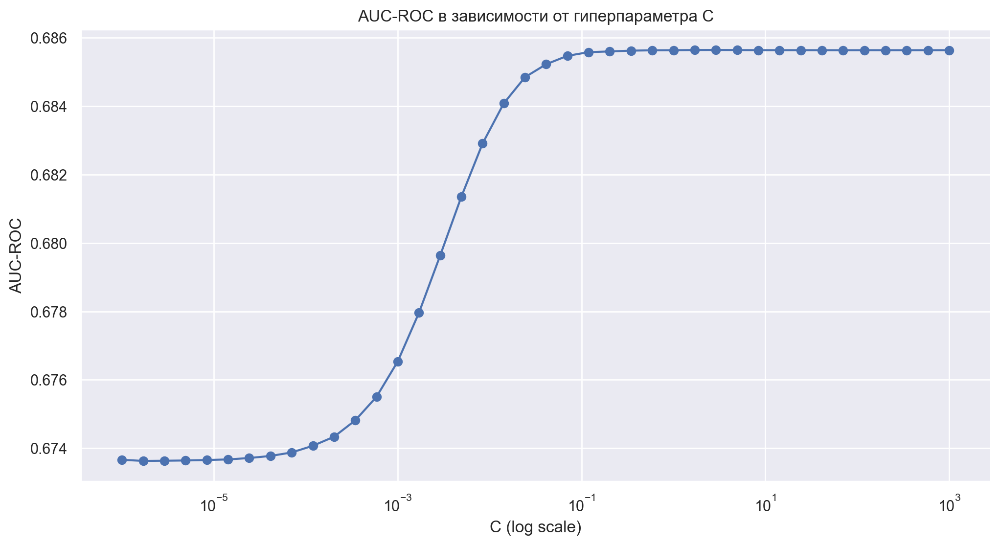

In [20]:
C_values = searcher_lr.cv_results_['param_C'].data.astype(float)
mean_auc = searcher_lr.cv_results_['mean_test_score']

plt.semilogx(C_values, mean_auc, marker='o')
plt.xlabel('C (log scale)')
plt.ylabel('AUC-ROC')
plt.title('AUC-ROC в зависимости от гиперпараметра C')
plt.show()

На графике видно, что средний AUC-ROC на кросс-валидации быстро растет приблизительно с $10^{-5}$ до $10^{-1}$. Далее качество снова выходит на плато.

#### 4. Валидация.

Провалидируем обученную модель по девяти тестам.

##### 4.1 Тест M2.1

Проверим эффективность ранжирования всей модели.

In [21]:
from sklearn.metrics import roc_auc_score

def plot_gini_curve(y_true, y_score):
    y_true = np.array(y_true)
    y_score = np.array(y_score)
    
    order = np.argsort(y_score)[::-1]
    y_true_sorted = y_true[order]
    
    cum_defaults = np.cumsum(y_true_sorted) / np.sum(y_true_sorted)
    cum_pop = np.arange(1, len(y_true_sorted) + 1) / len(y_true_sorted)
    
    plt.figure()
    sns.lineplot(x=cum_pop, y=cum_defaults, label='Кривая Лоренца')
    sns.lineplot(x=[0, 1], y=[0, 1], linestyle='--', label='Линия равенства', color='r')
    plt.xlabel('Доля наблюдений')
    plt.ylabel('Доля дефолтов')
    plt.title('Кривая Лоренца')
    plt.legend()
    plt.show()
    
    auc = roc_auc_score(y_true, y_score)
    gini = 2 * auc - 1
    print("Gini-коэффициент -", gini.round(4))


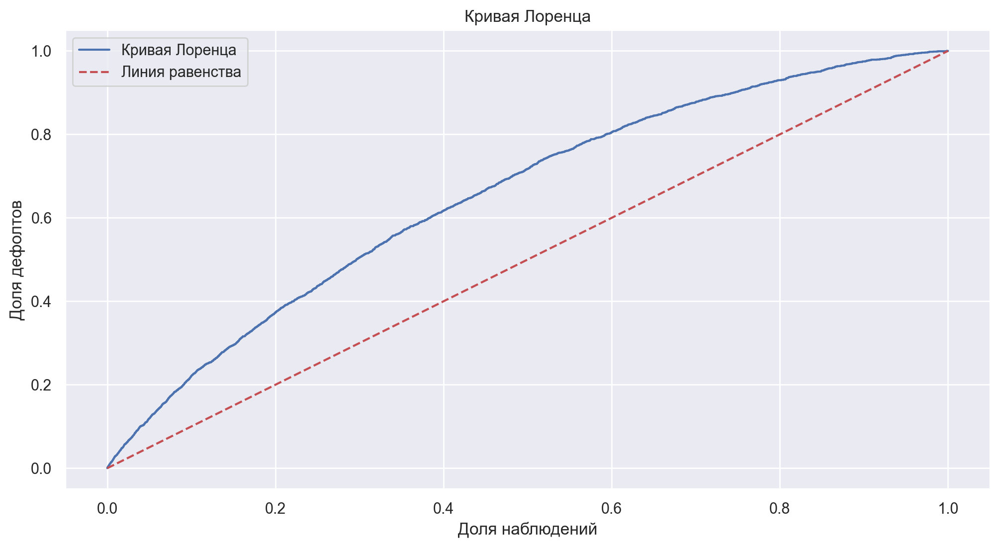

Gini-коэффициент - 0.3665


In [22]:
lr_pred = best_lr.predict_proba(x_test_woe)[:, 1]
plot_gini_curve(y_test, lr_pred)

Интерпретация коэффициента Джини:

| Результат теста     | Коэффициент Джини |
|---------------------|-------------------|
| <img src="./red.png" alt="red" width="20"/> | До 25% |
| <img src="./yelow.png" alt="red" width="20"/> | 25% – 35% |
| <img src="./green.png" alt="red" width="20"/> | 35% и выше |


Интерпретируемая модель находится в зеленой зоне. Тест пройден.

##### 4.2 Тест M2.2

Проверим эффективность ранжирования отдельных факторов.

In [23]:
def calculate_gini_per_feature(X, y):
    gini_scores = {}
    for col in X.columns:
        gini = 2 * roc_auc_score(y, X[col]) - 1
        gini_scores[col] = abs(gini)

    gini_series = pd.Series(gini_scores).sort_values(ascending=False)
    plt.figure(figsize=(12, 6))
    sns.barplot(gini_series)
    plt.title('Коэффициент Джини по признакам')
    plt.ylabel('Коэффициент Джини')
    plt.xlabel('Признак')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()
    return gini_series

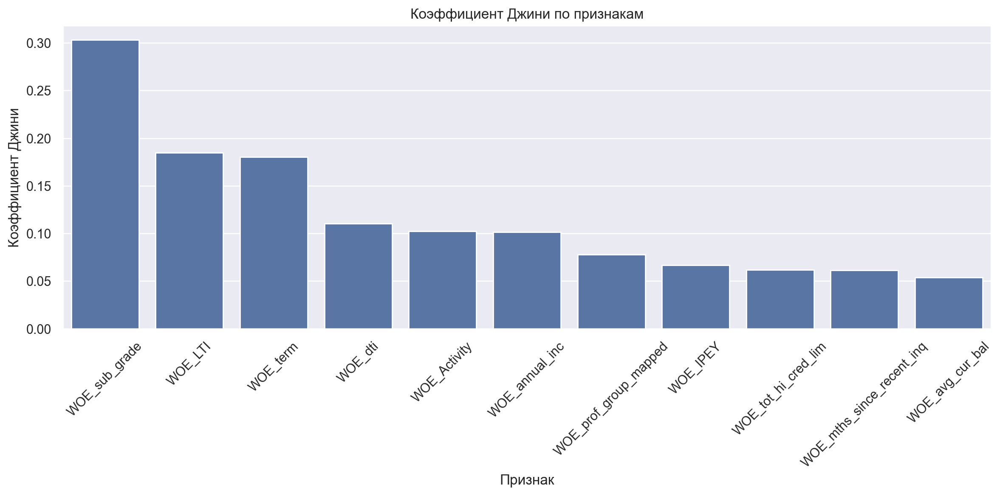

In [24]:
gini_per_feature = calculate_gini_per_feature(x_train_woe, y_train)

Границы коэффициента Джини для факторов

| Результат теста | Джини на уровне фактора |
|:----------------|:------------------------|
| <img src="./red.png" alt="red" width="20"/> | Менее 0% |
| <img src="./yelow.png" alt="red" width="20"/> | 0% – 5% |
| <img src="./green.png" alt="red" width="20"/> | Более 5% |


Итоговая интерпретация результатов теста M2.2

| Цвет теста | Условие |
|:-----------|:--------|
| <img src="./red.png" alt="red" width="20"/> | «Красных» факторов > 20% |
| <img src="./yelow.png" alt="red" width="20"/>  | Наличие более 10% «желтых» факторов, отсутствие «красных» факторов |
| <img src="./green.png" alt="red" width="20"/> | Наличие не более 10% «желтых» факторов, отсутствие «красных» факторов |

Все признаки находятся в зеленой зоне, тест пройден.

##### 4.3 Тест M2.5

Анализ вкладов факторов в формирование Джини модели.

In [25]:
def plot_incremental_gini(x_train, y_train, x_test,  y_test, best_params, model=LogisticRegression):
    features = list(x_train.columns)
    gini = []
    for k in range(1, len(features) + 1):
        modell = model(**best_params)
        modell.fit(x_train[features[:k]], y_train)
        y_pred = modell.predict_proba(x_test[features[:k]])[:, 1]
        gini.append(2 * roc_auc_score(y_test, y_pred) - 1)

    incremental = [gini[0]] + [gini[i] - gini[i - 1] for i in range(1, len(gini))]
    inc_dict = dict(zip(features, incremental))
    sorted_feats = sorted(inc_dict, key=lambda f: inc_dict[f], reverse=True)
    sorted_inc  = [inc_dict[f] for f in sorted_feats]
    cum_sorted = np.cumsum(sorted_inc)
    bottoms = [0.0] + list(cum_sorted[:-1])

    plt.bar(np.arange(len(sorted_feats)), sorted_inc, bottom=bottoms, edgecolor='red', label='Дополнительный вклад факторов')
    sns.lineplot(x=np.arange(len(sorted_feats)), y=sorted_inc, marker='o', color='red', label='Индивидуальный прирост Джини факторов')
    plt.xticks(np.arange(len(sorted_feats)), sorted_feats, rotation=45)
    plt.xlabel("Факторы, отсортированные по приросту Джини")
    plt.ylabel("Коэффициент Джини")
    plt.title("Джини Uplift")
    plt.legend()
    plt.tight_layout()
    plt.show()

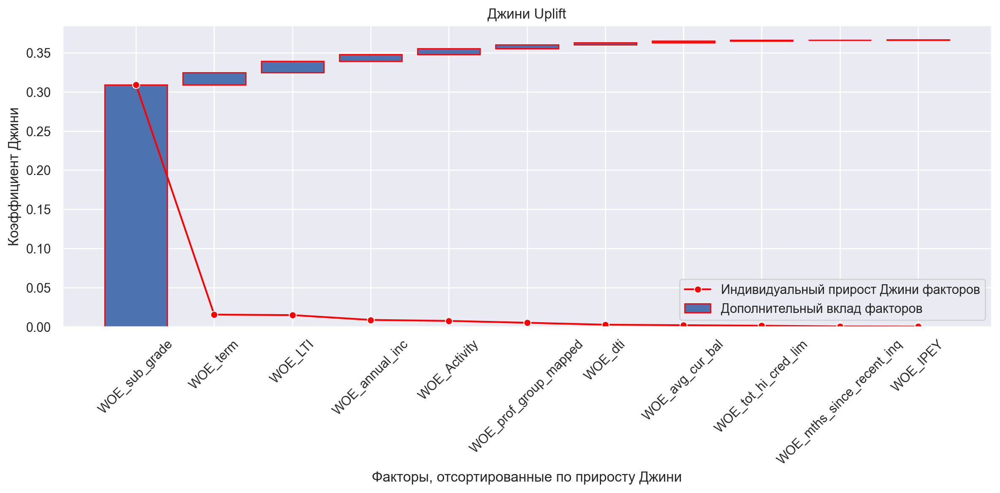

In [26]:
plot_incremental_gini(x_train_woe, y_train, x_test_woe, y_test, searcher_lr.best_params_)

Наибольшее вклад в качество модель вносит признак sub_grade. Далее по убыванию признаки term, LTI, annual_inc, Activity, prof_group, dti, оставшиеся признаки практически не увеличивают общий коэффициент Джини модели.

##### 4.4 Тест M2.4

Динамика коэффициента Джини.

In [27]:
x_test_woe_date = x_test_woe.copy()
x_test_woe_date['y'] = y_test
x_test_woe_date['year'] = x_test['year']
x_test_woe_date['month'] = x_test['month']

In [28]:
from sklearn.utils import resample

def compute_gini(data, target, pred, n_boot=1000, alpha=0.05):
    y = data[target].values
    p = data[pred].values
    gini = 2 * roc_auc_score(y, p) - 1

    boots = []
    for i in range(n_boot):
        idx = resample(np.arange(len(y)), replace=True)
        boots.append(2 * roc_auc_score(y[idx], p[idx]) - 1)

    return gini, np.percentile(boots, 100 * alpha / 2), np.percentile(boots, 100 * (1 - alpha / 2))

def plot_gini_dynamics(data_test, model, features, red_thr = 0.25, yellow_thr = 0.35):

    df = data_test.copy()
    df['date'] = pd.to_datetime(df[['year', 'month']].assign(day=1))
    df['pred_proba'] = model.predict_proba(df[features])[:,1]
    grp = df.set_index('date').groupby(pd.Grouper(freq='3MS'))
    rows = []

    for name, sub in grp:
        gini, lo, hi = compute_gini(sub, 'y', 'pred_proba')
        rows.append({
            'slice':          name.strftime('%Y-%m'),
            'n_obs':          len(sub),
            'gini':           gini,
            'gini_ci_low':    lo,
            'gini_ci_high':   hi
        })

    dyn = pd.DataFrame(rows).sort_values('slice').reset_index(drop=True)
    dyn['gini_pct'] = dyn['gini'] * 100
    dyn['ci_low_pct'] = dyn['gini_ci_low'] * 100
    dyn['ci_hi_pct'] = dyn['gini_ci_high'] * 100
    red_p = red_thr * 100
    yellow_p = yellow_thr * 100

    fig, ax1 = plt.subplots(figsize=(12,6))
    ax1.fill_between(np.arange(len(dyn)), dyn['n_obs'], color='green', alpha=0.3)
    ax1.set_ylabel('Число наблюдений', color='green')
    ax1.tick_params(axis='y', labelcolor='green')
    ax1.set_xticks(np.arange(len(dyn)))
    ax1.set_xticklabels(dyn['slice'], rotation=45)

    ax2 = ax1.twinx()
    ax2.plot(np.arange(len(dyn)), dyn['gini_pct'], marker='o', color='navy', linewidth=2, label='Джини')
    ax2.set_ylim(0, 100)
    ax2.set_ylabel('Джини (%)', color='navy')
    ax2.tick_params(axis='y', labelcolor='navy')

    ax2.axhline(y=yellow_p, color='orange', linestyle='--', label='Желтая зона')
    ax2.axhline(y=red_p, color='red', linestyle='--', label='Красная зона')

    ax2.fill_between(np.arange(len(dyn)),
                     dyn['ci_low_pct'],
                     dyn['ci_hi_pct'],
                     color='orange', alpha=0.2,
                     label='95% ДИ')

    for x, y in zip(np.arange(len(dyn)), dyn['gini_pct']):
        ax2.text(x, y + 1.5, f"{y:.1f}%", ha='center', va='bottom', color='navy', fontsize=8)

    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(lines1 + lines2, labels1 + labels2,
               loc='upper left', bbox_to_anchor=(0.01, 0.95))

    plt.title('Динамика коэффициента Джини')
    plt.tight_layout()
    plt.show()

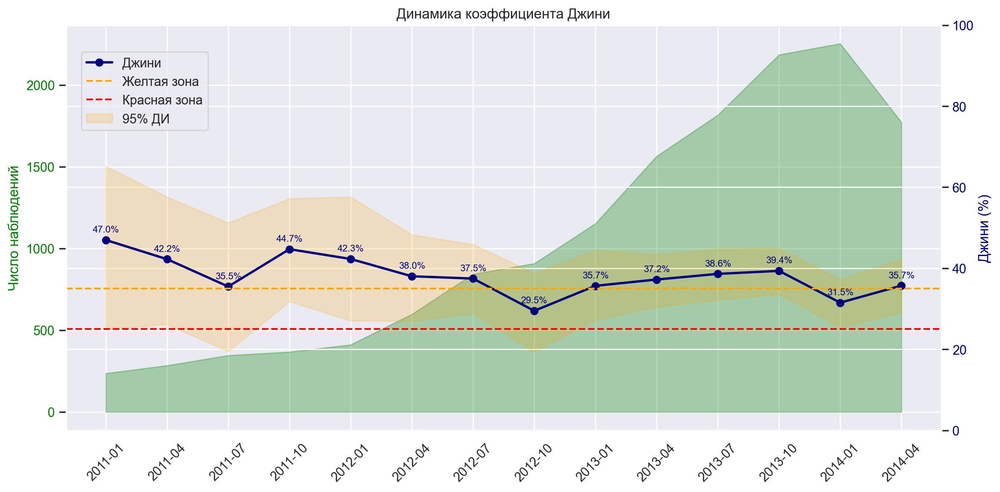

In [29]:
plot_gini_dynamics(data_test=x_test_woe_date, model=best_lr, features=[c for c in x_test_woe_date.columns if c.startswith('WOE_')])

Я построил график квартальной динамики коэффициента Джини, чтобы убедиться, что модель стабильно ранжирует наблюдения на всех временных срезах. К сожалению, выборка несбалансирована по времени, поэтому модель обучалась в основном по 2013-2014 годам - в эти периоды наблюдается стабильность ранжирования, а 2011-2012 годы отличаются большей волатильностью коэффициента. Важно учесть data drift и совершенно разные экономические условия этих периодов. Возможно, стоит исключить из рассмотрения 2011-2012 годы.

##### 4.5 Тест M3.1

Анализ корректности дискретного преобразования факторов.

In [30]:
x_train_woe_mon = x_train_woe.copy()
x_train_woe_mon['y'] = y_train
x_test_woe_mon = x_test_woe_date.drop(columns=['year', 'month'])

In [31]:
def compute_metrics(df, woe_col):
    gr = df.groupby(woe_col)
    total = len(df)
    bucket_share = gr.size() / total * 100
    event_rate   = gr['y'].mean() * 100
    return pd.DataFrame({
        'bucket_share': bucket_share,
        'event_rate':   event_rate
    }).sort_index()

def plot_woe_monotonicity_grid(train, test, woe_cols):
    fig, axes = plt.subplots(4, 3, figsize=(20, 25))
    axes = axes.flatten()
    
    for ax, woe_col in zip(axes, woe_cols):
        train_m, test_m = compute_metrics(train, woe_col), compute_metrics(test, woe_col)
        buckets = train_m.index.values
        x = np.arange(len(buckets))
        x_labels = [f"{b:.4f}" for b in buckets]

        ax.bar(x - 0.175, test_m['bucket_share'], width=0.35, label='Доля бакетов Test', color='cornflowerblue', zorder=0)
        ax.bar(x + 0.175, train_m['bucket_share'], width=0.35, label='Доля бакетов Train', color='lightgreen', zorder=0)
        ax.set_xticks(x)
        ax.set_xticklabels(x_labels, rotation=45, ha='right')
        ax.set_xlabel(woe_col)
        ax.set_ylabel('Доля бакетов (%)', color='green')
        ax.tick_params(axis='y', labelcolor='green')

        ax2 = ax.twinx()
        ax2.plot(x, train_m['event_rate'], marker='s', label='Default Rate Train', color='grey', zorder=1)
        ax2.plot(x, test_m['event_rate'], marker='o', label='Default Rate Test', color='purple', zorder=2)
        ax2.set_ylabel('Default Rate (%)', color='blue')
        ax2.tick_params(axis='y', labelcolor='blue')

        ymin, ymax = ax2.get_ylim()
        y_offset = (ymax - ymin) * 0.02
        event_rates = test_m['event_rate'].values
        diffs = np.zeros_like(event_rates)
        diffs[1:] = np.abs(event_rates[1:] - event_rates[:-1]) / np.where(event_rates[:-1] != 0, event_rates[:-1], np.nan)
        direction = event_rates[-1] - event_rates[0]

        for i in range(1, len(x)):
            rc = diffs[i]
            if np.isnan(rc):
                continue
            violation = (direction >= 0 and event_rates[i] < event_rates[i-1]) or (direction < 0 and event_rates[i] > event_rates[i-1])
            if not violation:
                continue
            share_violation = test_m['bucket_share'].iloc[i]
            if rc >= 0.10 and share_violation > 10:
                color = 'red'
            elif (rc < 0.10 and share_violation > 10) or (rc >= 0.10 and share_violation <= 10):
                color = 'orange'
            else:
                continue
            ax2.text(x[i], event_rates[i] + y_offset, f"{rc:.1%}", color=color, fontsize=14, ha='center', va='bottom', zorder=10)

        lines1, labels1 = ax.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax.legend(lines1 + lines2, labels1 + labels2, loc='upper right', fontsize=8, facecolor='white', frameon=True)
        ax.set_title(f"{woe_col} monotonicity", fontsize=14)

    for ax in axes:
        if not ax.has_data():
            ax.set_visible(False)
    plt.tight_layout()
    plt.show()

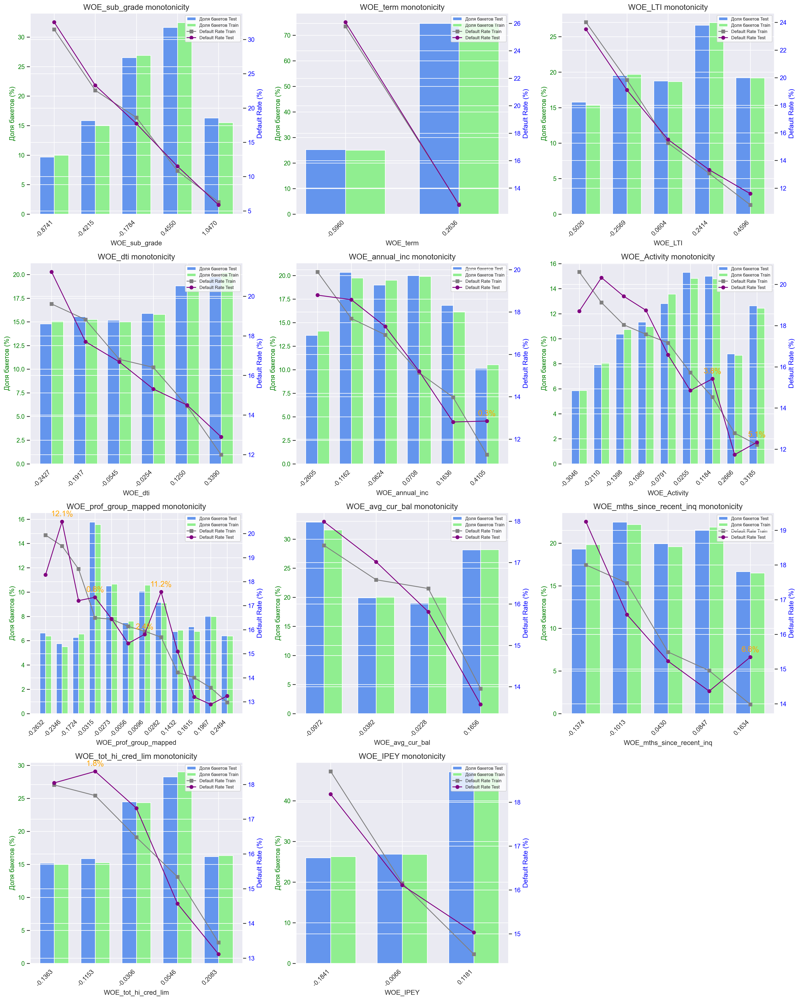

In [32]:
plot_woe_monotonicity_grid(x_train_woe_mon, x_test_woe_mon, list(x_test_woe_mon.columns)[:-1])

Границы критериев монотонности для факторов


| Результат теста | Критерий |
|:----------------|:---------|
| <img src="./red.png" alt="red" width="20"/> | Есть промежутки немонотонности, где относительная разность уровня целевого события в соседних бакетах превышает 10%. И доля наблюдений в немонотонных бакетах превышает 10%. |
| <img src="./yelow.png" alt="yellow" width="20"/> | Есть промежутки немонотонности, и выполняется хотя бы одно из условий:<br>- относительная разность уровня целевого события в соседних бакетах менее 10%, но доля наблюдений в немонотонных бакетах превышает 10%;<br>- или относительная разность превышает 10%, но доля наблюдений в немонотонных бакетах **не превышает** 10%. |
| <img src="./green.png" alt="green" width="20"/> | В остальных случаях |


Признакам, для которых нарушается условие результата теста, я подписал на графике причину нарушения соответствующим цветом. Таким образом, имеем:

Желтые признаки: WOE_annual_inc, Activity, prof_group, WOE_mths_since_recent_inq, WOE_tot_hi_cred_lim.

Итоговая интерпретация результатов теста M3.1


| Цвет теста | Условие |
|:-----------|:--------|
| <img src="./red.png" alt="red" width="20"/> | Более 20% факторов получили «красный» результат |
| <img src="./yelow.png" alt="yellow" width="20"/> | Более 10% факторов получили «желтый» результат при отсутствии «красных» факторов |
| <img src="./green.png" alt="green" width="20"/> | Не более 10% факторов получили «желтый» результат и отсутствуют «красные» факторы |


Результат теста - желтый.

##### 4.6 Тест M4.1

Сравнение прогнозного и фактического TR (Target Rate) на уровне выборки.

In [33]:
from scipy.stats import norm

def plot_pd_vs_tr_with_ci(test, alpha95=0.05, alpha99=0.01):
    P  = test['y_pred'].mean()
    TR = test['y'].mean()

    se = np.sqrt(P * (1 - P)/len(test))
    z95 = norm.ppf(1 - alpha95/2)
    z99 = norm.ppf(1 - alpha99/2)

    ci95_low, ci95_high = P - z95 * se, P + z95 * se
    ci99_low, ci99_high = P - z99 * se, P + z99 * se

    fig, ax = plt.subplots(figsize=(10, 7))
    ax.vlines(0.5, ci99_low, ci99_high, color='red', lw=4, label='ДИ 99%', zorder=1)
    ax.vlines(0.5, ci95_low, ci95_high, color='gold', lw=4, label='ДИ 95%', zorder=1)
    ax.scatter([0.5], [P], marker='o', s=100, color='black', label='Предсказанный TR', zorder=2)
    ax.scatter([0.5], [TR], marker='o', s=100, color='cornflowerblue', label='Наблюдаемый TR', zorder=2)

    ax.set_xticks([])
    ax.set_xlim(0,1)
    ax.set_ylabel('Target rate')
    ax.set_title('Тест на точность прогноза TR')
    ax.legend(loc='upper right')
    plt.tight_layout()
    plt.show()

    return abs((TR - P) / TR) * 100


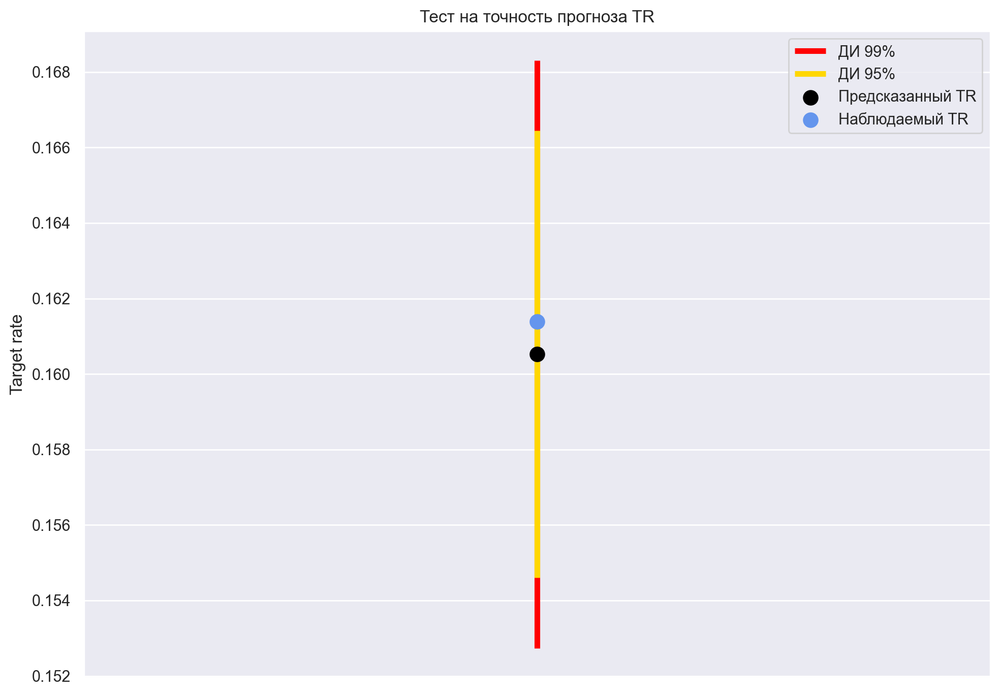

Результат теста: 0.5341 %


In [34]:
x_test_woe_TR = x_test_woe.copy()
x_test_woe_TR['y_pred'] = lr_pred
x_test_woe_TR['y'] = y_test
m4_result = plot_pd_vs_tr_with_ci(x_test_woe_TR)
print("Результат теста:", m4_result.round(4), "%")

| Результат теста | Критерий |
|:---------------:|:---------|
| <img src="./red.png"   alt="red"    width="20"/> | Отличие > 20%  |
| <img src="./yelow.png" alt="yellow" width="20"/> | Отличие > 10% |
| <img src="./green.png"  alt="green"  width="20"/> | Отличие <= 10% |

В нашей модели:

$$\frac{abs\left(TRfact-TRpred\right)}{TRfact} = 0.5341\%$$

Тест пройден.

##### 4.7 Тест M4.2

Тест формы калибровочной кривой.

In [35]:
def plot_bucket_level_ci(test, alpha95=0.05, alpha99=0.01):
    grp = test.groupby('score')
    counts = grp.size()
    share = counts / len(test) * 100
    pd_mean = grp['y_pred'].mean()
    obs_mean = grp['y'].mean()

    se = np.sqrt(pd_mean * (1 - pd_mean) / counts)
    z95, z99 = norm.ppf(1 - alpha95/2), norm.ppf(1 - alpha99/2)

    ci95_low = pd_mean - z95 * se
    ci95_high = pd_mean + z95 * se
    ci99_low = pd_mean - z99 * se
    ci99_high = pd_mean + z99 * se

    ln_obs = np.log(obs_mean.clip(lower=1e-9))
    ln_pd = np.log(pd_mean.clip(lower=1e-9))
    ln95_low = np.log(ci95_low.clip(lower=1e-9))
    ln95_high = np.log(ci95_high.clip(lower=1e-9))
    ln99_low = np.log(ci99_low.clip(lower=1e-9))
    ln99_high = np.log(ci99_high.clip(lower=1e-9))

    buckets = counts.index.astype(str)
    fig, ax_rate = plt.subplots(figsize=(10, 6))
    ax_share     = ax_rate.twinx()

    ax_rate.set_axisbelow(True)
    ax_share.bar(buckets, share, color='lightgreen', alpha=0.5, zorder=1, label='Доля бакетов')
    ax_share.set_ylabel('Доля бакетов (%)')

    ax_rate.fill_between(buckets, ln99_low, ln99_high, color='red',    alpha=0.2, zorder=2, label='ДИ 99%')
    ax_rate.fill_between(buckets, ln95_low, ln95_high, color='yellow', alpha=0.3, zorder=2, label='ДИ 95%')

    ax_rate.plot(buckets, ln_pd,   color='grey', linestyle='-', zorder=3, label='PD weighted')
    ax_rate.scatter(buckets, ln_obs, color='black', zorder=4, label='ADF')

    for i, bucket in enumerate(buckets):
        tr_fact = obs_mean.loc[test['score'].cat.categories[i]]
        tr_pred = pd_mean.loc[test['score'].cat.categories[i]]
        rel_err = abs(tr_fact - tr_pred) / tr_fact
        ax_rate.text(
            i, ln_obs.iloc[i] + 0.1,
            f"{rel_err:.1%}",                 
            ha='center', va='bottom',
            fontsize=8, color='black',
            zorder=5
        )

    ax_rate.set_xticklabels(buckets, rotation=45, ha='right')
    ax_rate.set_xlabel('Рейтинг')
    ax_rate.legend(loc='lower right')
    ax_rate.set_ylabel('ln(Default Rate)')
    ax_rate.set_title('Калибровочная кривая с относительной ошибкой в каждом бакете')
    plt.tight_layout()
    plt.show()


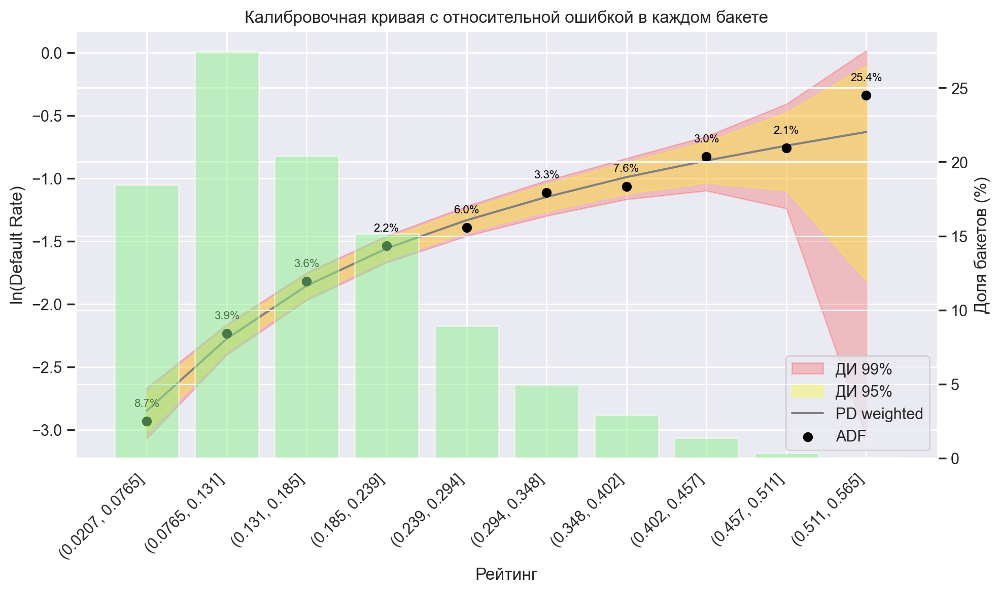

In [36]:
x_test_woe_TR['score'] = pd.cut(
    x_test_woe_TR['y_pred'],
    bins=10,
    include_lowest=True
)

plot_bucket_level_ci(x_test_woe_TR)

| Результат теста | Критерий |
|:---------------:|:---------|
| <img src="./red.png"   alt="red"    width="20"/> | Доля точек, таких что отличие > 20%, больше 30% |
| <img src="./yelow.png" alt="yellow" width="20"/> | Доля точек, таких что отличие > 20%, больше 15% |
| <img src="./green.png"  alt="green"  width="20"/> | Доля точек, таких что отличие > 20%, меньше 15% |

В нашей модели есть только один бакет с

$$\frac{abs\left(TRfact-TRpred\right)}{TRfact} > 20\%$$

Тест пройден.

##### 4.8 Тест M5.1

Сравнение эффективности ранжирования модели на разработке и валидации.

In [37]:
def bootstrap_gini_ci(y_true, y_pred, n_bootstrap = 1000, alpha = 0.05, random_state = 42):
    rng = np.random.RandomState(random_state)
    n = len(y_true)
    vals = []
    for i in range(n_bootstrap):
        idx = rng.choice(n, size=n, replace=True)
        if len(np.unique(y_true[idx])) < 2:
            continue
        vals.append(2 * roc_auc_score(y_true[idx], y_pred[idx]) - 1)
    lower = np.percentile(vals, 100 * (alpha/2))
    upper = np.percentile(vals, 100 * (1 - alpha/2))
    return lower, upper

def plot_gini_comparison(y_dev, pred_dev, y_val, pred_val, n_bootstrap = 1000, alpha = 0.05, seed = 42):
    
    g_dev = 2 * roc_auc_score(y_dev, pred_dev) - 1
    ci_dev = bootstrap_gini_ci(y_dev, pred_dev, n_bootstrap, alpha, random_state=seed)
    
    g_val = 2 * roc_auc_score(y_val, pred_val) - 1
    ci_val = bootstrap_gini_ci(y_val, pred_val, n_bootstrap, alpha, random_state= seed + 1 if seed is not None else None)
    
    labels = ['Train', 'Test']
    ginis = np.array([g_dev, g_val]) * 100
    ci_lower = np.array([ci_dev[0], ci_val[0]]) * 100
    ci_upper = np.array([ci_dev[1], ci_val[1]]) * 100
    err_lower = ginis - ci_lower
    err_upper = ci_upper - ginis
    yerr = np.vstack([err_lower, err_upper])
    
    fig, ax = plt.subplots(figsize=(10, 6))
    bars = ax.bar(labels, ginis, yerr=yerr, capsize=5, color=['lightgreen','green'], error_kw={'ecolor':'red', 'elinewidth':1.5}, zorder=3)
    
    for bar, val in zip(bars, ginis):
        ax.text(bar.get_x() + bar.get_width()/2, val + 3,
                f"{val:.2f}%", ha='center', va='bottom', fontsize=10, zorder=4)
    
    abs_diff = (g_val - g_dev) * 100
    rel_diff = (g_val - g_dev) / g_dev * 100
    change_text = f"Δ Gini = {abs_diff:.2f} п. п. ({rel_diff:.2f}% rel.)"
    ax.text(0.5, max(ginis + err_upper) + 5, change_text,
            ha='center', va='bottom', fontsize=11, fontweight='bold')
    
    ax.set_ylim(0, max(ginis + err_upper) + 15)
    ax.set_ylabel('Коэффициент Джини, %')
    ax.set_title('Коэффициент Джини для Train / Test c 95% ДИ')
    plt.tight_layout()
    plt.show()

In [38]:
lr_pred_train = best_lr.predict_proba(x_train_woe)[:, 1]
x_train_woe_TR = x_train_woe.copy()
x_train_woe_TR['y_pred'] = lr_pred_train
x_train_woe_TR['y'] = y_train
x_test_woe_TR = x_test_woe_TR.drop(columns='score')

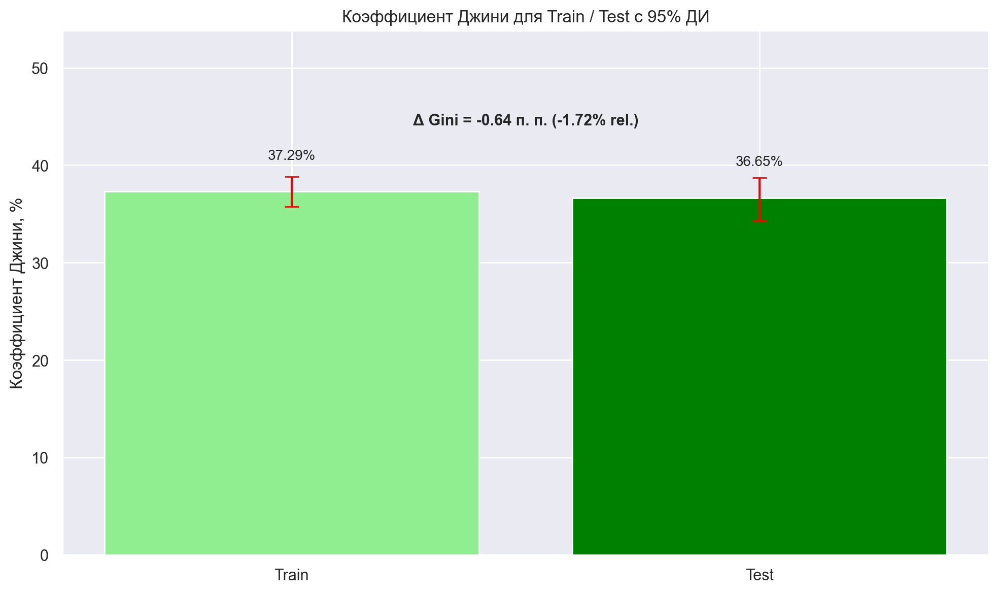

In [39]:
plot_gini_comparison(x_train_woe_TR['y'].values, x_train_woe_TR['y_pred'].values, x_test_woe_TR['y'].values, x_test_woe_TR['y_pred'].values)

Границы изменения коэффициента Джини для модели в целом:

| Результат теста | Динамика коэффициента Джини для модели в целом |
|:----------------|:------------------------------------------------|
| <img src="./red.png" alt="red" width="20"/> | Абсолютное снижение более 5 п. п. **и** относительное снижение более 20% |
| <img src="./yelow.png" alt="yellow" width="20"/> | Абсолютное снижение более 3 п. п. **и** относительное снижение более 15% |
| <img src="./green.png" alt="green" width="20"/> | Абсолютное снижение менее 3 п. п. **или** относительное снижение менее 15% |


Абсолютное снижение = 0.64 п. п., относительное = 1.72% $\Rightarrow$ Тест пройден.

##### 4.9 Тест M5.2

Сравнение эффективности ранжирования отдельных факторов модели на разработке и валидации.

In [40]:
def plot_feature_gini_diff(y_dev, X_dev, y_val, X_val, features):
    gini_dev = [abs(2 * roc_auc_score(y_dev, X_dev[feat]) - 1) for feat in features]
    gini_val = [abs(2 * roc_auc_score(y_val, X_val[feat]) - 1) for feat in features]
    
    dev_pct = np.array(gini_dev) * 100
    val_pct = np.array(gini_val) * 100

    fig, ax = plt.subplots(figsize=(12, 6))
    bar_dev = ax.bar(np.arange(len(features)) - 0.35 / 2, dev_pct, 0.35, label='Gini Dev',  color='lightgreen', zorder=3)
    bar_val = ax.bar(np.arange(len(features)) + 0.35 / 2, val_pct, 0.35, label='Gini Val', color='green', zorder=3)
    ax.grid(axis='y', linestyle='--', linewidth=0.5, zorder=0)

    for bars, vals in [(bar_dev, dev_pct), (bar_val, val_pct)]:
        for b, v in zip(bars, vals):
            ax.text(
                b.get_x() + b.get_width() / 2, 
                v + 1,
                f"{v:.1f}%",
                ha='center', va='bottom', fontsize=9, zorder=4
            )
    
    for i in range(len(features)):
        abs_diff = val_pct[i] - dev_pct[i]
        rel_diff = abs_diff / dev_pct[i] * 100 if dev_pct[i] != 0 else 0
        text = f"Δ={abs_diff:+.1f} п. п.\n({rel_diff:+.1f}% rel)"
        if rel_diff >= -20:
            ax.text(
                np.arange(len(features))[i], 
                max(dev_pct[i], val_pct[i]) + 5,
                text,
                ha='center', va='bottom', fontsize=8, zorder=4
            )
        else:
            ax.text(
                np.arange(len(features))[i], 
                max(dev_pct[i], val_pct[i]) + 5,
                text,
                ha='center', va='bottom', color='red', fontsize=8, zorder=4
            )


    ax.set_xticks(np.arange(len(features)))
    ax.set_xticklabels(features, rotation=45)
    ax.set_ylabel('Коэффициент Джини, %')
    ax.set_title('Сравнение Джини факторов на Train и Test')
    ax.set_ylim(0, max(dev_pct) + 15)
    ax.legend()
    plt.tight_layout()
    plt.show()


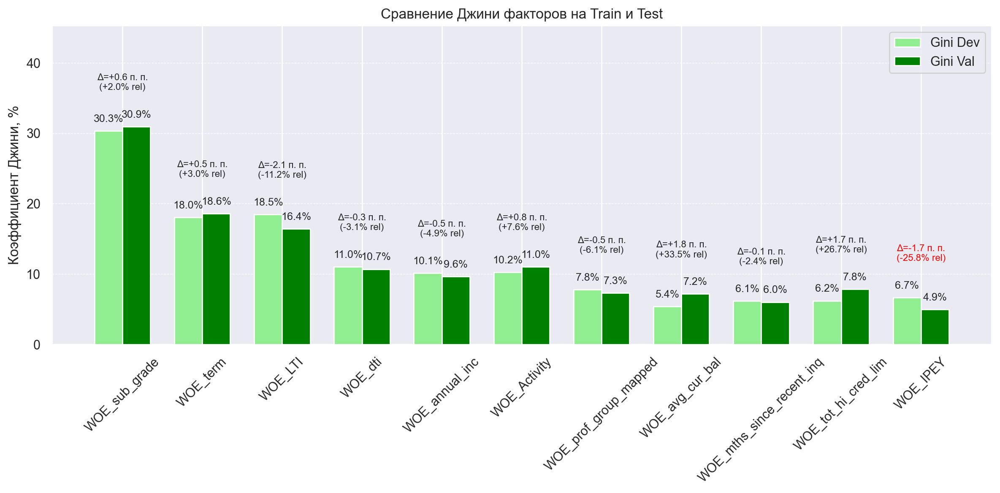

In [41]:
plot_feature_gini_diff(
    y_dev=x_train_woe_TR['y'].values,
    X_dev=x_train_woe_TR,
    y_val=x_test_woe_TR['y'].values,
    X_val=x_test_woe_TR,
    features=list(x_test_woe_TR.columns)[:-2]
)

| Результат теста                                      | Первичная валидация                                                               | Периодическая валидация                                                                         |
|:-----------------------------------------------------|:-----------------------------------------------------------------------------------|:-------------------------------------------------------------------------------------------------|
| <img src="./red.png"   alt="red"    width="20"/>     | Наличие хотя бы одного «красного» фактора                                         | Количество «красных» факторов более 20 %                                                          |
| <img src="./yelow.png" alt="yellow" width="20"/>    | Наличие более 10 % «желтых» факторов                                               | Количество «красных» факторов менее 20 % **и** количество «желтых» факторов ≥ 20 %              |
| <img src="./green.png"  alt="green"  width="20"/>    | Наличие не более 10 % «желтых» факторов                                            | Количество «желтых» факторов менее 20 % **и** «красные» факторы отсутствуют                       |


Тест не пройден. Признак IPEY красный, отсносительное снижение 25.8% 

##### 4.10 Итоги

По итогам валидации, 7/9 тестов зеленые. К сожалению, модель не прошла валидацию, так как тест M5.2 не пройден (красный). Чтобы исправить ситуацию, исключим из модели признак IPEY, он все равно имеет очень низкий IV и почти не дает прироста Джини модели. После этого снова обучим модель и проведем тесты повторно.

In [42]:
x_train_woe = x_train_woe.drop(columns='WOE_IPEY')
x_test_woe = x_test_woe.drop(columns='WOE_IPEY')

In [43]:
c_lr = np.logspace(-6, 3, 40)
searcher_lr = GridSearchCV(LogisticRegression(max_iter=1000), {'C': c_lr}, scoring='roc_auc', cv=10)
searcher_lr.fit(x_train_woe, y_train)
best_lr = searcher_lr.best_estimator_

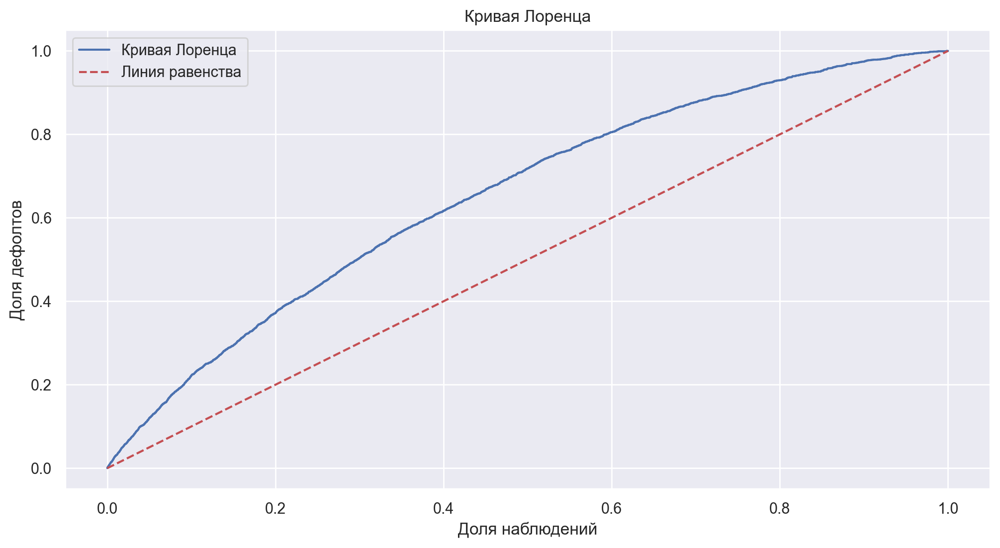

Gini-коэффициент - 0.3664


In [44]:
lr_pred = best_lr.predict_proba(x_test_woe)[:, 1]
plot_gini_curve(y_test, lr_pred)

Тест M2.1 пройден.

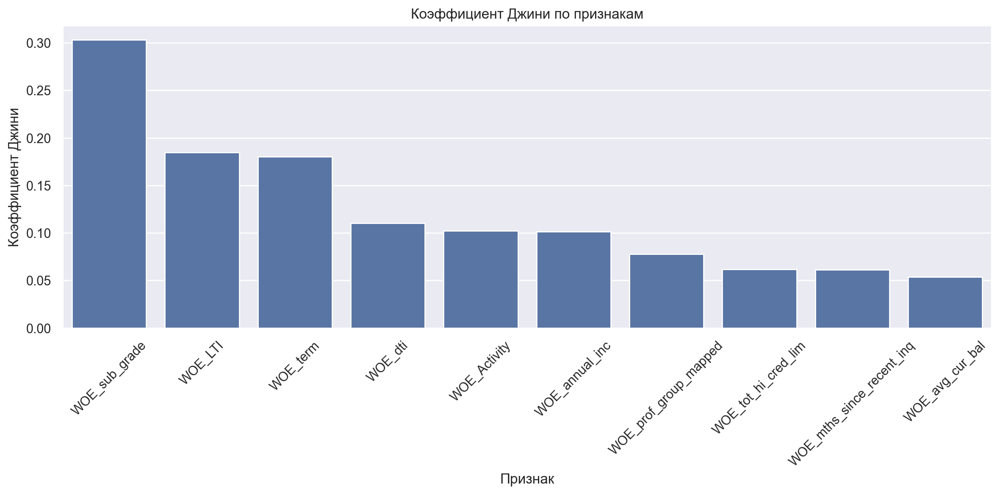

In [45]:
gini_per_feature = calculate_gini_per_feature(x_train_woe, y_train)

Тест M2.2 пройден.

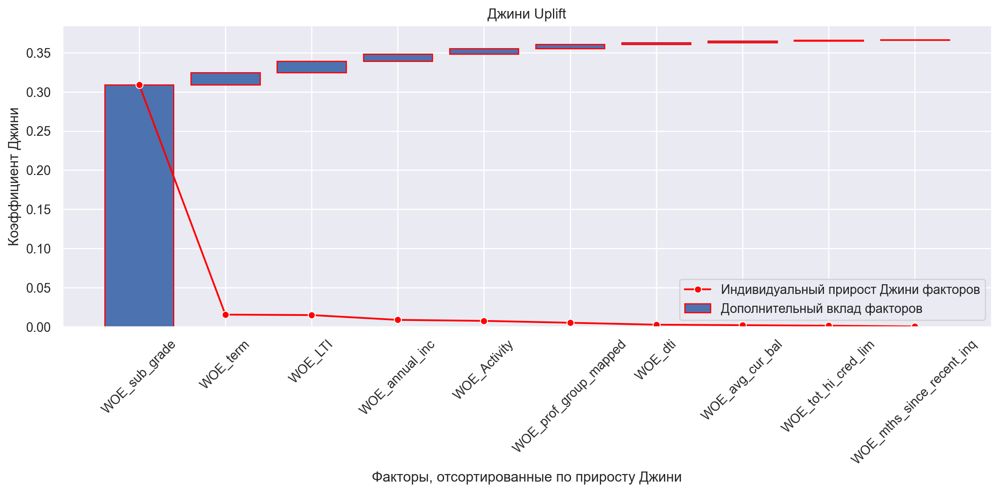

In [46]:
plot_incremental_gini(x_train_woe, y_train, x_test_woe, y_test, searcher_lr.best_params_)

Отсортированный список прироста Джини от включения в модель фактора не изменился.

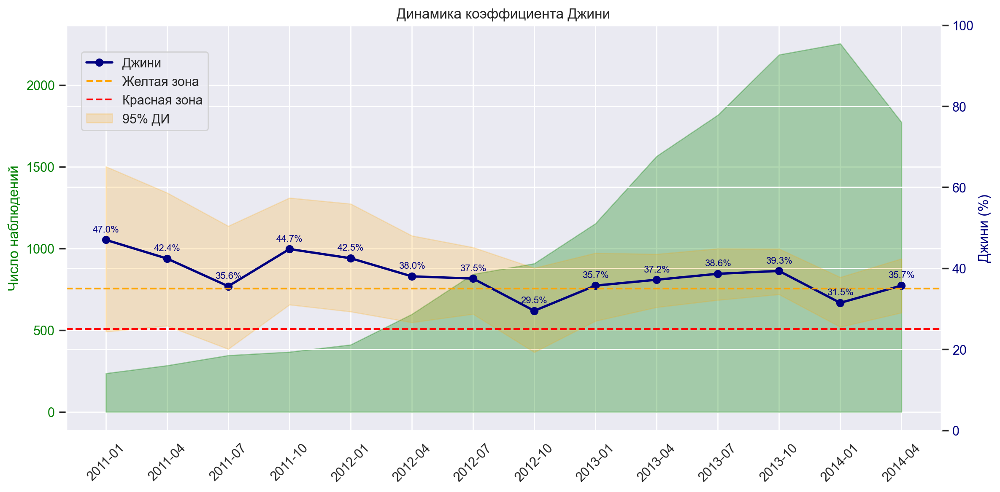

In [47]:
x_test_woe_date = x_test_woe.copy()
x_test_woe_date['y'] = y_test
x_test_woe_date['year'] = x_test['year']
x_test_woe_date['month'] = x_test['month']
plot_gini_dynamics(data_test=x_test_woe_date, model=best_lr, features=[c for c in x_test_woe_date.columns if c.startswith('WOE_')])

Дисбаланс первого периода все еще наблюдается.

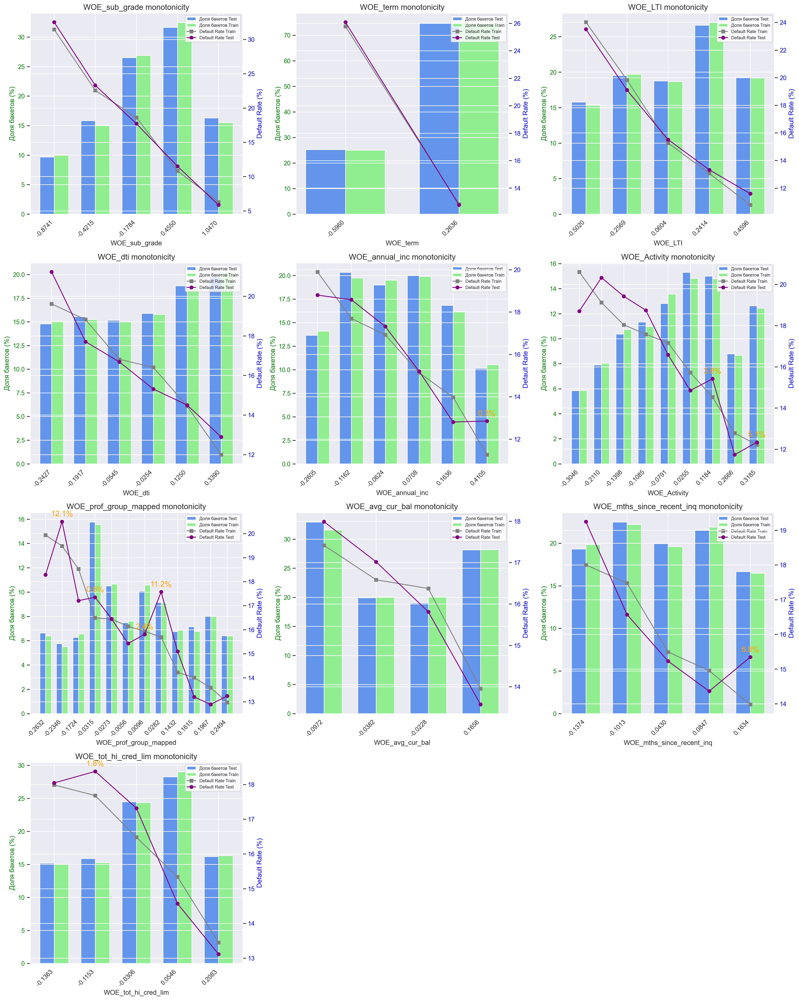

In [48]:
x_train_woe_mon = x_train_woe.copy()
x_train_woe_mon['y'] = y_train
x_test_woe_mon = x_test_woe_date.drop(columns=['year', 'month'])
plot_woe_monotonicity_grid(x_train_woe_mon, x_test_woe_mon, list(x_test_woe_mon.columns)[:-1])

Тест M3.1 пройден.

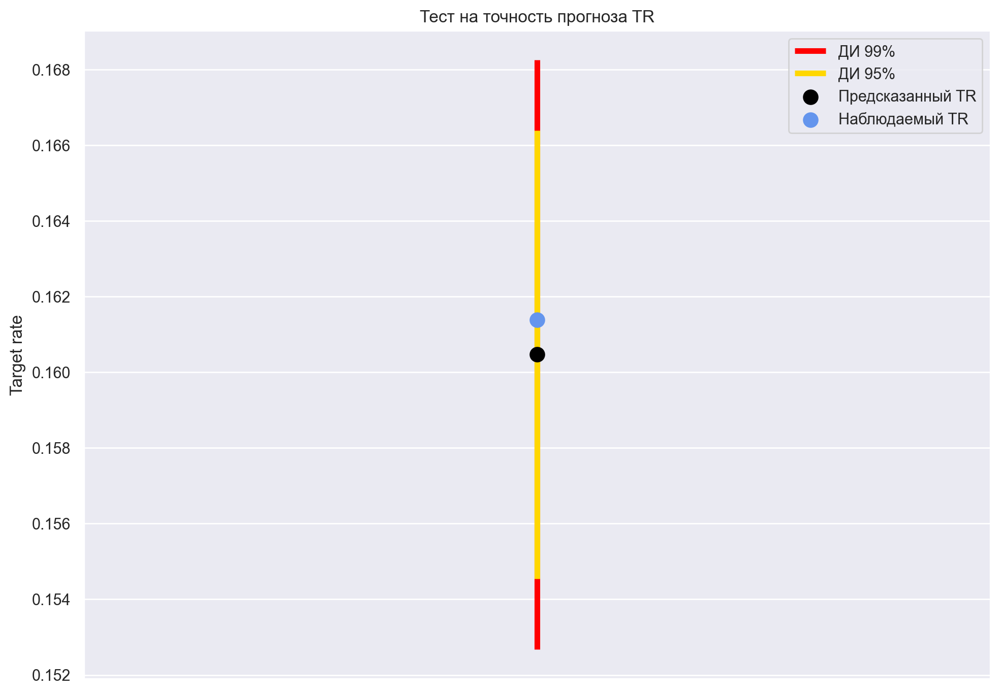

Результат теста: 0.5679 %


In [49]:
x_test_woe_TR = x_test_woe.copy()
x_test_woe_TR['y_pred'] = lr_pred
x_test_woe_TR['y'] = y_test
m4_result = plot_pd_vs_tr_with_ci(x_test_woe_TR)
print("Результат теста:", m4_result.round(4), "%")

Тест M4.1 пройден.

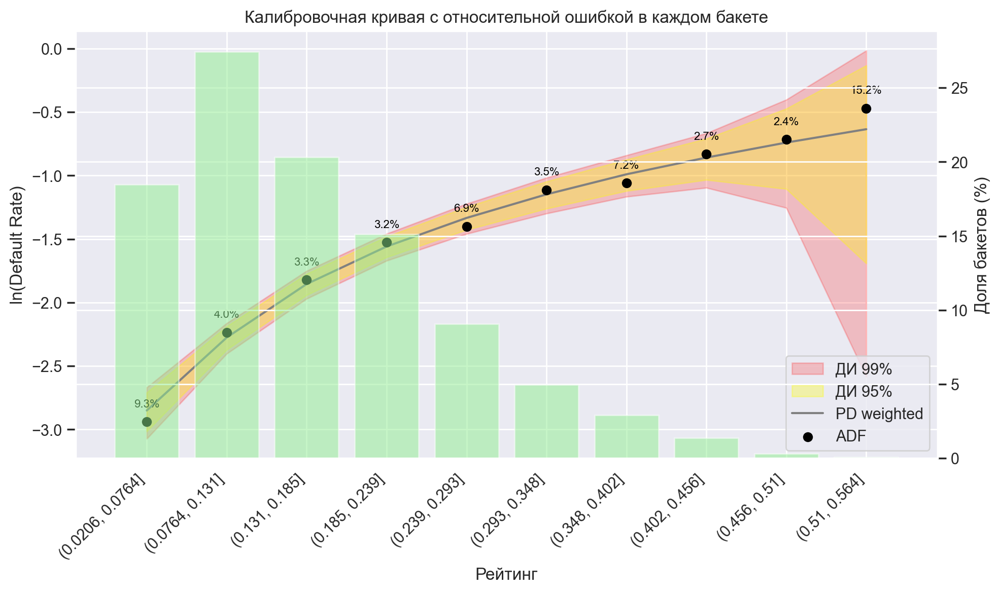

In [50]:
x_test_woe_TR['score'] = pd.cut(
    x_test_woe_TR['y_pred'],
    bins=10,
    include_lowest=True
)

plot_bucket_level_ci(x_test_woe_TR)

Тест M4.2 пройден.

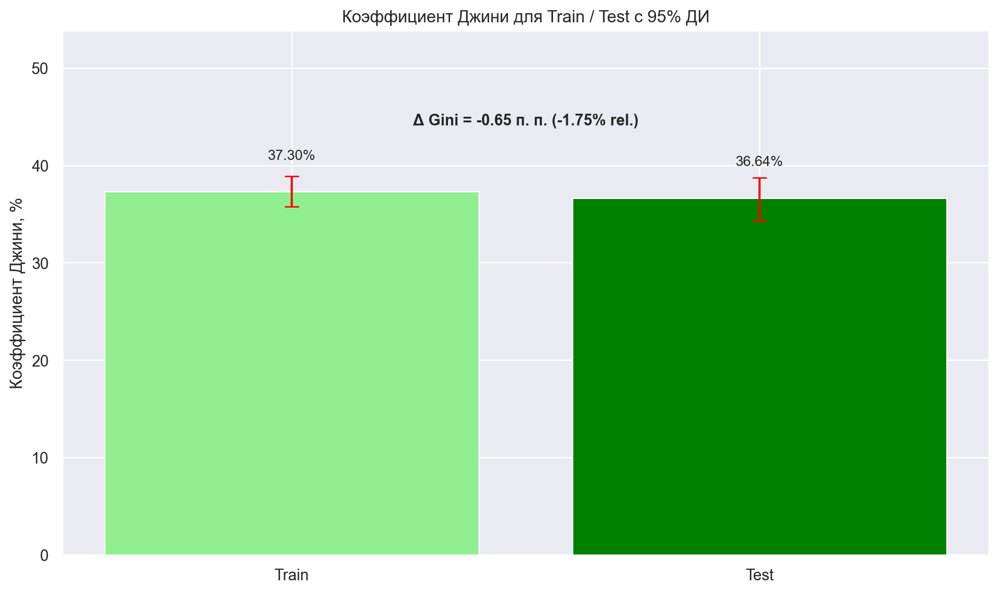

In [51]:
lr_pred_train = best_lr.predict_proba(x_train_woe)[:, 1]
x_train_woe_TR = x_train_woe.copy()
x_train_woe_TR['y_pred'] = lr_pred_train
x_train_woe_TR['y'] = y_train
x_test_woe_TR = x_test_woe_TR.drop(columns='score')
plot_gini_comparison(x_train_woe_TR['y'].values, x_train_woe_TR['y_pred'].values, x_test_woe_TR['y'].values, x_test_woe_TR['y_pred'].values)

Тест M5.1 пройден.

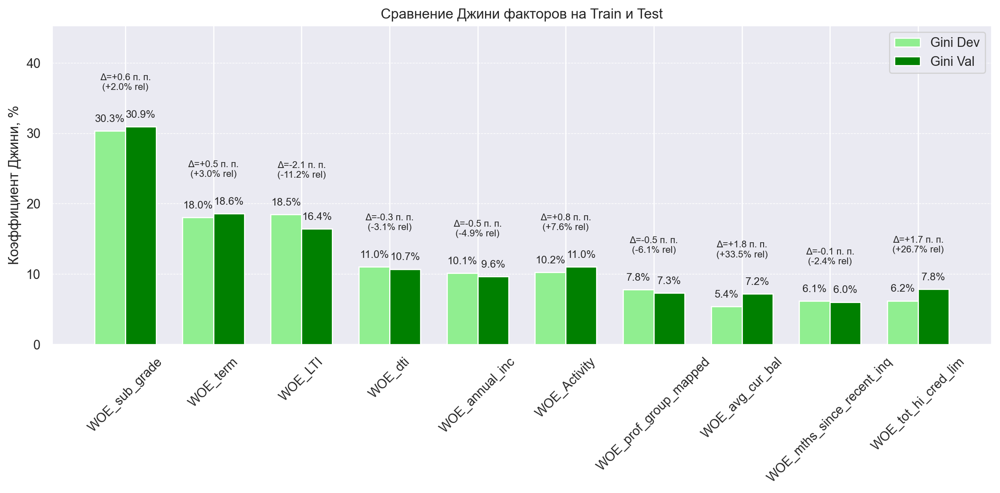

In [52]:
plot_feature_gini_diff(
    y_dev=x_train_woe_TR['y'].values,
    X_dev=x_train_woe_TR,
    y_val=x_test_woe_TR['y'].values,
    X_val=x_test_woe_TR,
    features=list(x_test_woe_TR.columns)[:-2]
)

Тест M5.2 пройден.

Таким образом, интерпретируемая модель прошла валидацию. Она может быть использована в дальнейших рассмотрениях кредитных заявок.

#### ChatGPT.

При построении графиков валидации я прибегал к помощи модели o4-mini-high. Хотелось построить красивые графики со всеми подписями и доверительными интервалами. Довести все до ума помогла нейронная сеть.

#### 5. Скоринговая карта.

Логистическая регрессия моделирует вероятность события через логарифм отношения шансов "Odds":

$$\text{logit}(p) = \log(\frac{p}{1-p}) = \beta_0 + \sum_j\beta_j \cdot \text{WOE}_j$$

Чтобы не работать с коэффициентами и логарифмом шансов строят скоринговую карту. Каждому WOE-бину присваивается некоторый балл, а сумма всех баллов является итоговой оценкой. Для этого вводят переменные:

* PDO - количество баллов, при котором Odds удваивается - полезно, чтобы оценка менялась на фиксированное число;

* Базовый балл - константа, изначальное значение оценки. 

Балл для каждого WOE-бина рассчитывается по формуле:

$$\text{Score} = -\beta_j \cdot \text{WOE} \cdot \frac{\text{PDO}}{\ln2}$$

Перед коэффициентом стоит знак "минус", чтобы соблюсти правило - чем выше риск, тем меньше балл. 

In [ ]:
# ChatGPT o4-mini-high - не знал как технически построить карту и синтаксис сберовской библиотеки. ИИ помог. 
PDO = 20  
factor = PDO / np.log(2)
intercept = best_lr.intercept_[0]
coefs = best_lr.coef_[0]

feature_names = x_train_woe.columns.tolist()
intercept_points = - intercept * factor
scorecard_entries = []
scorecard_entries.append({
    'variable': 'Intercept',
    'bin': '',
    'WOE': np.nan,
    'points': round(intercept_points, 0)
})

for idx, feature in enumerate(feature_names):
    coef = coefs[idx]
    orig_var = feature.replace('WOE_', '')
    woe_fitter = woe_transformer.fitted_wing[orig_var]
    if woe_fitter.vector_type == "c":
        woe_table = woe_fitter.get_wing_agg(only_clear=True).reset_index()
        woe_table.columns = ['bin_interval', 'good', 'bad', 'total', 'WOE', 'local_event_rate']

        for _, row in woe_table.iterrows():
            woe_value = row['WOE']
            points = - coef * woe_value * factor
            scorecard_entries.append({
                'variable': orig_var,
                'bin': row['bin_interval'],
                'WOE': woe_value,
                'points': round(points, 0)
            })

    else:
        cat_map = woe_fitter.categories_woes.copy()

        for _, crow in cat_map.iterrows():
            category_value = crow["X"]
            woe_val = crow["woe"]
            points = - coef * woe_val * factor
            scorecard_entries.append({
                'variable': orig_var,
                'bin': category_value,
                'WOE': woe_val,
                'points': round(points, 0)
            })

scorecard = pd.DataFrame(scorecard_entries)

In [54]:
scorecard

,variable,bin,WOE,points
0,Intercept,,NaN,48
1,sub_grade,A,1,22
2,sub_grade,B,0,10
3,sub_grade,C,-0,-4
4,sub_grade,D,-0,-9
...,...,...,...,...
71,tot_hi_cred_lim,"(-inf, 25096.5)",-0,-1
72,tot_hi_cred_lim,"(25096.5, 46601.0)",-0,-1
73,tot_hi_cred_lim,"(46601.0, 109051.5)",-0,-0
74,tot_hi_cred_lim,"(109051.5, 248908.5)",0,1


Интепретация скоринговой карты в отчете.

### V. Неинтерпретируемая модель.

Наконец мы закончили с WOE-преобразованиями и логистической регрессией. Теперь мы готовы построить неинтерпретируемую модель с целью повышения качества. Я собираюсь построить три модели и выбрать лучшую из них:

1. Бустинг;
2. Случайный лес;
3. Ядровый SVM;

In [11]:
x_train = pd.read_csv('x_train.csv', index_col='Unnamed: 0')
x_test = pd.read_csv('x_test.csv', index_col='Unnamed: 0')
y_train = pd.read_csv('y_train.csv', index_col='Unnamed: 0')
y_test = pd.read_csv('y_test.csv', index_col='Unnamed: 0')

In [53]:
x_train = x_train[['purpose', 'sub_grade', 'home_ownership', 'dti', 'annual_inc',
       'emp_length', 'term', 'mths_since_recent_inq', 'avg_cur_bal', 'month', 'year',
       'tot_hi_cred_lim', 'prof_group_mapped', 'LTI', 'Activity', 'IPEY', 'grid_cell']]
x_test = x_test[['purpose', 'sub_grade', 'home_ownership', 'dti', 'annual_inc',
       'emp_length', 'term', 'mths_since_recent_inq', 'avg_cur_bal', 'month', 'year',
       'tot_hi_cred_lim', 'prof_group_mapped', 'LTI', 'Activity', 'IPEY', 'grid_cell']]

Выделим валидационную выборку для подбора гиперпараметров моделей.

In [54]:
x_train, x_valid, y_train, y_valid = train_test_split(x_train, y_train, test_size=0.2, random_state=42)

Выделим числовые и категориальные признаки, подготовим словарь с интересующими нас метриками.

In [55]:
numeric = ['dti', 'annual_inc', 'emp_length', 'mths_since_recent_inq', 'avg_cur_bal', 'tot_hi_cred_lim', 'LTI', 'Activity', 'IPEY']
categorical = ['purpose', 'sub_grade', 'home_ownership', 'prof_group_mapped', 'term', 'grid_cell', 'month']
metrics = pd.DataFrame(
    columns=['auc_pr', 'roc_auc_score', 'gini']
)

#### 1. CatBoost

Построим бустинг в реализации CatBoost. Композиция деревьев позволит вычленить нелинейные зависимости в данных. Закодируем категориальные признаки с помощью MeanTargetEncoder, а числовые отнормируем с помощью StandartScaler. Вычислим интересующие нас метрики. У бустинга много гиперпараметров - подберем их с помощью Optuna.

In [56]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import average_precision_score
from catboost import CatBoostClassifier
import optuna
import category_encoders as ce
from optuna import Trial
from sklearn.metrics import average_precision_score
from sklearn.metrics import roc_auc_score
from optuna.samplers import TPESampler

Функция отрисовки кривых ROC и Precision-Recall.

In [57]:
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import PrecisionRecallDisplay

def depict_pr_roc(y_true, y_pred, classifier_name='Some Classifier', ax=None):
    if ax is None:
        fig, ax = plt.subplots(1, 2, figsize=(11, 5))

    PrecisionRecallDisplay.from_predictions(y_true, y_pred, ax=ax[0], name=classifier_name)
    ax[0].set_title("PRC")
    ax[0].set_ylim(0, 1.1)

    RocCurveDisplay.from_predictions(y_true, y_pred, ax=ax[1], name=classifier_name)
    ax[1].set_title("ROC")
    ax[1].set_ylim(0, 1.1)

    plt.tight_layout()
    plt.legend()

Подбор гиперпараметров.

In [58]:
column_transformer = ColumnTransformer([
    ('mean_target', ce.TargetEncoder(cols=categorical), categorical),
    ('scaling', StandardScaler(), numeric)
], remainder="drop")

def catboost_objective(trial: Trial):
    depth = trial.suggest_int('depth', 4, 8)  
    iterations = trial.suggest_int('iterations', 100, 400)  
    learning_rate = trial.suggest_float('learning_rate', 0.02, 0.2, log=True)  
    subsample = trial.suggest_float('subsample', 0.7, 1.0)  
    colsample_bylevel = trial.suggest_float('colsample_bylevel', 0.7, 1.0)  
    l2_leaf_reg = trial.suggest_float('l2_leaf_reg', 2, 8)  

    pipeline_cat = Pipeline([
        ('preprocessing', column_transformer),
        ('catboost', CatBoostClassifier(
            depth=depth,
            iterations=iterations,
            learning_rate=learning_rate,
            subsample=subsample,
            colsample_bylevel=colsample_bylevel,
            l2_leaf_reg=l2_leaf_reg,
            loss_function="Logloss",
            eval_metric="AUC",
            random_seed=42,
            verbose=False,
            early_stopping_rounds=40
        ))
    ])

    pipeline_cat.fit(x_train, y_train)
    y_pred_proba = pipeline_cat.predict_proba(x_valid)[:, 1]
    auc_pr = roc_auc_score(y_valid, y_pred_proba)
    return auc_pr

In [103]:
sampler = TPESampler(seed=42)
study = optuna.create_study(direction='maximize', sampler=sampler)
study.optimize(catboost_objective, n_trials=500, timeout=3600)

print("Лучшие параметры:", study.best_params)
print("Лучший AUC-PR:", study.best_value)

[I 2025-06-02 20:41:18,381] A new study created in memory with name: no-name-6148ad19-195c-4558-81db-c3161b14481b
[I 2025-06-02 20:41:21,287] Trial 0 finished with value: 0.6748813100725196 and parameters: {'depth': 5, 'iterations': 386, 'learning_rate': 0.10790061933340454, 'subsample': 0.8795975452591109, 'colsample_bylevel': 0.7468055921327309, 'l2_leaf_reg': 2.9359671220172157}. Best is trial 0 with value: 0.6748813100725196.
[I 2025-06-02 20:41:23,691] Trial 1 finished with value: 0.684669099718416 and parameters: {'depth': 4, 'iterations': 360, 'learning_rate': 0.0798261175712336, 'subsample': 0.9124217733388136, 'colsample_bylevel': 0.7061753482887407, 'l2_leaf_reg': 7.819459112971966}. Best is trial 1 with value: 0.684669099718416.
[I 2025-06-02 20:41:25,280] Trial 2 finished with value: 0.6908231999874153 and parameters: {'depth': 8, 'iterations': 163, 'learning_rate': 0.030398696602619617, 'subsample': 0.7550213529560301, 'colsample_bylevel': 0.7912726728878613, 'l2_leaf_reg'

Лучшие параметры: {'depth': 6, 'iterations': 286, 'learning_rate': 0.028115669618296906, 'subsample': 0.9587814747826541, 'colsample_bylevel': 0.9425123367428471, 'l2_leaf_reg': 6.627943860559644}
Лучший AUC-PR: 0.6923992826692256


Сохраним подобранные гиперпараметры, чтобы в дальнейшим не запускать поиск заново.

In [59]:
best_params_cat = {'depth': 6,
 'iterations': 286,
 'learning_rate': 0.028115669618296906,
 'subsample': 0.9587814747826541,
 'colsample_bylevel': 0.9425123367428471,
 'l2_leaf_reg': 6.627943860559644}

Обучение с лучшими параметрами.

AUC-PR: 0.29566344764244484
AUC-ROC: 0.6882684458107289


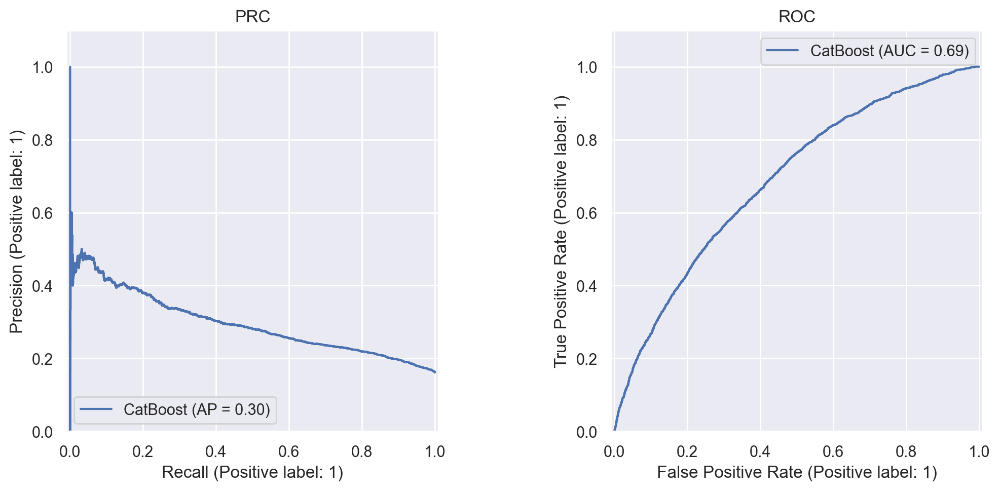

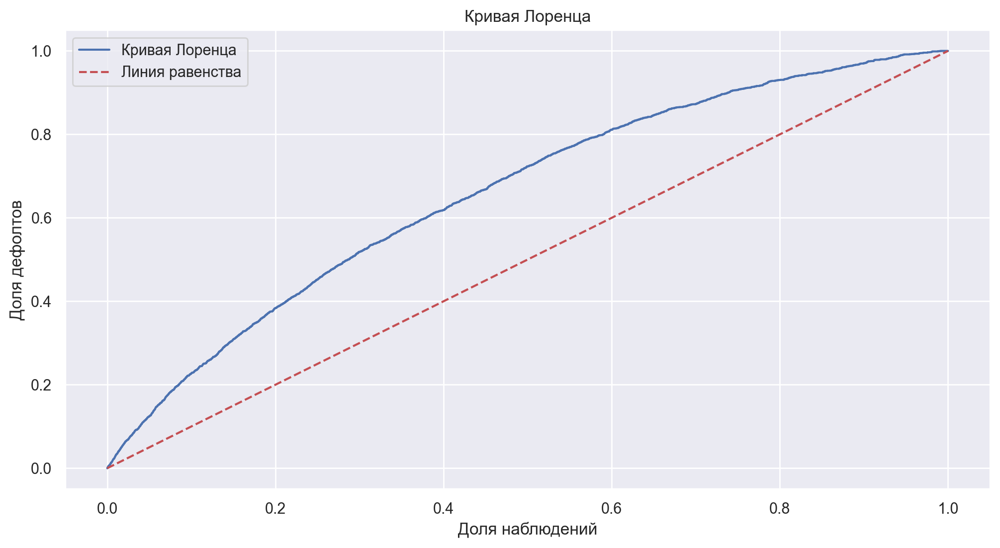

Gini-коэффициент - 0.3765


In [60]:
column_transformer = ColumnTransformer([
    ('mean_target', ce.TargetEncoder(cols=categorical), categorical),
    ('scaling', StandardScaler(), numeric)
], remainder="drop")

pipeline_cat = Pipeline([
    ('preprocessing', column_transformer),
    ('catboost', CatBoostClassifier(
        **best_params_cat,
        loss_function="Logloss",
        eval_metric="AUC",
        random_seed=42,
        verbose=False,
        early_stopping_rounds=40
    ))
])

pipeline_cat.fit(x_train, y_train)
cat_pred = pipeline_cat.predict_proba(x_test)[:, 1]
auc_pr_cat = average_precision_score(y_test, cat_pred)
auc_roc_cat = roc_auc_score(y_test, cat_pred)
gini_cat = 2 * auc_roc_cat - 1

print('AUC-PR:', auc_pr_cat)
print('AUC-ROC:', auc_roc_cat)
depict_pr_roc(y_test, cat_pred, 'CatBoost')
plot_gini_curve(y_test, cat_pred)

metrics.loc['CatBoost'] = [
    auc_pr_cat,
    auc_roc_cat,
    gini_cat
]

Мы получили значимую прибавку в Джини в сравнении с логистической регрессией на WoE-преобразованиях. Итоговый скор $\text{Gini} = 0.3765$. Обучим остальные модели.

#### 2. RandomForest

Построим случайный лес в реализации RandomForest из sklearn. Композиция деревьев позволит вычленить нелинейные зависимости в данных. Закодируем категориальные признаки с помощью MeanTargetEncoder, а числовые отнормируем с помощью StandartScaler. Вычислим интересующие нас метрики. У случайного леса много гиперпараметров - подберем их с помощью Optuna. 

Cлучайный лес хорошо борется с мультиколлинеарностью. Посмотрим, получим ли мы какую-то значимую прибавку в качестве.

In [61]:
from sklearn.ensemble import RandomForestClassifier

column_transformer = ColumnTransformer([
    ('mean_target', ce.TargetEncoder(cols=categorical), categorical),
    ('scaling', StandardScaler(), numeric)
], remainder="drop")

def rf_objective(trial: Trial):
    n_estimators = trial.suggest_int("n_estimators", 100, 1000, step=100)
    max_depth = trial.suggest_int("max_depth", 5, 30)  
    max_features = trial.suggest_float("max_features", 0.1, 1.0) 
    min_samples_split = trial.suggest_int("min_samples_split", 2, 10) 
    min_samples_leaf = trial.suggest_int("min_samples_leaf", 1, 4)  
    bootstrap = trial.suggest_categorical("bootstrap", [True, False])  

    pipeline_rf = Pipeline([
        ('preprocessing', column_transformer),
        ('rf', RandomForestClassifier(
            n_estimators=n_estimators,
            max_depth=max_depth,
            max_features=max_features,
            min_samples_split=min_samples_split,
            min_samples_leaf=min_samples_leaf,
            bootstrap=bootstrap,
            random_state=42,
            n_jobs=-1
        ))
    ])

    pipeline_rf.fit(x_train, y_train)
    y_pred_proba = pipeline_rf.predict_proba(x_valid)[:, 1]
    auc_pr = roc_auc_score(y_valid, y_pred_proba)
    return auc_pr

In [111]:
sampler_rf = TPESampler(seed=42)
study_rf = optuna.create_study(direction='maximize', sampler=sampler_rf)
study_rf.optimize(rf_objective, n_trials=500, timeout=3600)

print("Лучшие параметры:", study_rf.best_params)
print("Лучший AUC-PR:", study_rf.best_value)

[I 2025-06-02 21:35:34,097] A new study created in memory with name: no-name-683dda8e-dcfc-428a-b2b6-579ef5e9dc05
[I 2025-06-02 21:35:36,490] Trial 0 finished with value: 0.65913527033617 and parameters: {'n_estimators': 400, 'max_depth': 29, 'max_features': 0.7587945476302645, 'min_samples_split': 7, 'min_samples_leaf': 1, 'bootstrap': True}. Best is trial 0 with value: 0.65913527033617.
[I 2025-06-02 21:35:40,604] Trial 1 finished with value: 0.6720716072299392 and parameters: {'n_estimators': 900, 'max_depth': 20, 'max_features': 0.737265320016441, 'min_samples_split': 2, 'min_samples_leaf': 4, 'bootstrap': True}. Best is trial 1 with value: 0.6720716072299392.
[I 2025-06-02 21:35:41,147] Trial 2 finished with value: 0.6857867828658624 and parameters: {'n_estimators': 200, 'max_depth': 9, 'max_features': 0.373818018663584, 'min_samples_split': 6, 'min_samples_leaf': 2, 'bootstrap': False}. Best is trial 2 with value: 0.6857867828658624.
[I 2025-06-02 21:35:41,886] Trial 3 finished w

Лучшие параметры: {'n_estimators': 300, 'max_depth': 10, 'max_features': 0.14809781937928923, 'min_samples_split': 6, 'min_samples_leaf': 3, 'bootstrap': False}
Лучший AUC-PR: 0.6886595667699664


In [62]:
best_params_rf = {'n_estimators': 300,
 'max_depth': 10,
 'max_features': 0.14809781937928923,
 'min_samples_split': 6,
 'min_samples_leaf': 3,
 'bootstrap': False}

AUC-PR: 0.2942942615025191
AUC-ROC: 0.684885898622601


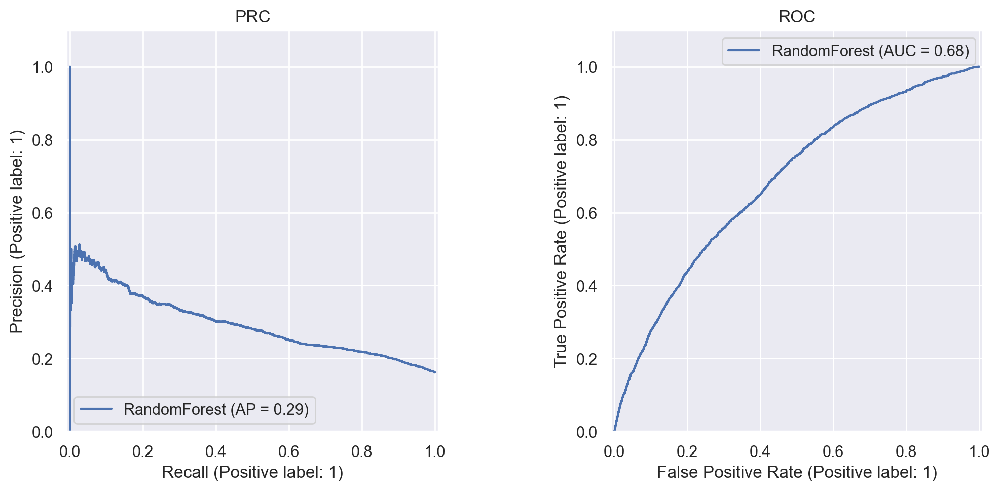

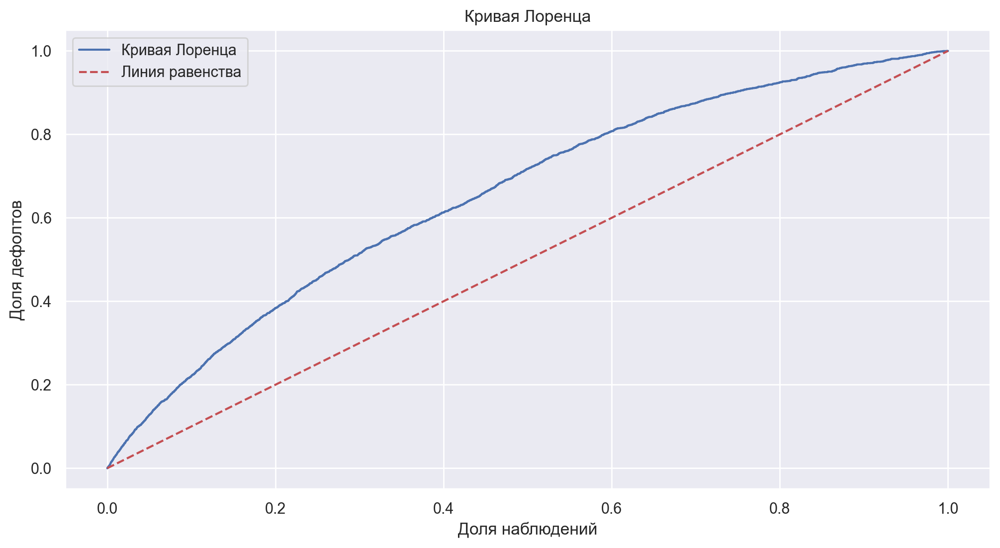

Gini-коэффициент - 0.3698


In [63]:
column_transformer = ColumnTransformer([
    ('mean_target', ce.TargetEncoder(cols=categorical), categorical),
    ('scaling', StandardScaler(), numeric)
], remainder="drop")

pipeline_rf = Pipeline([
    ('preprocessing', column_transformer),
    ('rf', RandomForestClassifier(
        **best_params_rf,
        random_state=42,
        n_jobs=-1
    ))
])

pipeline_rf.fit(x_train, y_train)
rf_pred = pipeline_rf.predict_proba(x_test)[:, 1]
auc_pr_rf = average_precision_score(y_test, rf_pred)
auc_roc_rf = roc_auc_score(y_test, rf_pred)
gini_rf = 2 * auc_roc_rf - 1

print('AUC-PR:', auc_pr_rf)
print('AUC-ROC:', auc_roc_rf)
depict_pr_roc(y_test, rf_pred, 'RandomForest')
plot_gini_curve(y_test, rf_pred)

metrics.loc['RandomForest'] = [
    auc_pr_rf,
    auc_roc_rf,
    gini_rf
]

К сожалению, случаный лес проигрывает бустингу. Однако качество все равно выше, чем у интерпретируемой модели. Посмотрим, что нам даст ядровый SVM.

#### 3. SVM с RBF-ядром

Обучим Support Vector Machine с гауссовым ядром. Апроксимация данного ядра позволит выделить нелинейные зависимости между признаками. Однако нас ждет долгий подбор гиперпараметров регуляризации и гамма ($\gamma$) - контроль относительного веса мономов больших степеней. Несмотря на апроксимацию, ядровый SVM все еще является весьма сложным алгоритмом. 

In [64]:
from sklearn.svm import SVC

column_transformer = ColumnTransformer([
    ('mean_target', ce.TargetEncoder(cols=categorical), categorical),
    ('scaling', StandardScaler(), numeric)
], remainder="drop")

def svm_objective(trial: Trial):
    C = trial.suggest_loguniform("C", 1e-3, 1e3)
    gamma = trial.suggest_loguniform("gamma", 1e-4, 1e-1)

    pipeline_svm = Pipeline([
        ('preprocessing', column_transformer),
        ('svm', SVC(
            kernel="rbf",
            C=C,
            gamma=gamma,
            probability=True,
            random_state=42
        ))
    ])

    pipeline_svm.fit(x_train, y_train)
    y_pred_proba = pipeline_svm.predict_proba(x_valid)[:, 1]
    auc_pr = roc_auc_score(y_valid, y_pred_proba)
    return auc_pr

In [118]:
sampler_svm = TPESampler(seed=42)
study_svm = optuna.create_study(direction='maximize', sampler=sampler_svm)
study_svm.optimize(svm_objective, n_trials=50)

print("Лучшие параметры:", study_svm.best_params)
print("Лучший AUC-PR:", study_svm.best_value)

[I 2025-06-02 23:18:31,020] A new study created in memory with name: no-name-294e885c-62e7-4058-aa64-a784f312b4ba
[I 2025-06-02 23:19:35,755] Trial 0 finished with value: 0.5557880413409052 and parameters: {'C': 0.1767016940294795, 'gamma': 0.07114476009343425}. Best is trial 0 with value: 0.5557880413409052.
[I 2025-06-02 23:21:42,891] Trial 1 finished with value: 0.5319764350548224 and parameters: {'C': 24.658329458549105, 'gamma': 0.006251373574521752}. Best is trial 0 with value: 0.5557880413409052.
[I 2025-06-02 23:22:12,190] Trial 2 finished with value: 0.45399754597366637 and parameters: {'C': 0.008632008168602538, 'gamma': 0.00029375384576328325}. Best is trial 0 with value: 0.5557880413409052.
[I 2025-06-02 23:22:43,578] Trial 3 finished with value: 0.5408456952288064 and parameters: {'C': 0.002231010801867922, 'gamma': 0.0396760507705299}. Best is trial 0 with value: 0.5557880413409052.
[I 2025-06-02 23:24:03,611] Trial 4 finished with value: 0.5236564992370495 and parameters

Лучшие параметры: {'C': 944.5807480766156, 'gamma': 0.00032979312261641197}
Лучший AUC-PR: 0.6847367427519703


Четыре часа пролетели быстро :)

In [65]:
best_params_svm = {'C': 944.5807480766156, 'gamma': 0.00032979312261641197}

AUC-PR: 0.2904159932391803
AUC-ROC: 0.6760289756966511


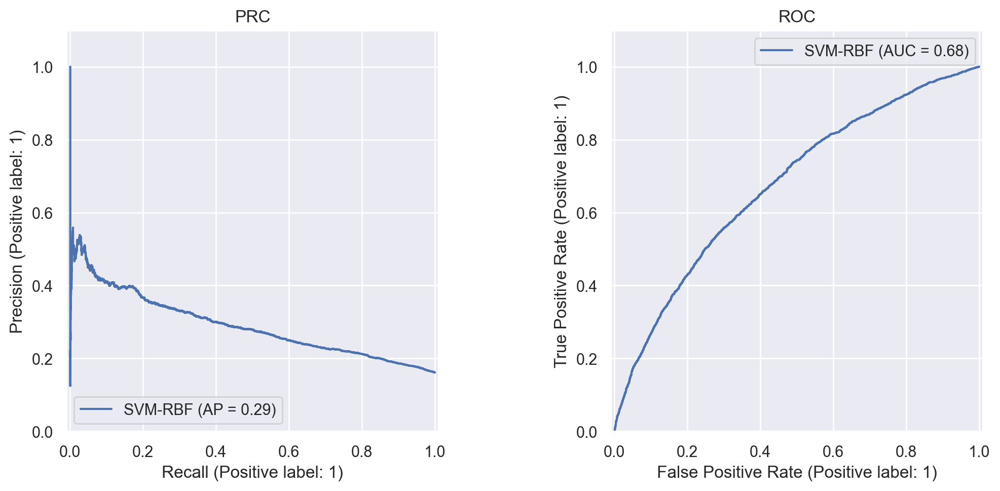

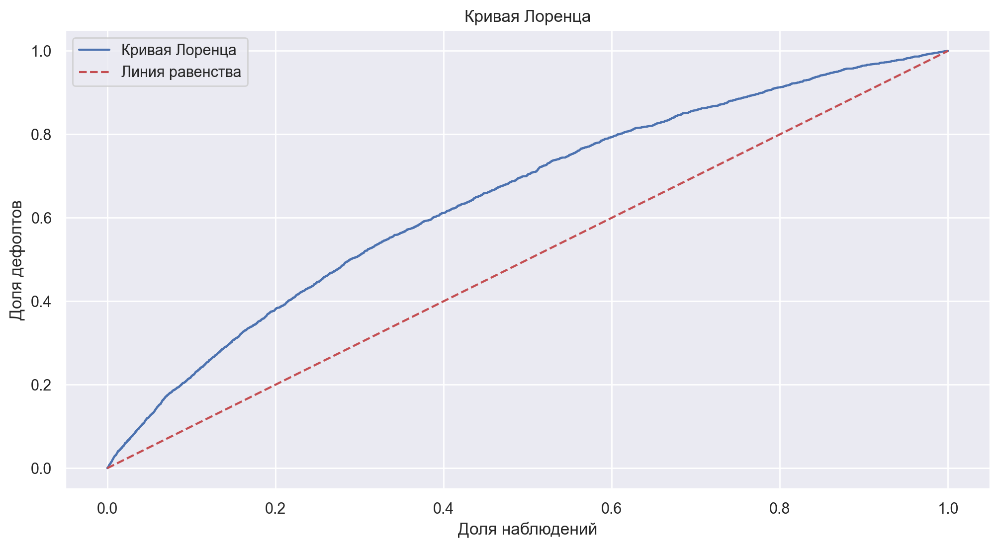

Gini-коэффициент - 0.3521


In [66]:
column_transformer = ColumnTransformer([
    ('mean_target', ce.TargetEncoder(cols=categorical), categorical),
    ('scaling', StandardScaler(), numeric)
], remainder="drop")

pipeline_svm = Pipeline([
    ('preprocessing', column_transformer),
    ('svm', SVC(
        kernel='rbf',
        C=best_params_svm['C'],
        gamma=best_params_svm['gamma'],
        probability=True,
        random_state=42
    ))
])

pipeline_svm.fit(x_train, y_train)
svm_pred = pipeline_svm.predict_proba(x_test)[:, 1]
auc_pr_svm = average_precision_score(y_test, svm_pred)
auc_roc_svm = roc_auc_score(y_test, svm_pred)
gini_svm = 2 * auc_roc_svm - 1

print('AUC-PR:', auc_pr_svm)
print('AUC-ROC:', auc_roc_svm)
depict_pr_roc(y_test, svm_pred, 'SVM-RBF')
plot_gini_curve(y_test, svm_pred)

metrics.loc['SVM-RBF'] = [
    auc_pr_svm,
    auc_roc_svm,
    gini_svm
]

К сожалению, SVM с RBF-ядром показал наихудший результат. Качество ниже, чем у интерпретируемой модели. Когда-то ядровый SVM считался передовой технологией в области классификации, однако сейчас бустинг и случайный лес используются гораздо более активно и дают большие значения метрик.

Мы подобрали гиперпараметры по всем трем моделям и оценили качество каждой из них по трем метрикам: AUC-PR, AUC-ROC, Gini. Посмотрим на их значения для каждой модели.

In [71]:
metrics

,auc_pr,roc_auc_score,gini
CatBoost,0.29566344764244484,0.6882684458107289,0.37653689162145776
RandomForest,0.2942942615025191,0.684885898622601,0.3697717972452019
SVM-RBF,0.2904159932391803,0.6760289756966511,0.3520579513933022


По всем трем метрикам выигрывает CatBoost. Оставим данную модель в качестве основной и провалидируем ее.

#### 4. Валидация.

Настало время провести валидацию неинтерпретируемой модели. Тесты те же. Посмотрим на результат.

##### 4.1 Тест M2.1

Проверим эффективность ранжирования всей модели.

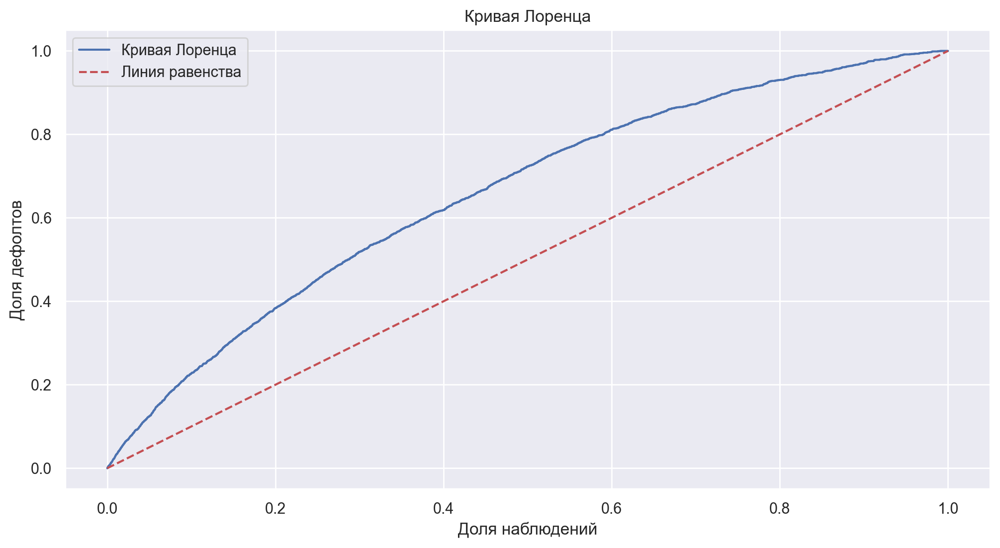

Gini-коэффициент - 0.3765


In [67]:
plot_gini_curve(y_test, cat_pred)

Тест M2.1 пройден

##### 4.2 Тест M2.2

Проверим эффективность ранжирования отдельных факторов.

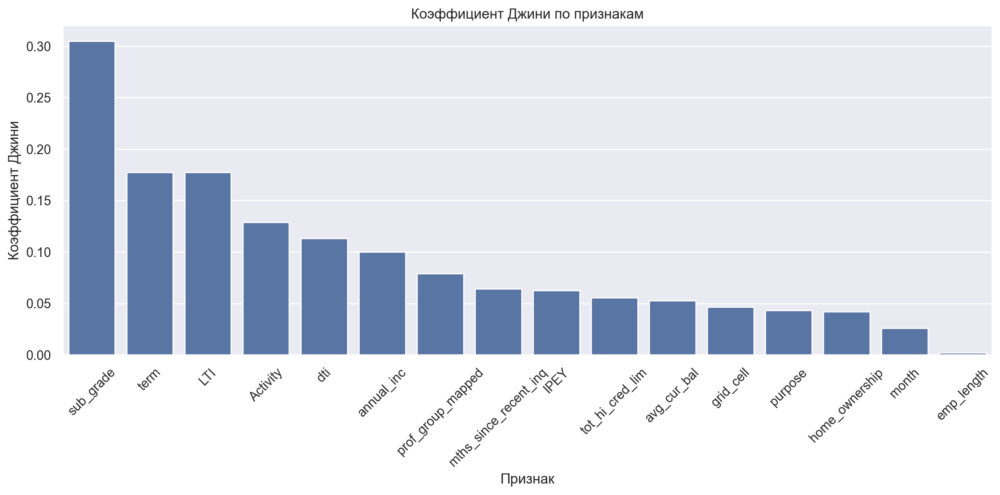

In [68]:
x_train_transformed = column_transformer.fit_transform(x_train, y_train)

x_train_transformed = pd.DataFrame(
    x_train_transformed,
    index=x_train.index,
    columns=categorical + numeric
)

x_test_transformed = column_transformer.fit_transform(x_test, y_test)

x_test_transformed = pd.DataFrame(
    x_test_transformed,
    index=x_test.index,
    columns=categorical + numeric
)

gini_per_feature = calculate_gini_per_feature(x_train_transformed, y_train)

30% признаков находятся в желтой зоне, тест пройден на желтом уровне.

##### 4.3 Тест M2.5

Анализ вкладов факторов в формирование Джини модели.

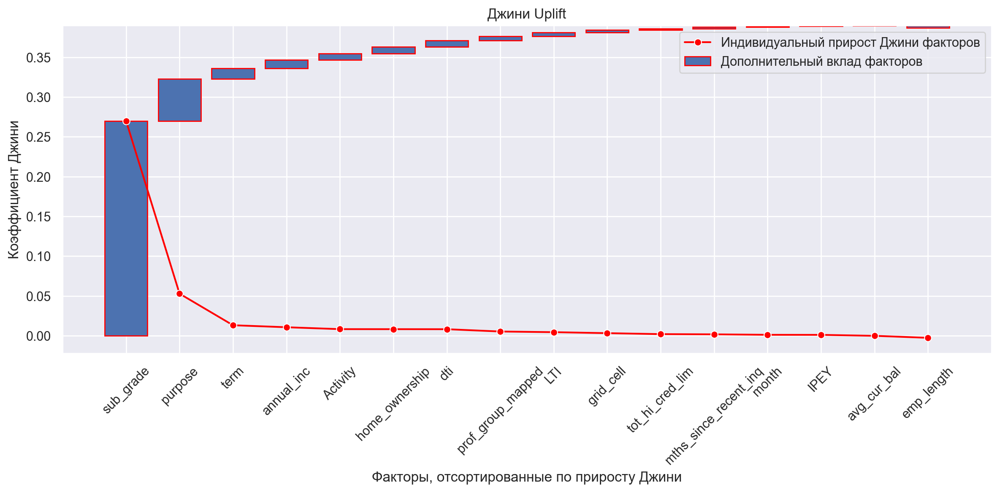

In [69]:
tmp = best_params_cat.copy()
tmp['loss_function'] = 'Logloss'
tmp['eval_metric'] = 'AUC'
tmp['random_seed'] = 42
tmp['verbose'] = False
tmp['early_stopping_rounds'] = 40
plot_incremental_gini(x_train_transformed, y_train, x_test_transformed, y_test, tmp, CatBoostClassifier)

Наибольший вклад в качество модель вносит признак sub\_grade. Далее по убыванию признаки purpose, term, annual\_inc, Activity, home\_ownership, dti, prof\_group, LTI, grid\_cell, оставшиеся признаки практически не увеличивают общий коэффициент Джини модели.

##### 4.4 Тест M2.4

Динамика коэффициента Джини.

In [70]:
x_test_date = x_test.copy()
x_test_date['y'] = y_test

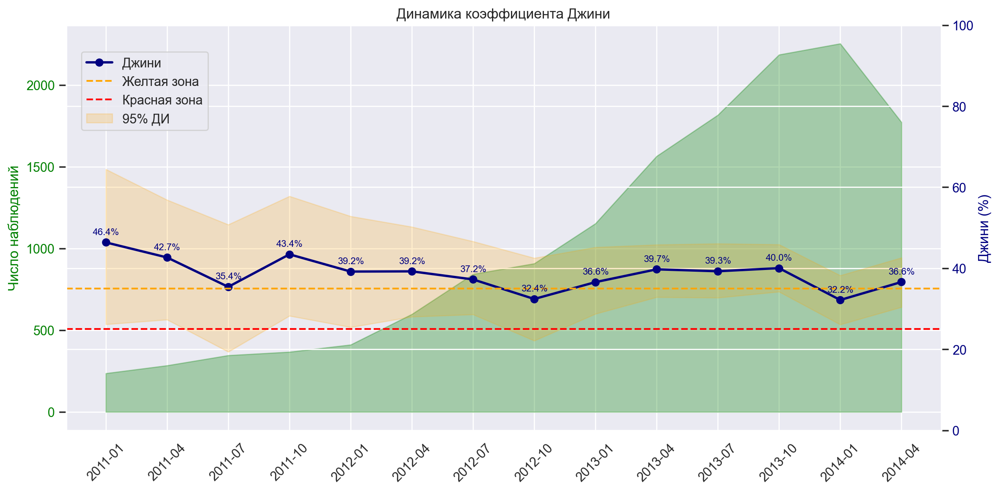

In [71]:
plot_gini_dynamics(data_test=x_test_date, model=pipeline_cat, features=numeric + categorical)

Локальные минимумы Джини по кварталам стали выше. Коэффициент более стабилен во времени.

##### 4.5 Тест М3.1

Тест не проводится, так как WOE-преобразования не были использованы при обучении модели.

##### 4.6 Тест M4.1

Сравнение прогнозного и фактического TR (Target Rate) на уровне выборки.

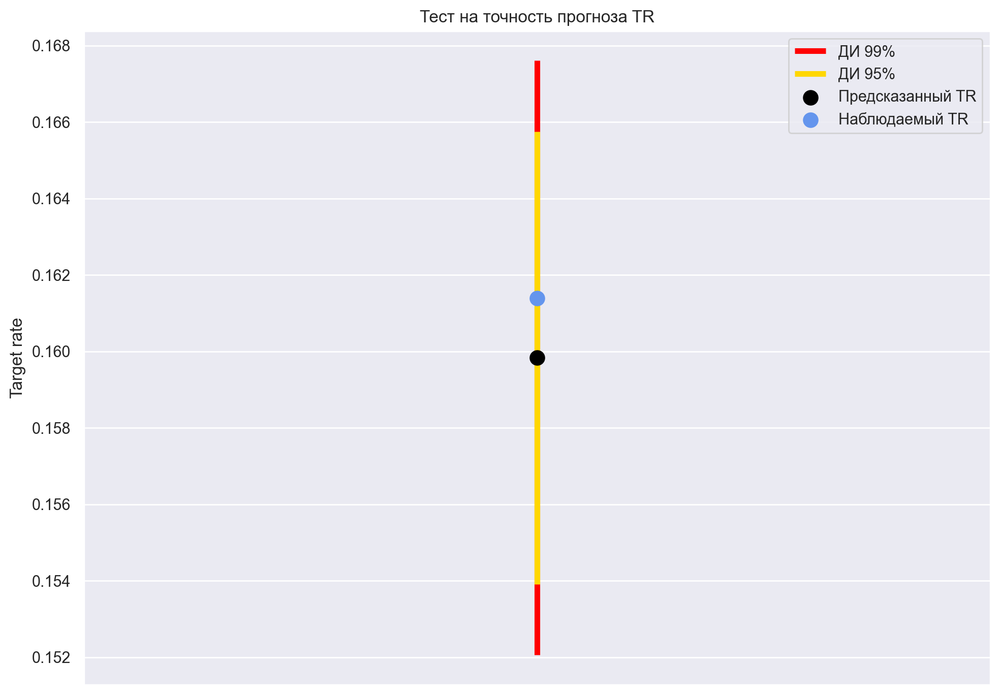

Результат теста: 0.9634 %


In [72]:
x_test_TR = x_test.copy()
x_test_TR['y_pred'] = cat_pred
x_test_TR['y'] = y_test
m4_result = plot_pd_vs_tr_with_ci(x_test_TR)
print("Результат теста:", m4_result.round(4), "%")

В нашей модели:  
$$
  \frac{\lvert TR_{\mathrm{fact}} - TR_{\mathrm{pred}}\rvert}{TR_{\mathrm{fact}}} = 0.9634\%
$$

Тест пройден.

##### 4.7 Тест M4.2

Тест формы калибровочной кривой.

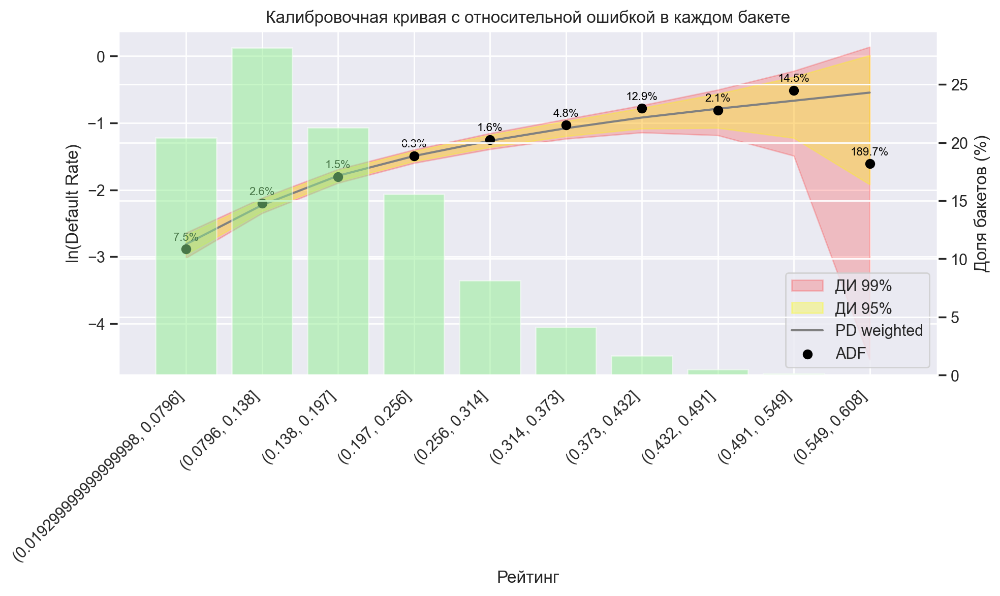

In [73]:
x_test_TR['score'] = pd.cut(
    x_test_TR['y_pred'],
    bins=10,
    include_lowest=True
)

plot_bucket_level_ci(x_test_TR)

В нашей модели есть только один бакет с

$$\frac{abs\left(TRfact-TRpred\right)}{TRfact} > 20\%$$

Тест пройден.

##### 4.8 Тест M5.1

Сравнение эффективности ранжирования модели на разработке и валидации.

In [74]:
cat_pred_train = pipeline_cat.predict_proba(x_train)[:, 1]
x_train_TR = x_train.copy()
x_train_TR['y_pred'] = cat_pred_train
x_train_TR['y'] = y_train

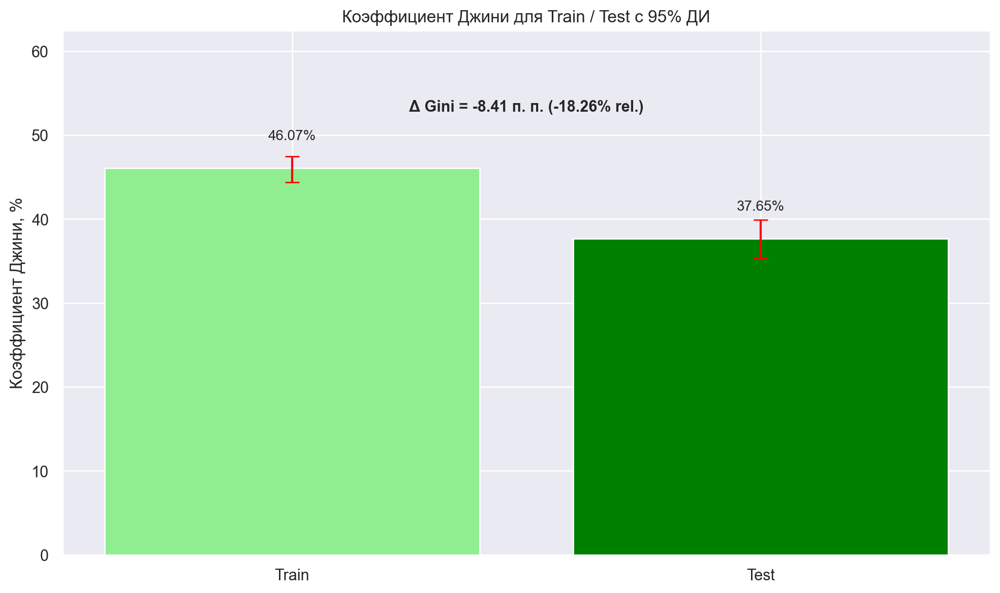

In [75]:
plot_gini_comparison(x_train_TR['y'].values, x_train_TR['y_pred'].values, x_test_TR['y'].values, x_test_TR['y_pred'].values)

Абсолютное снижение = 8.41 п.\,п. (рис. 26), относительное = 18.26\% $\Rightarrow$ Тест пройден на желтом уровне.

##### 4.9 Тест M5.2

Сравнение эффективности ранжирования отдельных факторов модели на разработке и валидации.

In [76]:
x_train_transformed['y'] = y_train
x_test_transformed['y'] = y_test

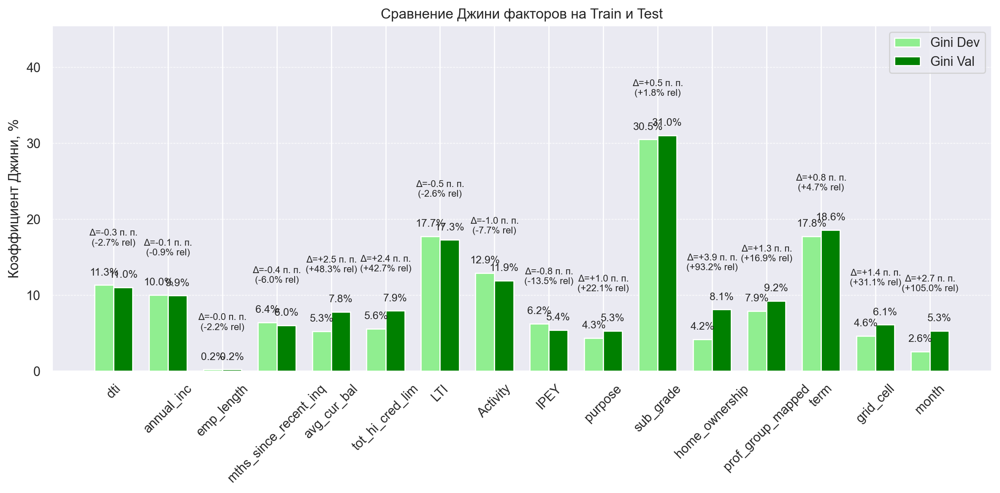

In [77]:
plot_feature_gini_diff(
    y_dev=x_train_transformed['y'].values,
    X_dev=x_train_transformed,
    y_val=x_test_transformed['y'].values,
    X_val=x_test_transformed,
    features=numeric + categorical
)

Нет факторов с абсолютным снижением более 3 п. п. и относительным более 15\% $\Rightarrow$ тест пройден.

### VI. Сравнение интерпретируемой и неинтерпретируемой моделей. 

#### 1. Качество.

Catboost с преобразованием данных с помощью MeanTargetEncoder и StandartScaler предлагает значимый прирост в качестве в сравнении с логистической регрессией, обученной на WOE-преобразованиях признаков. Прирост в коэффициенте Джини составляет $\approx$ 2.75%. Бустинг учел нелинейные связи признаков, упускаемые логистической регрессией. 

Однако важно учесть, что финальный список признаков неинтерпретируемой модели шире, хотя независимые переменные, дающие наибольший прирост в качестве, те же.

##### 2. Важность признаков.

Признаки, дающие наибольший прирост в Джини для интерпретируемой модели, по убыванию: sub\_grade, term, LTI, annual\_inc, Activity, prof\_group, dti.

Признаки, дающие наибольший прирост в Джини для неинтерпретируемой модели, по убыванию: sub\_grade, purpose, term, annual\_inc, Activity, home\_ownership, dti, prof\_group, LTI, grid\_cell.

Неинтерпретируемая модель смогла извлечь больше информации из категориальных переменных: purpose, home\_ownership. WOE-преобразование упрощает переменные, выбросы и нелинейные зависимости затираются. Точечные сигналы размываются по группам. При MeanTarget энкодинге категории с относительно небольшим количеством наблюдений сохраняют истинную информацию, хоть и немного зашумленную.

##### 3. Динамика коэффициента Джини.

Локальные минимумы Джини по кварталам стали выше у неинтерпретируемой модели. Коэффициент стал более стабилен во времени. Однако все еще наблюдаются скачки и снижение Джини до "желтого" уровня - $\text{Gini} \leq 0.35$ - для двух кварталов.

##### 4. Приближение вероятностей.

Неинтерпретируемая модель хуже откалибрована. Особенно это видно на последнем бакете:

$$\frac{abs\left(TRfact-TRpred\right)}{TRfact} \approx 189 \%$$

в то время, как у логистической регрессии наибольшее относительное различие на последнем бакете составляет:

$$\frac{abs\left(TRfact-TRpred\right)}{TRfact} \approx 25 \%$$

Логистическая регрессия по определению приближает вероятности, а у бустинга такой задачи нет. Однако неинтерпретируемую модель можно откалибровать с помощью $\text{sigmoid}$ или $\text{isotonic}$ калибровки, если приближение важно.

##### 5. Эффективность ранжирования модели на разработке и валидации.

Абсолютное снижение коэффициента Джини на Test выборке неинтерпретируемой модели - 8.41 п. п., относительное - 18.26%

Абсолютное снижение коэффициента Джини на Test выборке интерпретируемой модели - 0.64 п. п., относительное - 1.72%

Бустинг сильнее переобучается. Он способен уловить множество фигурных зависимостей, но так же склонен к запоминанию шума обучающей выборки, что приведет к снижению метрик качества на новых данных. Логистическая регрессия ограничена линейными зависимостями, ввиду чего не может позволить себе столь глубокого запоминания.

### VII. Расчёт ожидаемой прибыли от кредитования.

#### 1. LGD = 100%.

##### 1.1 Теоретический порог безубыточности.

Рассчитаем теоретический порог безубыточности. У нас есть модель, которая для каждого клиента предсказывает вероятность дефолта $p_i$. При этом, $LGD = 100\%$ - если клиент не исполняет свои обязательства, банк теряет весь кредит $F_i$, а годовая ставка для каждого клиента $r = 0.13$. В нашем датасете срок кредита $T_i$ составляет 3 или 5 лет.

Исходя из допущений, описанных выше, ожидаемая прибыль рассчитывается как:

$$\pi_{e_i} = (1 - p_i) * (F_i \cdot r \cdot T_i) - p_i \cdot F_i $$
$$\pi_{e_i} = F_i\bigg(rT_i - p_i(rT_i + 1)\bigg )$$

Чтобы $\pi_{e_i} \geq 0$ ожидаемая прибыль была не отрицательной, нужно:

$$rT_i - p_i(rT_i + 1) \geq 0 \Rightarrow p_i \leq \frac{rT_i}{rT_i + 1}$$

Таким образом, теоретический порог безубыточности равен:

$$p_i = \frac{0.13T_i}{0.13T_i + 1}$$

1. Если $T_i = 3$, то:

$$p_i = \frac{0.13 \cdot 3}{0.13 \cdot 3 + 1} = \frac{0.39}{1.39} \approx 0.28$$

2. Если $T_i = 5$, то:

$$p_i = \frac{0.13 \cdot 5}{0.13 \cdot 5 + 1} = \frac{0.65}{1.65} \approx 0.39$$

Таким образом, одобрять клиента в долгосрочном периоде выгодно при $\hat {PD_i} < p^*_i$

##### 1.2 Эмпирическая оптимизация порога.

Таким образом, суммарная ожидаемая прибыль при пороге $t$ равна:

$$\pi_e(t) = \sum_{i: p_i < t} F_i\bigg(0.13T_i - p_i(0.13T_i + 1)\bigg )$$

Будем перебирать порог $t \in [0, 1]$ с шагом 0.05 на валидационной выборке. Оптимальный порог:

$$t^* = \text{arg max}_{t_j} \pi_e(t_j)$$

In [121]:
x = pd.read_csv('nan_unique_outliers_depend.csv')
x_valid['funded_amnt'] = x['funded_amnt']

In [122]:
x_valid['pd'] = pipeline_cat.predict_proba(x_valid)[:, 1]
x_valid['exp_profit'] = x_valid['funded_amnt'] * (0.13 * (x_valid['term'] // 12) - x_valid['pd']
                                                   * (0.13 * (x_valid['term'] // 12) + 1))

In [123]:
thresholds = np.linspace(0.0, 1.0, 201)
exp_profits = []
for t in thresholds:
    accepted = x_valid[x_valid['pd'] < t]
    exp_profits.append(accepted['exp_profit'].sum())

In [124]:
exp_profits = np.array(exp_profits)
t_opt = thresholds[np.argmax(exp_profits)]
max_profit = exp_profits[np.argmax(exp_profits)]

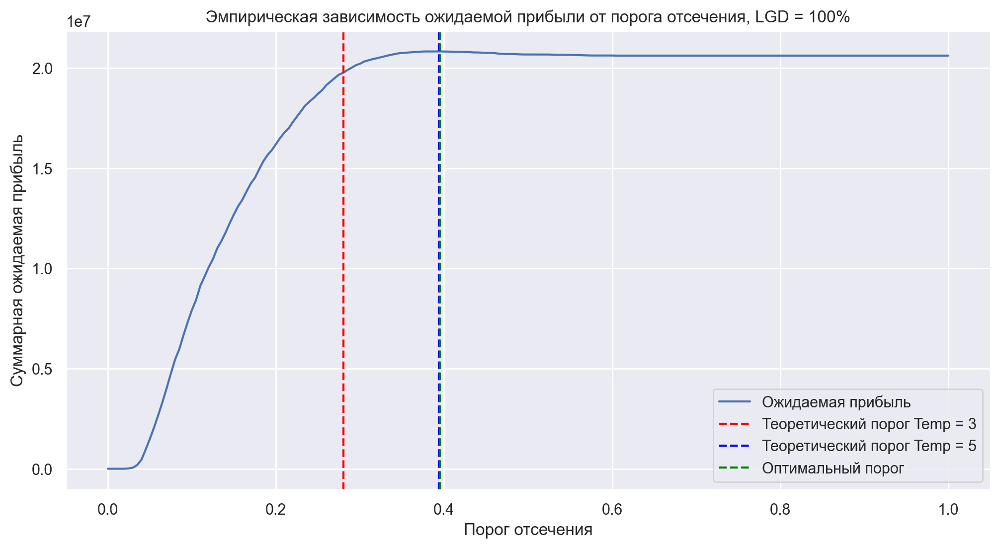

In [125]:
plt.plot(thresholds, exp_profits, label='Ожидаемая прибыль')
plt.axvline(0.39/1.39, color='red', linestyle='--', label='Теоретический порог Temp = 3')
plt.axvline(0.65/1.65, color='blue', linestyle='--', label='Теоретический порог Temp = 5')
plt.axvline(t_opt, color='green', linestyle='--', label='Оптимальный порог')
plt.xlabel('Порог отсечения')
plt.ylabel('Суммарная ожидаемая прибыль')
plt.title('Эмпирическая зависимость ожидаемой прибыли от порога отсечения, LGD = 100%')
plt.legend()
plt.show()

Теоретический и эмпирический порог согласуются. Хотя основная масса кредитов представлена трехлетними займами, прибыль от пятилетних выше, поэтому порог сдвинут к $T = 5$.

Рассчитаем ожидаемую прибыль на Test выборке при выбранном пороге отсечения:

$$\pi_e(t^*) = \sum_{i: p_i < t^*} F_i\bigg(0.13T_i - p_i(0.13T_i + 1)\bigg )$$

In [126]:
x_test['funded_amnt'] = x['funded_amnt']
x_test['pd'] = pipeline_cat.predict_proba(x_test)[:, 1]
x_test['exp_profit'] = x_test['funded_amnt'] * (0.13 * (x_test['term'] // 12) - x_test['pd']
                                                   * (0.13 * (x_test['term'] // 12) + 1))
accepted = x_test[x_test['pd'] < t_opt]
test_profit = accepted['exp_profit'].sum()
print("Ожидаемая прибыль на тестовой выборке при выбранном пороге t =", t_opt, ":", round(test_profit, 2), "$")

Ожидаемая прибыль на тестовой выборке при выбранном пороге t = 0.395 : 45377168.42 $


##### 1.3 Фактическая прибыль. 

Проверим порог на исторических данных с реальными дефолтами и посчитаем фактическую прибыль.

1. Если кредит выплачен $y = 0$, то прибыль:

$$\pi_i = F_i \cdot r \cdot T_i$$

2. Если клиент не выполнил свои обязательства $y = 1$, то прибыль:

$$\pi_i = -F_i$$

Таким образом, суммарная фактическая прибыль при пороге $t$ равна:

$$\pi(t) = \sum_{i: p_i < t} \bigg[(1 - y_i) \cdot F_i r T_i - y_i F_i\bigg]$$

Будем перебирать порог $t \in [0, 1]$ с шагом 0.05 на валидационной выборке. Оптимальный порог:

$$t^* = \text{arg max}_{t_j} \pi(t_j)$$

In [127]:
x_valid['y'] = y_valid
thresholds = np.linspace(0, 1, 201)
real_profit = []
for t in thresholds:
    accepted = x_valid[x_valid['pd'] < t]
    accepted['real_profit'] = np.where(accepted['y'] == 0, 
                                       accepted['funded_amnt'] * 0.13 * (accepted['term'] // 12),
                                       -accepted['funded_amnt'])
    real_profit.append(accepted['real_profit'].sum())

In [128]:
real_profit = np.array(real_profit)
t_real_opt = thresholds[np.argmax(real_profit)]
max_real_profit = real_profit[np.argmax(real_profit)]

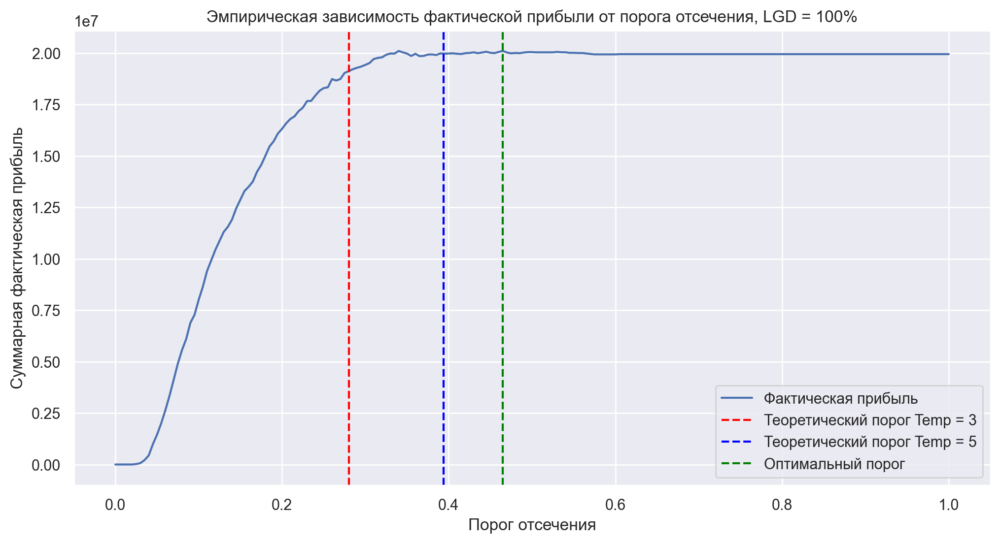

In [129]:
plt.plot(thresholds, real_profit, label='Фактическая прибыль')
plt.axvline(0.39/1.39, color='red', linestyle='--', label='Теоретический порог Temp = 3')
plt.axvline(0.65/1.65, color='blue', linestyle='--', label='Теоретический порог Temp = 5')
plt.axvline(t_real_opt, color='green', linestyle='--', label='Оптимальный порог')
plt.xlabel('Порог отсечения')
plt.ylabel('Суммарная фактическая прибыль')
plt.title('Эмпирическая зависимость фактической прибыли от порога отсечения, LGD = 100%')
plt.legend()
plt.show()

Реальные риски оказались ниже теоретических. На практике отбираем клиентов мягче, чем это предполагает теория.

Рассчитаем фактическую прибыль на Test выборке при выбранном пороге отсечения:

$$\pi(t^*) = \sum_{i: p_i < t^*} \bigg[(1 - y_i) \cdot F_i r T_i - y_i F_i\bigg]$$

In [130]:
x_test['y'] = y_test
accepted = x_test[x_test['pd'] < t_real_opt]
accepted['real_profit'] = np.where(accepted['y'] == 0, 
                                    accepted['funded_amnt'] * 0.13 * (accepted['term'] // 12),
                                    -accepted['funded_amnt'])
test_real_profit = accepted['real_profit'].sum()
print("Фактическая прибыль на тестовой выборке при выбранном пороге t =", t_real_opt, ":", round(test_real_profit, 2), "$")

Фактическая прибыль на тестовой выборке при выбранном пороге t = 0.465 : 44277073.0 $


#### 2. LGD = 80%.

##### 2.1 Теоретический порог безубыточности.

Рассчитаем теоретический порог безубыточности при $LGD = 80\%$ - если клиент не исполняет свои обязательства, банк теряет 80% кредита. Остальные предпосылки те же.

Ожидаемая прибыль рассчитывается как:

$$\pi_{e_i} = (1 - p_i) \cdot (F_i \cdot r \cdot T_i) - 0.8 \cdot p_i \cdot F_i $$
$$\pi_{e_i} = F_i\bigg(rT_i - p_i(rT_i + 0.8)\bigg )$$

Чтобы $\pi_{e_i} \geq 0$ ожидаемая прибыль была не отрицательной, нужно:

$$rT_i - p_i(rT_i + 0.8) \geq 0 \Rightarrow p_i \leq \frac{rT_i}{rT_i + 0.8}$$

Таким образом, теоретический порог безубыточности равен:

$$p_i = \frac{0.13T_i}{0.13T_i + 0.8}$$

1. Если $T_i = 3$, то:

$$p_i = \frac{0.13 \cdot 3}{0.13 \cdot 3 + 0.8} = \frac{0.39}{1.19} \approx 0.33$$

2. Если $T_i = 5$, то:

$$p_i = \frac{0.13 \cdot 5}{0.13 \cdot 5 + 0.8} = \frac{0.65}{1.45} \approx 0.45$$

Таким образом, одобрять клиента в долгосрочном периоде выгодно при $\hat {PD_i} < p^*_i$

##### 2.2 Эмпирическая оптимизация порога.

Таким образом, суммарная ожидаемая прибыль при пороге $t$ равна:

$$\pi_e(t) = \sum_{i: p_i < t} F_i\bigg(0.13T_i - p_i(0.13T_i + 0.8)\bigg )$$

Будем перебирать порог $t \in [0, 1]$ с шагом 0.05 на валидационной выборке. Оптимальный порог:

$$t^* = \text{arg max}_{t_j} \pi_e(t_j)$$

In [131]:
x_valid['pd'] = pipeline_cat.predict_proba(x_valid)[:, 1]
x_valid['exp_profit'] = x_valid['funded_amnt'] * (0.13 * (x_valid['term'] // 12) - x_valid['pd']
                                                   * (0.13 * (x_valid['term'] // 12) + 0.8))

In [132]:
thresholds = np.linspace(0.0, 1.0, 201)
exp_profits = []
for t in thresholds:
    accepted = x_valid[x_valid['pd'] < t]
    exp_profits.append(accepted['exp_profit'].sum())

In [133]:
exp_profits = np.array(exp_profits)
t_opt = thresholds[np.argmax(exp_profits)]
max_profit = exp_profits[np.argmax(exp_profits)]

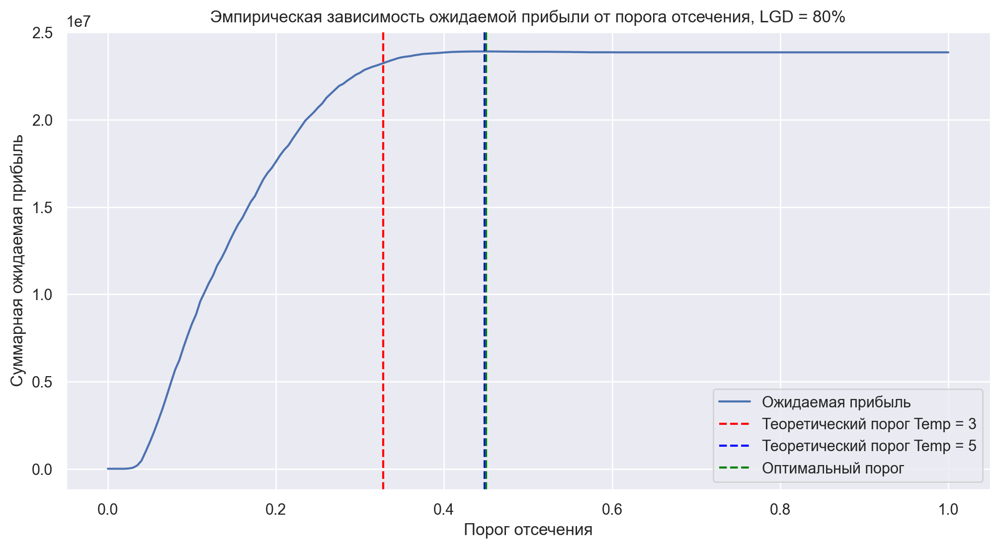

In [134]:
plt.plot(thresholds, exp_profits, label='Ожидаемая прибыль')
plt.axvline(0.39/1.19, color='red', linestyle='--', label='Теоретический порог Temp = 3')
plt.axvline(0.65/1.45, color='blue', linestyle='--', label='Теоретический порог Temp = 5')
plt.axvline(t_opt, color='green', linestyle='--', label='Оптимальный порог')
plt.xlabel('Порог отсечения')
plt.ylabel('Суммарная ожидаемая прибыль')
plt.title('Эмпирическая зависимость ожидаемой прибыли от порога отсечения, LGD = 80%')
plt.legend()
plt.show()

Рассчитаем ожидаемую прибыль на Test выборке при выбранном пороге отсечения:

$$\pi_e(t^*) = \sum_{i: p_i < t^*} F_i\bigg(0.13T_i - p_i(0.13T_i + 0.8)\bigg )$$

In [135]:
x_test['funded_amnt'] = x['funded_amnt']
x_test['pd'] = pipeline_cat.predict_proba(x_test)[:, 1]
x_test['exp_profit'] = x_test['funded_amnt'] * (0.13 * (x_test['term'] // 12) - x_test['pd']
                                                   * (0.13 * (x_test['term'] // 12) + 0.8))
accepted = x_test[x_test['pd'] < t_opt]
test_profit = accepted['exp_profit'].sum()
print("Фактическая прибыль на тестовой выборке при выбранном пороге t =", t_opt, ":", round(test_profit, 2), "$")

Фактическая прибыль на тестовой выборке при выбранном пороге t = 0.45 : 52033888.14 $


##### 2.3 Фактическая прибыль. 

Проверим порог на исторических данных с реальными дефолтами и посчитаем фактическую прибыль.

1. Если кредит выплачен $y = 0$, то прибыль:

$$\pi_i = F_i \cdot r \cdot T_i$$

2. Если клиент не выполнил свои обязательства $y = 1$, то прибыль:

$$\pi_i = -0.8F_i$$

Таким образом, суммарная фактическая прибыль при пороге $t$ равна:

$$\pi(t) = \sum_{i: p_i < t} \bigg[(1 - y_i) \cdot F_i r T_i - 0.8y_i F_i\bigg]$$

Будем перебирать порог $t \in [0, 1]$ с шагом 0.05 на валидационной выборке. Оптимальный порог:

$$t^* = \text{arg max}_{t_j} \pi(t_j)$$

In [136]:
x_valid['y'] = y_valid
thresholds = np.linspace(0, 1, 201)
real_profit = []
for t in thresholds:
    accepted = x_valid[x_valid['pd'] < t]
    accepted['real_profit'] = np.where(accepted['y'] == 0, 
                                       accepted['funded_amnt'] * 0.13 * (accepted['term'] // 12),
                                       -0.8 * accepted['funded_amnt'])
    real_profit.append(accepted['real_profit'].sum())

In [137]:
real_profit = np.array(real_profit)
t_real_opt = thresholds[np.argmax(real_profit)]
max_real_profit = real_profit[np.argmax(real_profit)]

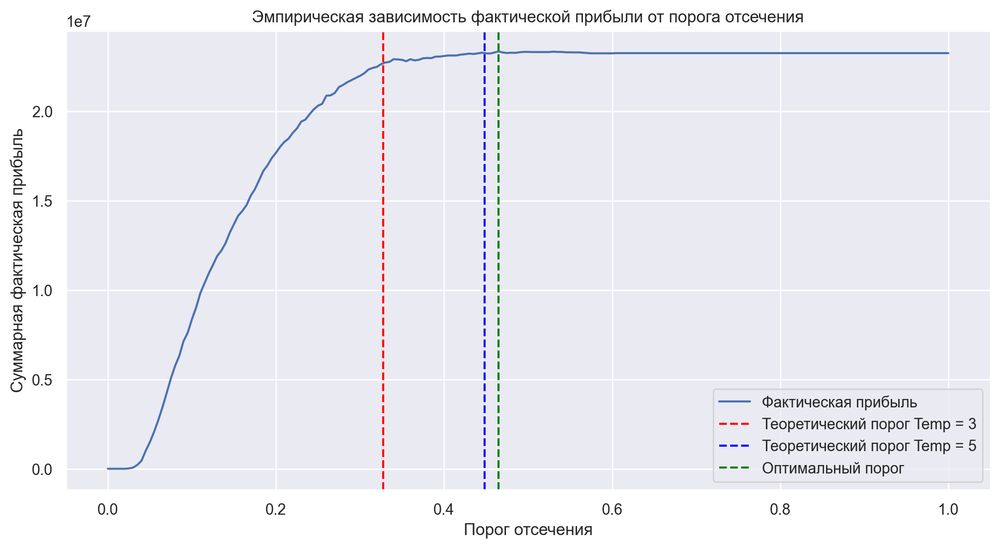

In [138]:
plt.plot(thresholds, real_profit, label='Фактическая прибыль')
plt.axvline(0.39/1.19, color='red', linestyle='--', label='Теоретический порог Temp = 3')
plt.axvline(0.65/1.45, color='blue', linestyle='--', label='Теоретический порог Temp = 5')
plt.axvline(t_real_opt, color='green', linestyle='--', label='Оптимальный порог')
plt.xlabel('Порог отсечения')
plt.ylabel('Суммарная фактическая прибыль')
plt.title('Эмпирическая зависимость фактической прибыли от порога отсечения')
plt.legend()
plt.show()

Рассчитаем фактическую прибыль на Test выборке при выбранном пороге отсечения:

$$\pi(t^*) = \sum_{i: p_i < t^*} \bigg[(1 - y_i) \cdot F_i r T_i - 0.8y_i F_i\bigg]$$

In [139]:
x_test['y'] = y_test
accepted = x_test[x_test['pd'] < t_real_opt]
accepted['real_profit'] = np.where(accepted['y'] == 0, 
                                    accepted['funded_amnt'] * 0.13 * (accepted['term'] // 12),
                                    -0.8 * accepted['funded_amnt'])
test_real_profit = accepted['real_profit'].sum()
print("Фактическая прибыль на тестовой выборке при выбранном пороге t =", t_real_opt, ":", round(test_real_profit, 2), "$")

Фактическая прибыль на тестовой выборке при выбранном пороге t = 0.465 : 51215868.0 $


### VIII. Заключение.

В процессе разработки модели кредитного скоринга физических лиц удалось глубоко погрузиться в данные и построить интерпретируемую и неинтерпретируемую модели предсказания вероятности дефолта клиента.

В рамках предварительного анализа данных мы обработали пропуски в соответствии с их классом (MCAR, MAR, MNAR), преобразовали категориальные признаки с большим количеством уникальных значений с помощью кластеризации, больших языковых моделей и геокодирования, построили графики распределений признаков и исключили выбросы, выделили формы зависимости Default Rate от числовых и категориальных признаков.

Были построены новые независимые переменные, обладающие относительно высокими абсолютной корреляцией с целевой переменной и t-статистикой. С помощью VIF и анализа корреляционной матрицы попытались исключить мультиколлинеарность признакового пространства.

Перед обучением модели выборка была разделена случайным образом на Train и Test (out-of-sample). Распределение целевой переменной на обеих выборках вышло приблизительно одинаковым.

В процессе построения интерпретируемой модели был обучен трансформер с WOE-преобразованием на обучающей выборке и применен, в том числе к тестовой. Отобрали признаки с помощью IV (Information Value), исходя из WOE-преобразований. Далее была обучена логистическая регрессия на трансформированных данных и отобранных признаках с подбором гиперпараметра регуляризации. Мы провели валидацию модели по девяти основным тестам и добились отсутствия "красных" результатов. Составлена и проинтерпретирована скоринговая карта. 

В рамках построения неинтерпретируемой модели были обучены два ансамбля деревьев - Catboost, RandomForest -, а так же ядровый Support Vector Machine с RBF-ядром с подбором соответствующих гиперпараметров. Провалидировали лучшую модель (CatBoost).

Также мы провели сравнительный анализ интерпретируемой и неинтерпретируемой моделей по качеству, важности признаков, динамике коэффициента Джини, форме калибровочных кривых, эффективности ранжирования моделей на разработке и валидации. 

В рамках расчета ожидаемой прибыли от кредитования был найден теоретический порог безубыточности, проведена эмпирическая оптимизация порога, построен график эмпирической зависимости ожидаемой прибыли от порога отсечения, максимизирована фактическая прибыль и рассчитана на Test выборке для LGD = 100\% и LGD = 80\%.

Таким образом, использование машинного обучения в оценке вероятности неисполнения обязательств по кредитной заявки имеет множество преимуществ в сравнении с классическим ручным подходом. Во-первых, подходы МО позволяют вычленить реальные зависимости между признаками и таргетом на истоических данных и понять, как в действительности различные параметры клиента сказываются на вероятности дефолта. Во-вторых, исключается человеческий фактор, являющийся одной из причин некачественного кредитования. В-тертьих, итоговая скоринговая карта позволяет быстро и четко классифицировать клиентов, что повышает эффективность работы банков и увеличивает прибыль.